<a href="https://colab.research.google.com/github/NoyaCh/EmployeeAttrition/blob/main/Final_Project_with_interactions_HR_Analytics_Employee_Attrition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Gil Atsmoni, Noya Cohen

ID's: 316354166, 205811706

Mail Addresses: gilats96@gmail.com, noyac3@gmail.com

# Introduction

In this project we used an extansion of a database from kaggle.com called "IBM HR Analytics Employee Attrition & Performance". After we decided to use this dataset we found an extension of this data in Kaggle.com called "HR Employee Attrition Datasets", so in the end we used the extended data that has more variables and observations.

The official project URL:

https://www.kaggle.com/datasets/pavansubhasht/ibm-hr-analytics-attrition-dataset

The extended data with all the tables and the variables descriptions can be found in this URL:

https://www.kaggle.com/datasets/jash312/hr-employee-attrition-datasets/data

The data we used was taken from 4 tables found in the above link. The data we uploaded here under the name final_data is the merged data of all four tables. We created a flat file (final_data) using an SQL query so that all the variables of a single employee are in one row only.

### Installing relevant packages for the analysis

In [ ]:
!pip install sweetviz
!pip install pingouin
!pip install scikit_posthocs

### Importing the dataframe

In [ ]:
import pandas as pd

In [ ]:
url = "https://docs.google.com/spreadsheets/d/1zfMJJ3KvRIoLN6qWD-A8PlxaZ_RmWHAY/edit?usp=sharing"

df = pd.read_csv(url.replace('/edit?usp=sharing', '/export?format=csv'))
df.head()

,EmployeeID,JoiningYear,Age,BusinessTravel,DailyRate,DistanceFromHome,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,rating2018,rating2019,rating2020,rating2021,Department,JobLevel,JobRole,city,province,country
0,100000,2005,57,Travel_Rarely,164,22,Doctorate,1,217,3,...,7.5,6.0,NaN,NaN,Corporate Functions,L7,Vice President (VP) or Chief Officer,Boston,MA,US
1,100001,2006,52,Travel_Rarely,265,19,Doctorate,1,519,3,...,7.0,NaN,NaN,NaN,Corporate Functions,L6,Director,NewYork,NY,US
2,100002,2006,53,Travel_Rarely,607,2,Doctorate,1,1572,3,...,8.5,NaN,NaN,NaN,Corporate Functions,L6,Director,Ottawa,ON,Canada
3,100003,2006,54,Travel_Rarely,215,19,Diploma,1,309,3,...,8.0,6.5,NaN,NaN,Corporate Functions,L7,Vice President (VP) or Chief Officer,NewYork,NY,US
4,100004,2007,57,Travel_Rarely,285,2,Diploma,1,828,3,...,8.0,NaN,NaN,NaN,Marketing,L5,Director of Marketing,Calgary,AB,Canada


In [ ]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
EmployeeID,13423.0,106711.000000,3875.030667,100000.0,103355.5,106711.0,110066.5,113422.0
JoiningYear,13423.0,2018.825300,2.005345,2005.0,2018.0,2019.0,2020.0,2021.0
Age,13423.0,36.159949,8.126696,18.0,30.0,35.0,41.0,60.0
DailyRate,13423.0,803.998287,356.968483,102.0,514.5,800.0,1106.0,1499.0
DistanceFromHome,13423.0,8.881472,6.844715,1.0,3.0,7.0,13.0,29.0
EmployeeCount,13423.0,1.000000,0.000000,1.0,1.0,1.0,1.0,1.0
EmployeeNumber,13423.0,1022.222677,549.883093,1.0,554.0,1014.0,1493.0,2068.0
EnvironmentSatisfaction,13423.0,2.369366,0.941861,1.0,2.0,2.0,3.0,4.0
HourlyRate,13423.0,65.498622,17.196420,30.0,52.0,65.0,79.0,100.0
JobInvolvement,13423.0,2.463160,0.660390,1.0,2.0,3.0,3.0,4.0


# EDA and Data Cleansing

### Using SweetViz to make an initial EDA

In [ ]:
import sweetviz as sv

                                             |          | [  0%]   00:00 -> (? left)


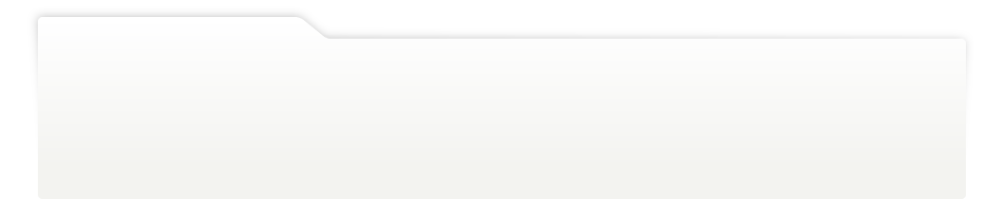
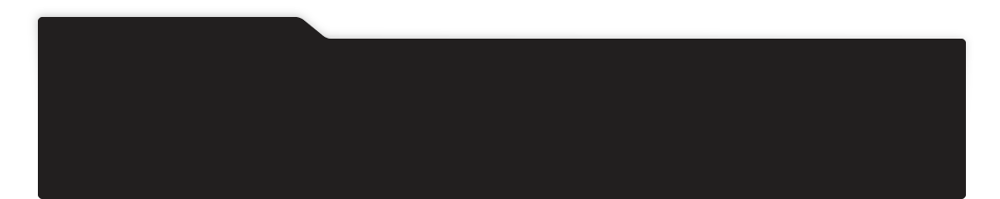
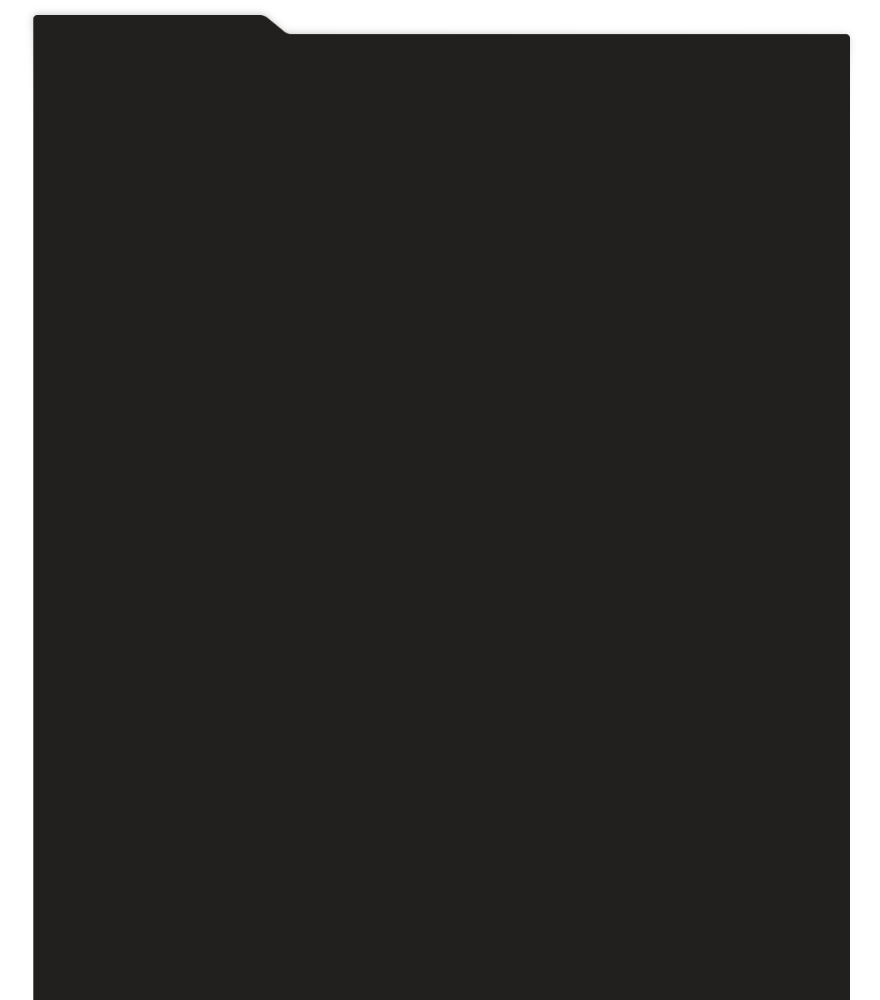
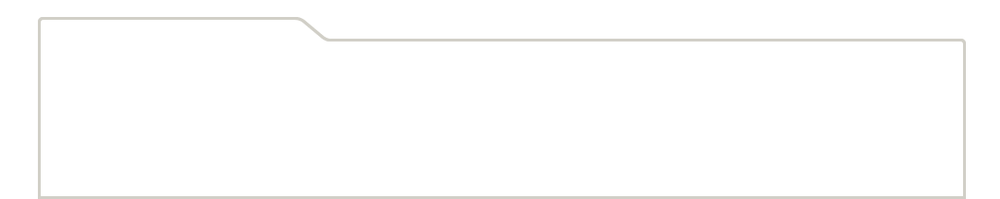
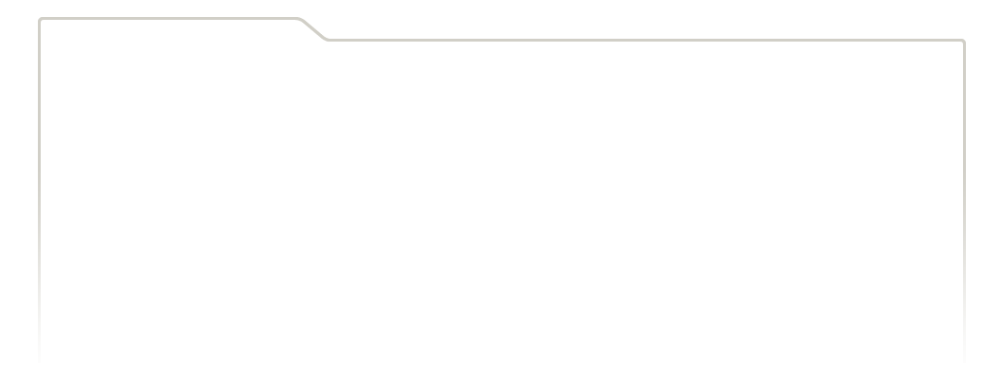
...
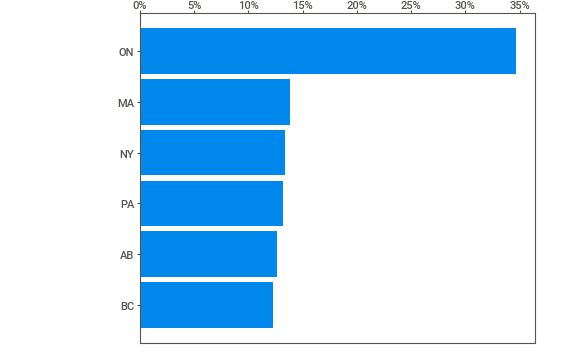
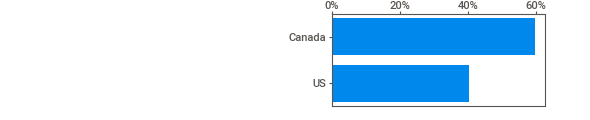
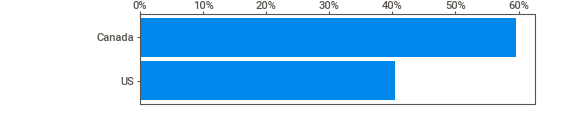
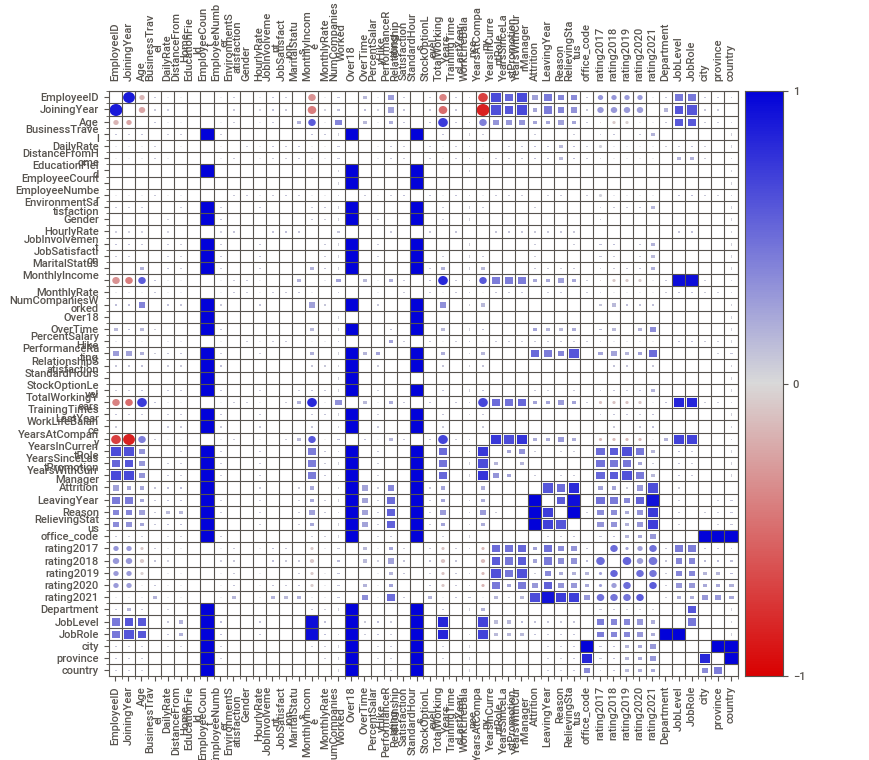
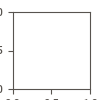

In [ ]:
sweet_report = sv.analyze(df)
sweet_report.show_notebook()

### Creating graphs for all columns according to their type

First, we are checking the shape of the dataframe and the columns types, and changing the type if needed.


In [ ]:
df.shape

(13423, 48)

In [ ]:
df.dtypes

EmployeeID                    int64
JoiningYear                   int64
Age                           int64
BusinessTravel               object
DailyRate                     int64
DistanceFromHome              int64
EducationField               object
EmployeeCount                 int64
EmployeeNumber                int64
EnvironmentSatisfaction       int64
Gender                       object
HourlyRate                    int64
JobInvolvement                int64
JobSatisfaction               int64
MaritalStatus                object
MonthlyIncome                 int64
MonthlyRate                   int64
NumCompaniesWorked            int64
Over18                       object
OverTime                      int64
PercentSalaryHike             int64
PerformanceRating             int64
RelationshipSatisfaction      int64
StandardHours                 int64
StockOptionLevel              int64
TotalWorkingYears             int64
TrainingTimesLastYear         int64
WorkLifeBalance             

Changing the type of the variable from object to category.

In [ ]:
object_to_cat = ['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'city', 'province',
                 'country', 'JobRole', 'MaritalStatus', 'Over18','OverTime', 'office_code','RelievingStatus','Reason']

for col in object_to_cat:
    df[col] = pd.Categorical(df[col])

Changing the type of the variable to ordinal by using a loop.

In [ ]:
columns_to_change = ['EnvironmentSatisfaction', 'JobInvolvement', 'JobLevel', 'JobSatisfaction',
                   'PerformanceRating', 'RelationshipSatisfaction', 'WorkLifeBalance','StockOptionLevel']

for col in columns_to_change:
    df[col] = pd.Categorical(df[col], ordered=True)

In [ ]:
# Convert all characters to lowercase, then replace 'l' with '', and then convert the variable to ordinal.
df['JobLevel'] = [level.lower().replace('l', '') for level in df['JobLevel']]
df['JobLevel'] = pd.Categorical(df['JobLevel'], ordered=True)

Checking the types after the conversion.

In [ ]:
print(df.dtypes)

EmployeeID                     int64
JoiningYear                    int64
Age                            int64
BusinessTravel              category
DailyRate                      int64
DistanceFromHome               int64
EducationField              category
EmployeeCount                  int64
EmployeeNumber                 int64
EnvironmentSatisfaction     category
Gender                      category
HourlyRate                     int64
JobInvolvement              category
JobSatisfaction             category
MaritalStatus               category
MonthlyIncome                  int64
MonthlyRate                    int64
NumCompaniesWorked             int64
Over18                      category
OverTime                    category
PercentSalaryHike              int64
PerformanceRating           category
RelationshipSatisfaction    category
StandardHours                  int64
StockOptionLevel            category
TotalWorkingYears              int64
TrainingTimesLastYear          int64
W

#### Graphs for the categorical and ordinal variables:

We used a countplot for each of the categorical/ordinal variables. Some of the variables needed seperate graphs because they had too many categories for a subplot.

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import math

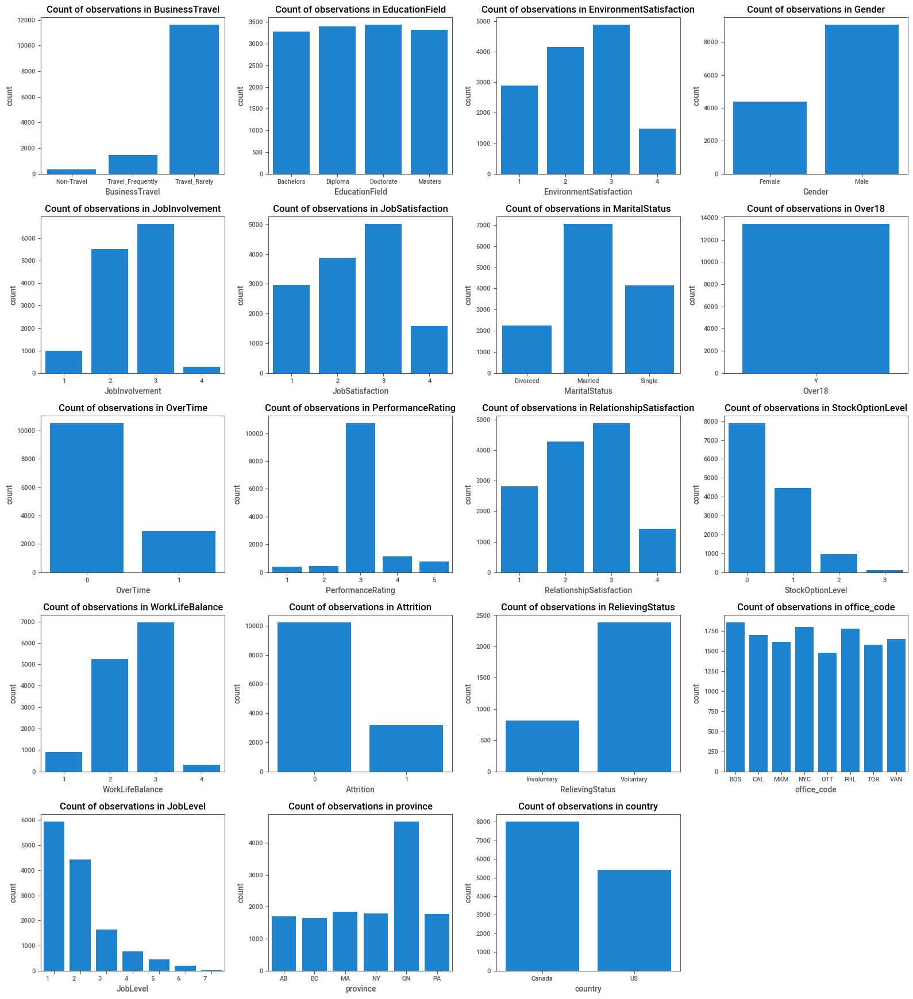

In [ ]:
# Specify columns to exclude from plotting
columns_to_exclude = ['Reason', 'JobRole', 'Department', 'city']  # Add the names of columns you want to exclude

# Select only categorical columns with the "category" data type
categorical_columns = df.select_dtypes(include='category').columns

# Remove excluded columns
categorical_columns = [col for col in categorical_columns if col not in columns_to_exclude]

# Calculate the number of rows and columns for subplots
num_columns = 4
num_rows = math.ceil(len(categorical_columns) / num_columns)

# Set up subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize=(16, 3.5 * num_rows))  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each categorical column (excluding excluded columns) and create a countplot in a subplot
for i, column in enumerate(categorical_columns):
    sns.countplot(x=column, data=df, ax=axes[i])
    axes[i].set_title(f'Count of observations in {column}')

# Remove any empty subplots
for i in range(len(categorical_columns), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()



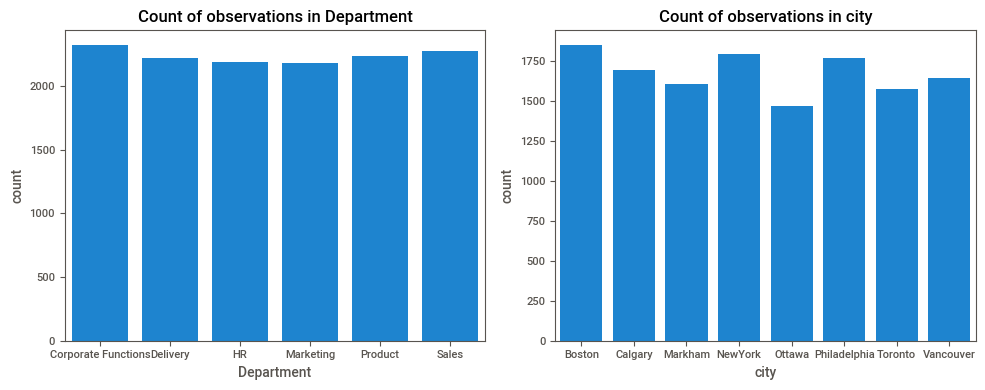

In [ ]:
# Remove excluded columns
cat_columns1 =  ['Department', 'city']

# Calculate the number of rows and columns for subplots
num_columns = 2
num_rows = 1

# Set up subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize=(10, 4 * num_rows))  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each categorical column (excluding excluded columns) and create a countplot in a subplot
for i, column in enumerate(cat_columns1):
    sns.countplot(x=column, data=df, ax=axes[i])
    axes[i].set_title(f'Count of observations in {column}')

# Remove any empty subplots
for i in range(len(cat_columns1), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

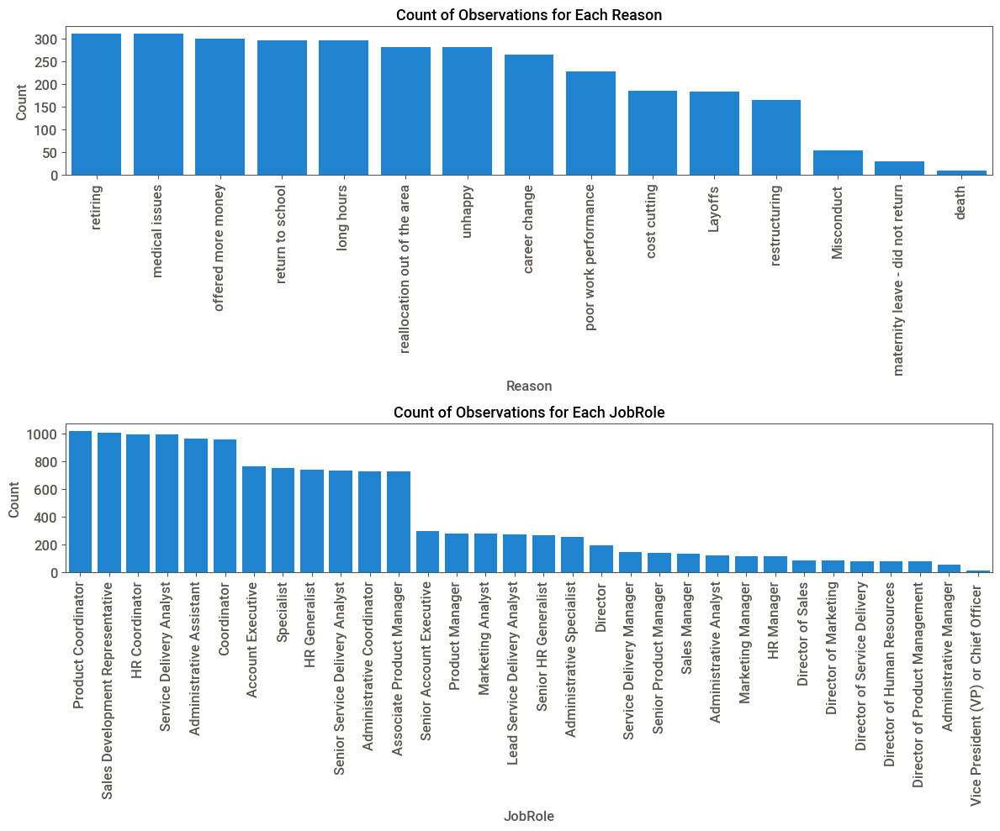

In [ ]:
# Select the column with many categories
columns_with_many_categories = ['Reason', 'JobRole']

# Set up the plot
plt.figure(figsize=(12, 5 * len(columns_with_many_categories)))  # Adjust the figure size as needed

# Create the count plot for each column
for i, column in enumerate(columns_with_many_categories, 1):
    plt.subplot(len(columns_with_many_categories), 1, i)
    sns.countplot(x=column, data=df, order=df[column].value_counts().index)
    plt.title(f'Count of Observations for Each {column}', fontsize=13)
    plt.xlabel(column, fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.xticks(rotation=90, fontsize=12)  # Rotate x-axis labels and decrease font size for better readability
    plt.yticks(fontsize=12)
    plt.tight_layout()

plt.show()


#### Graphs for the numeric variables:

We used two types of graphs for the numric variables. For the continuous variables we used histplots with a line, and for the discrete variables we used countplot.   

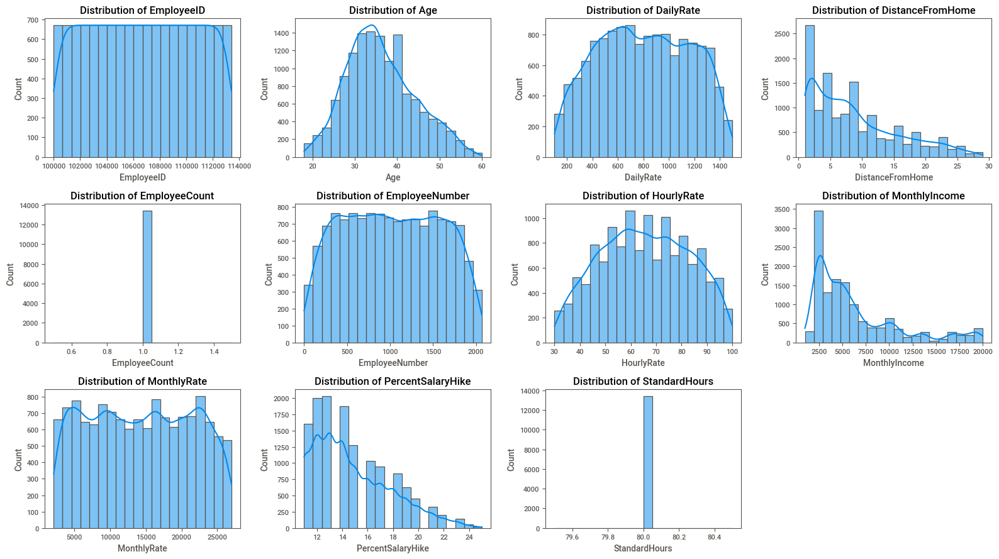

In [ ]:
# Select only numeric columns with non-empty and non-"unnamed" names, excluding specific columns
numeric_columns = [col for col in df.select_dtypes(include='number').columns
                   if col.strip() and 'unnamed' not in col.lower()
                   and col not in ['JoiningYear', 'NumCompaniesWorked', 'TotalWorkingYears', 'YearsAtCompany',
                                   'YearsInCurrentRole', 'TrainingTimesLastYear', 'YearsSinceLastPromotion',
                                   'YearsWithCurrManager', 'LeavingYear', 'rating2017', 'rating2018', 'rating2019',
                                   'rating2020', 'rating2021']]

# Drop rows with missing values from numeric columns
df_numeric = df[numeric_columns].dropna()

# Calculate the number of rows and columns for subplots
num_columns = 4
num_rows = math.ceil(len(numeric_columns) / num_columns)

# Set up subplots with adjusted height_ratios
fig, axes = plt.subplots(num_rows, num_columns, figsize=(16, 3 * num_rows),
                         gridspec_kw={'height_ratios': [4] * num_rows})  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each numeric column and create a histogram
for i, column in enumerate(numeric_columns):
    sns.histplot(df_numeric[column], kde=True, ax=axes[i], bins=20)  # Adjust the number of bins as needed
    axes[i].set_title(f'Distribution of {column}')

# Remove any empty subplots
for i in range(len(numeric_columns), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

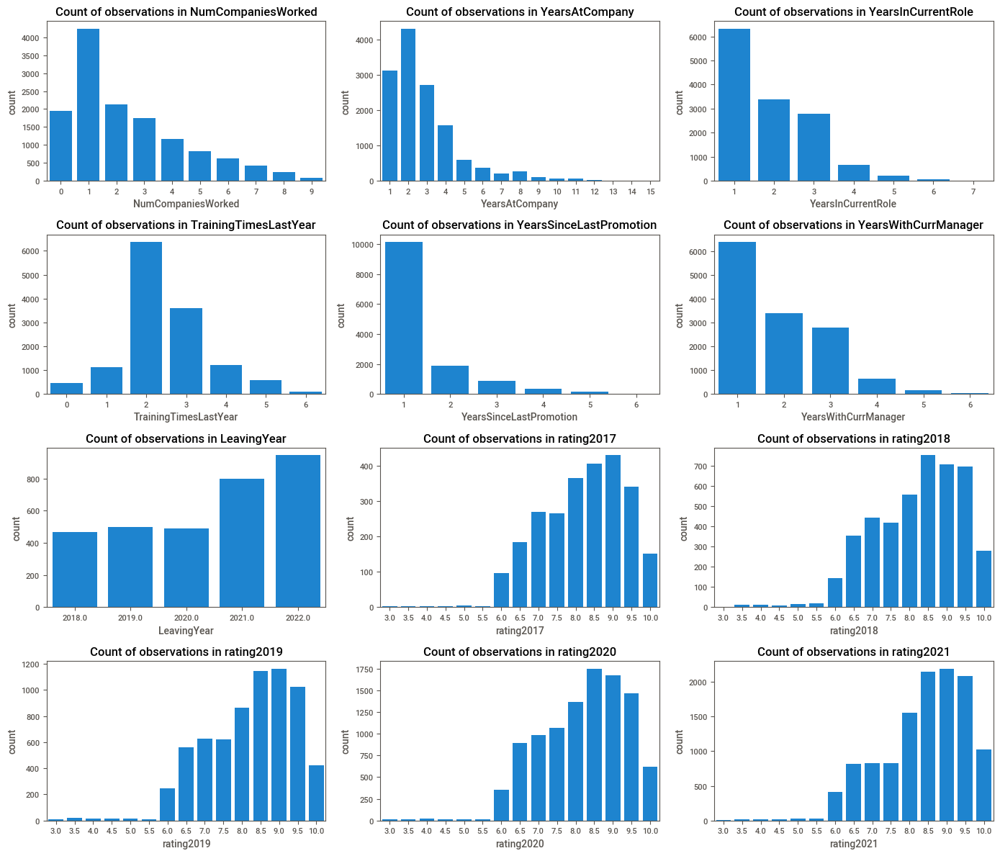

In [ ]:
# Specify columns to exclude from plotting
columns_to_include = ['NumCompaniesWorked', 'YearsAtCompany', 'YearsInCurrentRole', 'TrainingTimesLastYear', 'YearsSinceLastPromotion',
                      'YearsWithCurrManager', 'LeavingYear', 'rating2017', 'rating2018', 'rating2019','rating2020', 'rating2021']

# Remove excluded columns
descrete_columns = [col for col in columns_to_include]

# Calculate the number of rows and columns for subplots
num_columns = 3
num_rows = math.ceil(len(descrete_columns) / num_columns)

# Set up subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize=(14, 3 * num_rows))  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each categorical column (excluding excluded columns) and create a countplot in a subplot
for i, column in enumerate(descrete_columns):
    sns.countplot(x=column, data=df, ax=axes[i])
    axes[i].set_title(f'Count of observations in {column}')

# Remove any empty subplots
for i in range(len(descrete_columns), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

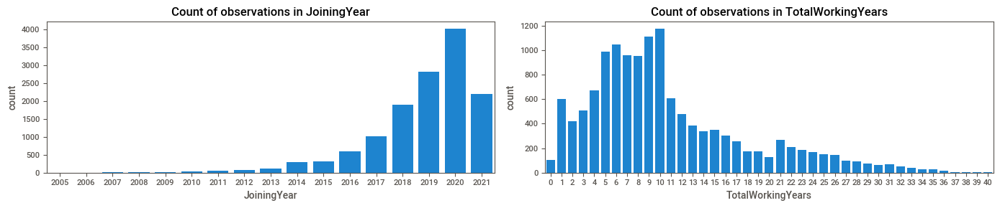

In [ ]:
# Specify columns to exclude from plotting
columns_to_include = ['JoiningYear', 'TotalWorkingYears']  # Add the names of columns you want to exclude

# Remove excluded columns
descrete_columns = [col for col in columns_to_include]

# Calculate the number of rows and columns for subplots
num_columns = 2
num_rows = math.ceil(len(descrete_columns) / num_columns)

# Set up subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize=(14, 3 * num_rows))  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each categorical column (excluding excluded columns) and create a countplot in a subplot
for i, column in enumerate(descrete_columns):
    sns.countplot(x=column, data=df, ax=axes[i])
    axes[i].set_title(f'Count of observations in {column}')

# Remove any empty subplots
for i in range(len(descrete_columns), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

### Using boxplots to detect which variables have extreme values (outliers)

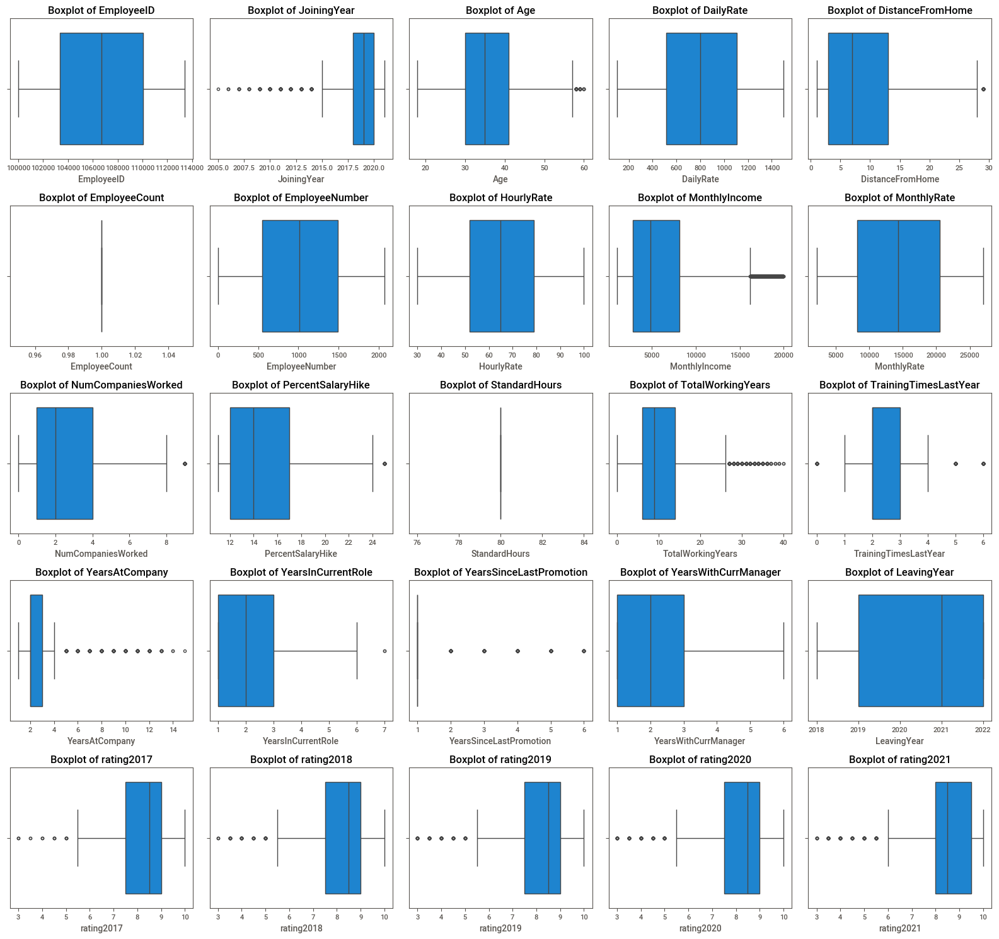

In [ ]:
%matplotlib inline

import matplotlib.pyplot as plt
import math

# Assuming 'df' is your DataFrame

# Select only numeric columns with non-empty and non-"unnamed" names
numeric_columns = [col for col in df.select_dtypes(include='number').columns if col.strip() and 'unnamed' not in col.lower()]

# Calculate the number of rows and columns for subplots
num_columns = 5  # Adjust the number of columns as needed
num_rows = math.ceil(len(numeric_columns) / num_columns)

# Set up subplots
fig, axes = plt.subplots(num_rows, num_columns, figsize=(16, 3 * num_rows))  # Adjust the figure size as needed

# Flatten the axes array to make it easier to index
axes = axes.flatten()

# Loop through each numeric column and create a boxplot in a subplot
for i, column in enumerate(numeric_columns):
    sns.boxplot(x=df[column], ax=axes[i])
    axes[i].set_title(f'Boxplot of {column}')

# Remove any empty subplots
for i in range(len(numeric_columns), num_rows * num_columns):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()

### Checking the correlation between the numeric variables.

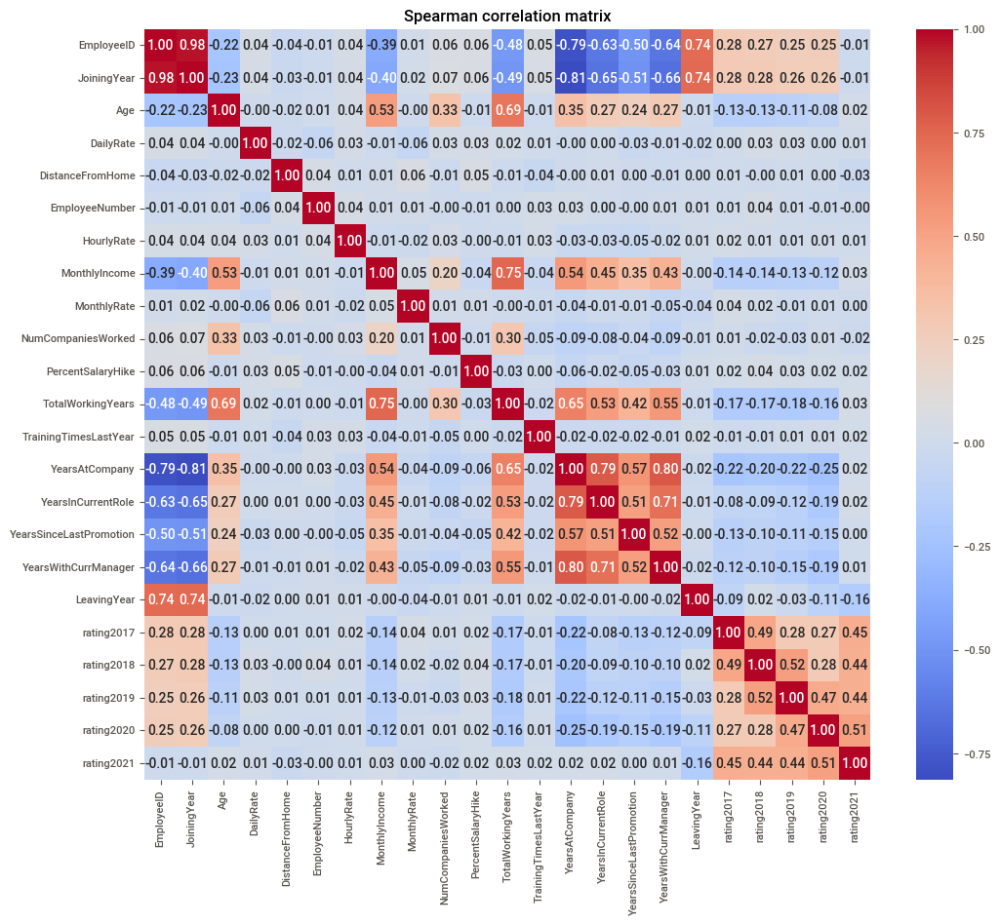

In [ ]:
drop_columns = ['EmployeeCount', 'StandardHours']
numeric_columns = df.select_dtypes(include='number').drop(columns=drop_columns, errors='ignore')

# יצירת מטריצת קורלציה
correlation_matrix = numeric_columns.corr(method='spearman')

# השתמשי ב Seaborn ליצירת חום-מפת קורלציה
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Spearman correlation matrix")
plt.show()

These are the patterns that can be seen from the relationship between the variables in the postive correlation matrix:
* There is a correlation between all the variables related to the satisfaction rating in the different years.
* There is a high positve correlation between these variables: YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrentManager.
* There is a high negative correlation between the variables (EmployeeID, JoiningYear) and (YearsAtCompany, YearsInCurrentRole, YearsSinceLastPromotion, YearsWithCurrentManager).
* There is a very high positive correlation between (EmployeeID, JoiningYear) and LeavingYear.
* There is too high correlation between EmployeeID and JoiningYear, and we should remove one of these variables in the feature engineer stage.
* The other correlations can be seen in the graph.

Now we will show pairplots for all the vairbales that their correlation with another variable is higher than 0.7.

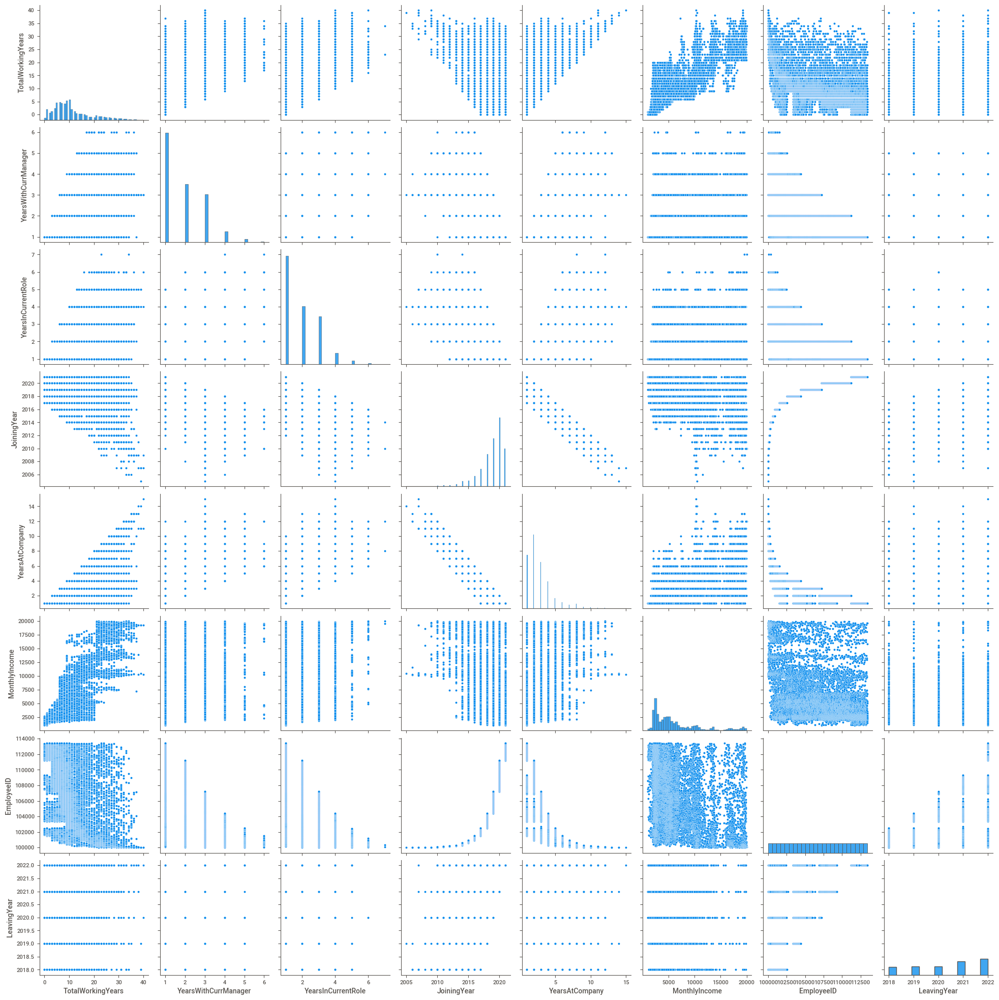

In [ ]:
high_correlation_pairs = [(var1, var2) for var1 in correlation_matrix.columns for var2 in correlation_matrix.columns
                          if ((correlation_matrix[var1][var2] >= 0.7 or correlation_matrix[var1][var2] <= -0.7) and var1 != var2)]

# Build lists for each variable in the pairs
variables = list(set([pair[0] for pair in high_correlation_pairs] + [pair[1] for pair in high_correlation_pairs]))

# Use seaborn's pairplot to create a plot for each pair of variables
sns.pairplot(df[variables])
plt.show()

### The difference of the numeric variables within categories of different categorical variables.

Now we will use statistical analysis to check the differences between the numeric variables within categories of different categorical variables.
We will use Shapiro to check if a variable has a normal distribution or
not.

For the normal distributed variables we will use ANOVA test to compare a continuous-normal variable (x1) with a categorical variable(x2).
For the non-normal distributed variables we will use the Kruskal-Wallis test to comapre a continuous non-normal variable (x1) with a categorical variable(x2).

In [ ]:
from scipy.stats import shapiro

numeric_columns = df.select_dtypes(include='number').drop(columns=['EmployeeCount', 'StandardHours']).columns.tolist()

normally_distributed = []
not_normally_distributed = []

for column in numeric_columns:
    stat, p_value = shapiro(df[column])
    if p_value > 0.05:
        normally_distributed.append(column)
    else:
        not_normally_distributed.append(column)

print("Normally Distributed Variables:", normally_distributed)
print("Not Normally Distributed Variables:", not_normally_distributed)


Normally Distributed Variables: ['LeavingYear', 'rating2017', 'rating2018', 'rating2019', 'rating2020', 'rating2021']
Not Normally Distributed Variables: ['EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']


/usr/local/lib/python3.10/dist-packages/scipy/stats/_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


ANOVA test for the normally distributed variables: 'LeavingYear', 'rating2017', 'rating2018', 'rating2019', 'rating2020', 'rating2021'.

In [ ]:
from scipy.stats import f_oneway

# Assuming df is your DataFrame
categorical_columns = df.select_dtypes(include='category').drop(columns=['Over18']).columns.tolist()
numeric_columns = ['LeavingYear', 'rating2017', 'rating2018', 'rating2019', 'rating2020', 'rating2021']

# Create a dictionary to store ANOVA results
anova_results = {}

# Loop over each numeric variable
for numeric_column in numeric_columns:
    # Create lists to store tuples for the current numeric variable
    significant_results = []
    insignificant_categories = []

    # Loop over each categorical variable
    for category_column in categorical_columns:
        # Extract unique values for the current category
        unique_values = df[category_column].unique()

        # Check if there are at least two unique values in the current category
        if len(unique_values) < 2:
            continue

        # ANOVA Test
        stat, p_value = f_oneway(*[df[numeric_column][df[category_column] == category_value] for category_value in unique_values])

        # Store the results in the appropriate list
        if p_value < 0.05:
            significant_results.append((category_column, p_value))
        else:
            insignificant_categories.append(category_column)

    # Store the lists of tuples in the dictionary
    anova_results[numeric_column] = (significant_results, insignificant_categories)

# Print the results
for numeric_column, (significant_results, insignificant_categories) in anova_results.items():
    print(f"\nANOVA Test results for {numeric_column}:")
    for category_column, p_value in significant_results:
        print(f"  There is a significant difference with {category_column}.")
        print(f"  The p-value is: {round(p_value, 4)}")
    if insignificant_categories:
        print("  The following categories are insignificant:")
        print("  ", ", ".join(insignificant_categories))
    else:
        print("  All categories are significant.")


/usr/local/lib/python3.10/dist-packages/scipy/stats/_stats_py.py:4133: DegenerateDataWarning: at least one input has length 0
  warnings.warn(stats.DegenerateDataWarning('at least one input '



ANOVA Test results for LeavingYear:
  The following categories are insignificant:
   BusinessTravel, EducationField, EnvironmentSatisfaction, Gender, JobInvolvement, JobSatisfaction, MaritalStatus, OverTime, PerformanceRating, RelationshipSatisfaction, StockOptionLevel, WorkLifeBalance, Attrition, Reason, RelievingStatus, office_code, Department, JobLevel, JobRole, city, province, country

ANOVA Test results for rating2017:
  The following categories are insignificant:
   BusinessTravel, EducationField, EnvironmentSatisfaction, Gender, JobInvolvement, JobSatisfaction, MaritalStatus, OverTime, PerformanceRating, RelationshipSatisfaction, StockOptionLevel, WorkLifeBalance, Attrition, Reason, RelievingStatus, office_code, Department, JobLevel, JobRole, city, province, country

ANOVA Test results for rating2018:
  The following categories are insignificant:
   BusinessTravel, EducationField, EnvironmentSatisfaction, Gender, JobInvolvement, JobSatisfaction, MaritalStatus, OverTime, Perform

No numeric variable was found to be significant within categorical variable in the ANOVA test.

Kruskal-Wallis test for non-normal numeric variables: 'EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager'.

In [ ]:
from scipy.stats import kruskal

# Assuming df is your DataFrame
categorical_columns = df.select_dtypes(include='category').drop(columns=['Over18']).columns.tolist()
numeric_columns = ['EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome',
                   'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany',
                   'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']


# Create a dictionary to store Kruskal-Wallis results
kruskal_results = {}

# Loop over each numeric variable
for numeric_column in numeric_columns:
    # Create lists to store tuples for the current numeric variable
    significant_results = []
    insignificant_categories = []

    # Loop over each categorical variable
    for category_column in categorical_columns:
        # Extract unique values for the current category
        unique_values = df[category_column].unique()

        # Check if there are at least two unique values in the current category
        if len(unique_values) < 2:
            continue

        # Kruskal-Wallis Test
        stat, p_value = kruskal(*[df[numeric_column][df[category_column] == category_value] for category_value in unique_values])

        # Store the results in the appropriate list
        if p_value < 0.05:
            significant_results.append((category_column, p_value))
        else:
            insignificant_categories.append(category_column)

    # Store the lists of tuples in the dictionary
    kruskal_results[numeric_column] = (significant_results, insignificant_categories)

# Print the results
for numeric_column, (significant_results, insignificant_categories) in kruskal_results.items():
    print(f"\nKruskal-Wallis Test results for {numeric_column}:")
    for category_column, p_value in significant_results:
        print(f"  There is a significant difference with {category_column}.")
        print(f"  The p-value is: {round(p_value, 4)}")
    if insignificant_categories:
        print("  The following categories are insignificant:")
        print("  ", ", ".join(insignificant_categories))
    else:
        print("  All categories are significant.")


Kruskal-Wallis Test results for EmployeeID:
  There is a significant difference with BusinessTravel.
  The p-value is: 0.0
  There is a significant difference with EnvironmentSatisfaction.
  The p-value is: 0.0001
  There is a significant difference with Gender.
  The p-value is: 0.0259
  There is a significant difference with JobInvolvement.
  The p-value is: 0.0
  There is a significant difference with JobSatisfaction.
  The p-value is: 0.0
  There is a significant difference with OverTime.
  The p-value is: 0.0
  There is a significant difference with PerformanceRating.
  The p-value is: 0.0
  There is a significant difference with RelationshipSatisfaction.
  The p-value is: 0.0
  There is a significant difference with StockOptionLevel.
  The p-value is: 0.0051
  There is a significant difference with WorkLifeBalance.
  The p-value is: 0.0285
  There is a significant difference with Attrition.
  The p-value is: 0.0
  There is a significant difference with office_code.
  The p-value

Since the variables of the ANOVA test are insignificant, we will take only the variables that are significant from the Kruskal-Wallis test.

To complete the test, we will also need to specifically test which pairs of categories are significant against the numeric variable when the categorical variable has 3 or more categories. For example, the BusinessTravel variable is significant against age, but we would like to know which categories of BusinessTravel have a significant difference against age. For example, there is a clear difference in the age of employees, between those that Travel_Frequently and those that Travel_Rarely. That is, just saying that the BusinessTravel variable is significant compared to age is not enough, and we would like to do a more nuanced examination.

The test we will use for 3 and more categories is Dunn's test. Dunn's test is a post hoc test used to examine pairwise differences between groups when there are more than two categories. The test is applied in cases where significant results are obtained from the Kruskal-Wallis test, which is used to assess statistical differences among three or more groups.

The test works by conducting a certain number of comparisons between each pair of groups. Subsequently, p-values are obtained for each of these comparisons. The lower the p-values, the higher the statistical distinction between the groups.

For example, for the age vs. BussinessTravel variables in cell (1, 3) the p-value is 0.0018, which is very low. This indicates a significant distinction between category 1 and category 3 regarding the numeric variable "Age". Similarly, cell (2, 3) signifies a significant difference between category 2 and category 3, and so on.

In [ ]:
import pandas as pd
from scipy.stats import kruskal
import scikit_posthocs as sp

# Assuming df is your DataFrame
categorical_columns = df.select_dtypes(include='category').columns.tolist()
numeric_columns = ['EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome',
                   'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany',
                   'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

# Create dictionaries to store Kruskal-Wallis and Dunn's test results
kruskal_results = {}
dunn_results = {}

# Loop over each numeric variable
for numeric_column in numeric_columns:
    # Create lists to store tuples for the current numeric variable
    kruskal_numeric_results = []
    dunn_numeric_results = []

    # Loop over each categorical variable
    for category_column in categorical_columns:
        # Extract unique values for the current category
        unique_values = df[category_column].unique()

        # Check if there are at least three unique values in the current category
        if len(unique_values) < 3:
            continue

        # Kruskal-Wallis Test
        stat, p_value = kruskal(*[df[numeric_column][df[category_column] == category_value] for category_value in unique_values])

        # Store Kruskal-Wallis results in the list
        kruskal_numeric_results.append((category_column, p_value))

        # Check if the p-value is less than 0.05 for Dunn's test
        if p_value < 0.05:
            # Dunn's test
            dunn_result = sp.posthoc_dunn([df[numeric_column][df[category_column] == category_value] for category_value in unique_values], p_adjust='holm')

            # Store Dunn's test results in the list
            dunn_numeric_results.append((category_column, dunn_result))

    # Store the lists of tuples in the dictionaries
    kruskal_results[numeric_column] = kruskal_numeric_results
    dunn_results[numeric_column] = dunn_numeric_results


# Print the Dunn's test results
for numeric_column, results in dunn_results.items():
    print(f"\nDunn's Test results for {numeric_column}:")
    for result in results:
        category_column, dunn_result = result
        print(f"  Dunn's test results for {numeric_column} vs. {category_column}:")
        print(round(dunn_result, 4))


Dunn's Test results for EmployeeID:
  Dunn's test results for EmployeeID vs. BusinessTravel:
        1       2       3
1  1.0000  0.0000  0.1274
2  0.0000  1.0000  0.0001
3  0.1274  0.0001  1.0000
  Dunn's test results for EmployeeID vs. EnvironmentSatisfaction:
        1       2       3       4
1  1.0000  0.0027  0.3719  0.0534
2  0.0027  1.0000  0.0012  0.4700
3  0.3719  0.0012  1.0000  0.0119
4  0.0534  0.4700  0.0119  1.0000
  Dunn's test results for EmployeeID vs. JobInvolvement:
        1       2       3       4
1  1.0000  0.0000  0.0000  0.0047
2  0.0000  1.0000  0.1487  0.0000
3  0.0000  0.1487  1.0000  0.0000
4  0.0047  0.0000  0.0000  1.0000
  Dunn's test results for EmployeeID vs. JobSatisfaction:
        1       2       3       4
1  1.0000  0.9261  0.2894  0.0003
2  0.9261  1.0000  0.2894  0.0004
3  0.2894  0.2894  1.0000  0.0000
4  0.0003  0.0004  0.0000  1.0000
  Dunn's test results for EmployeeID vs. PerformanceRating:
        1    2       3       4       5
1  1.0000  0

Now we will use 2 types of graphs to see the differences between the different categories within the numeric variable.
In the boxplots, we will show only the categorical variables that were found to be significant (p_value < 0.05) in the Kruskal-Wallis Test. In the hisplots, we can see all the numeric-categorical variables pairs with the Krustkal-Wallis test results (p_value).

The variable 'JobRole' and 'Reason' removed from the graphs since they have too many categories.

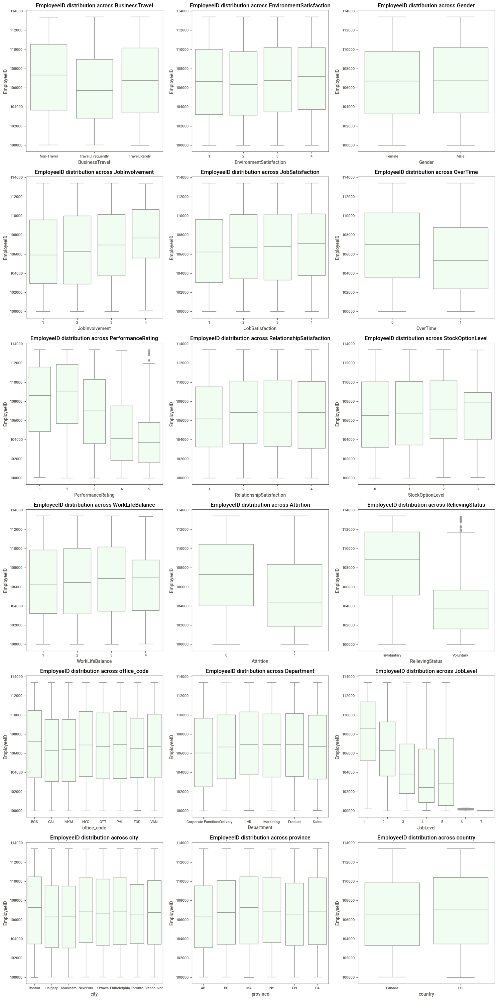

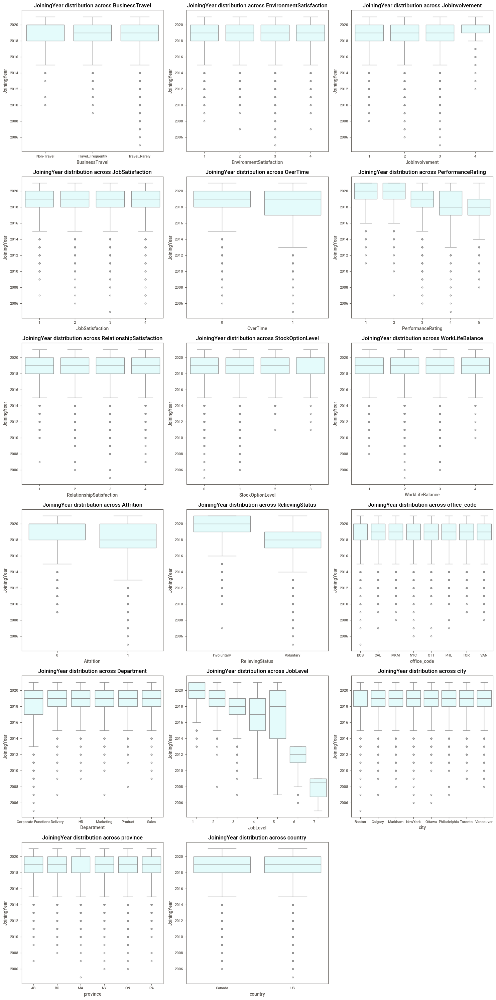

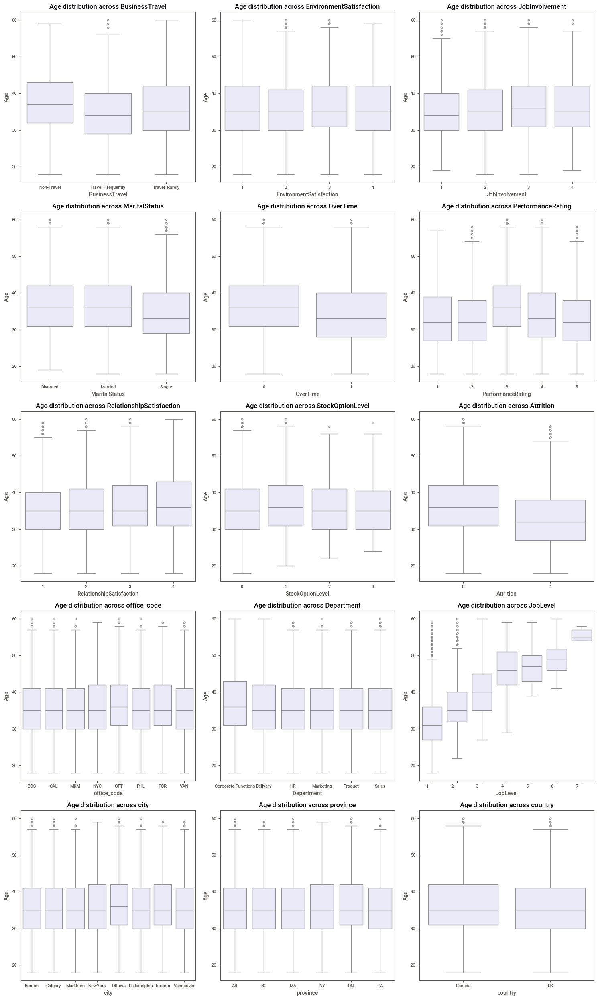

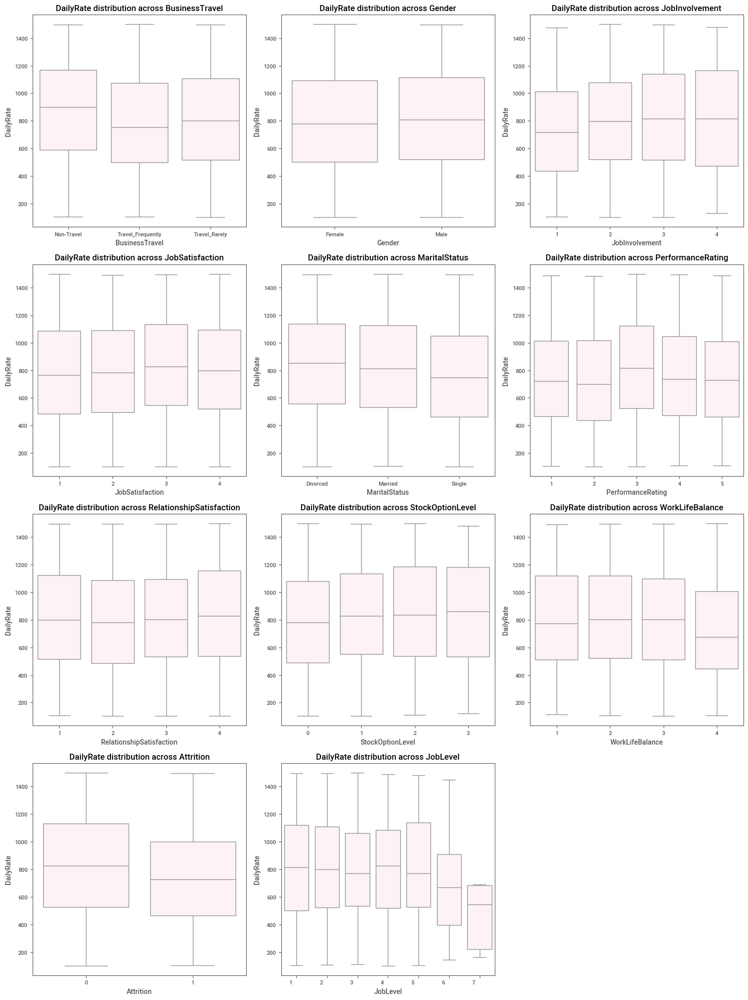

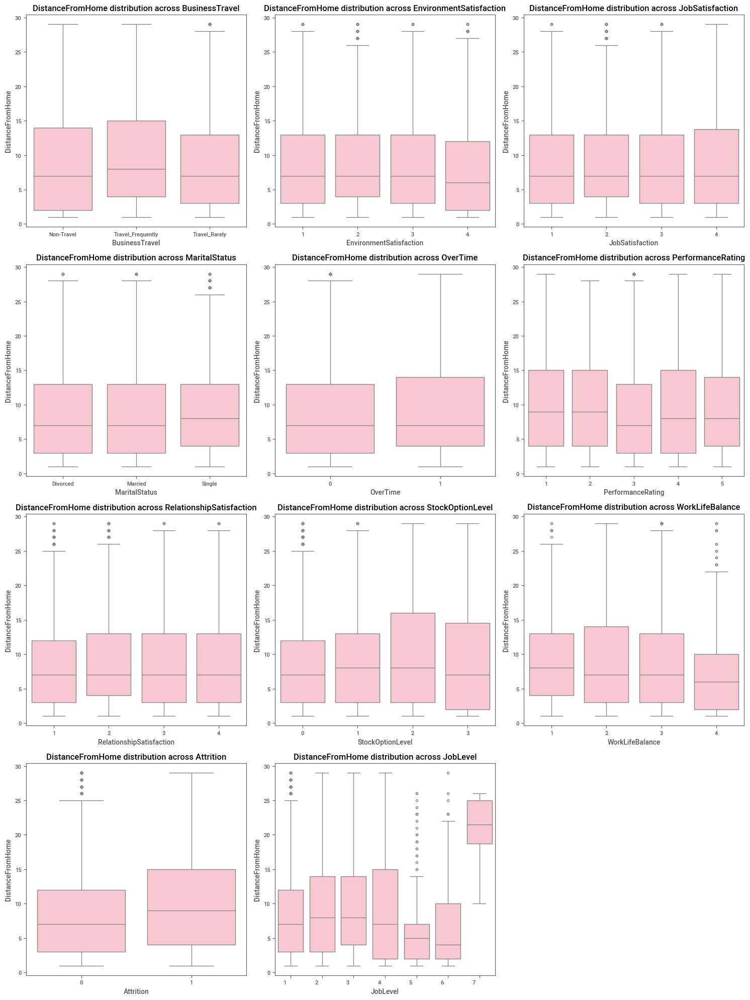

...

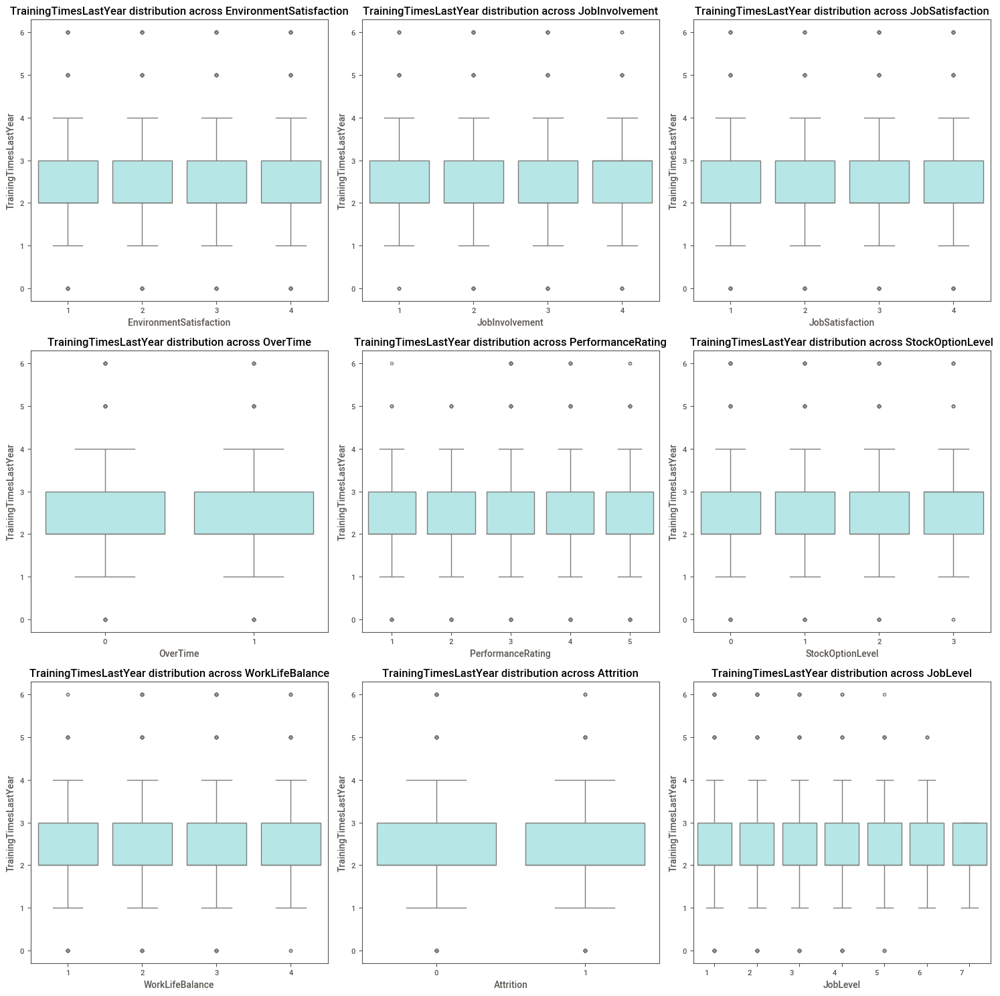

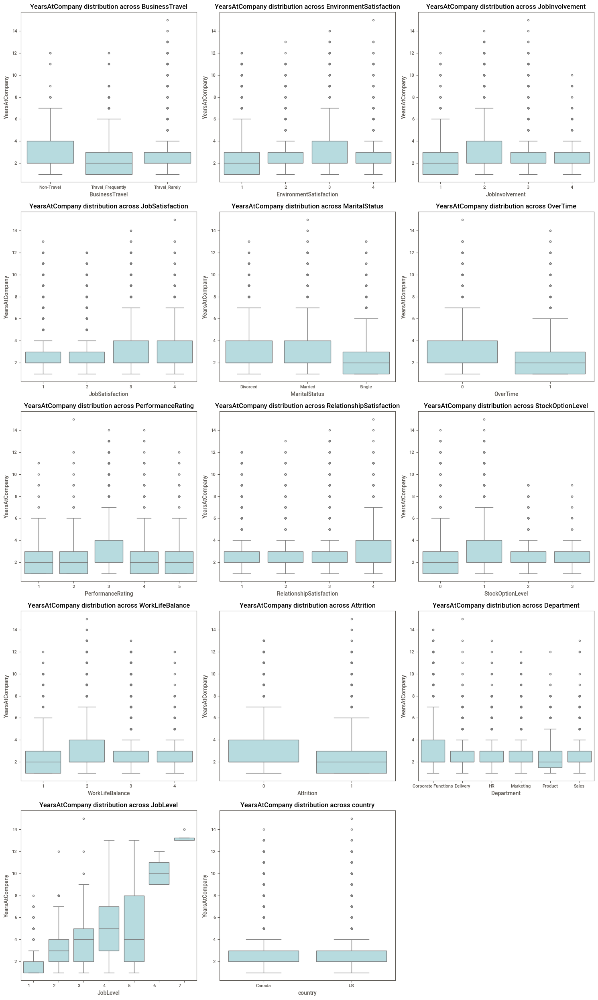

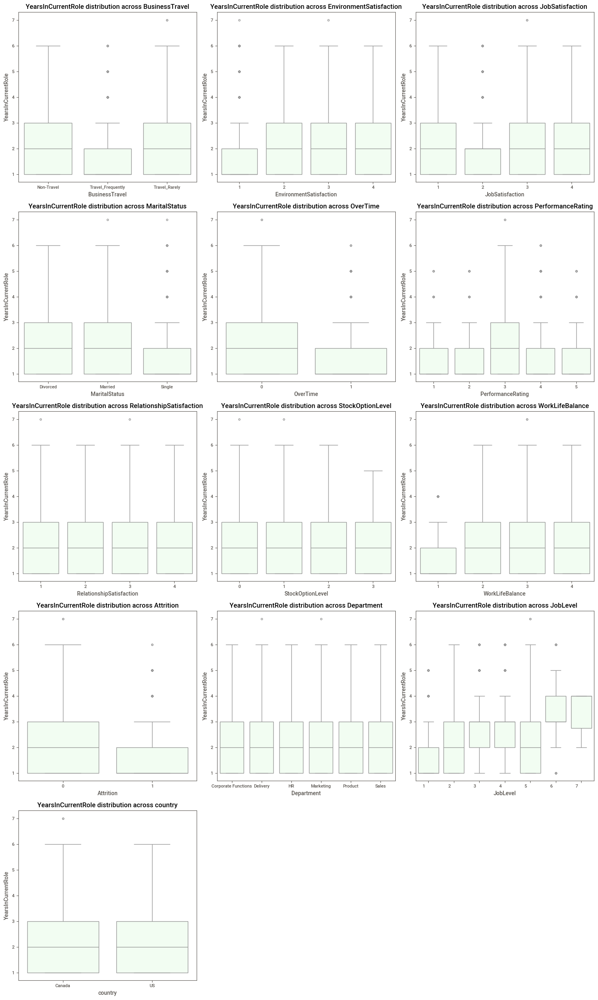

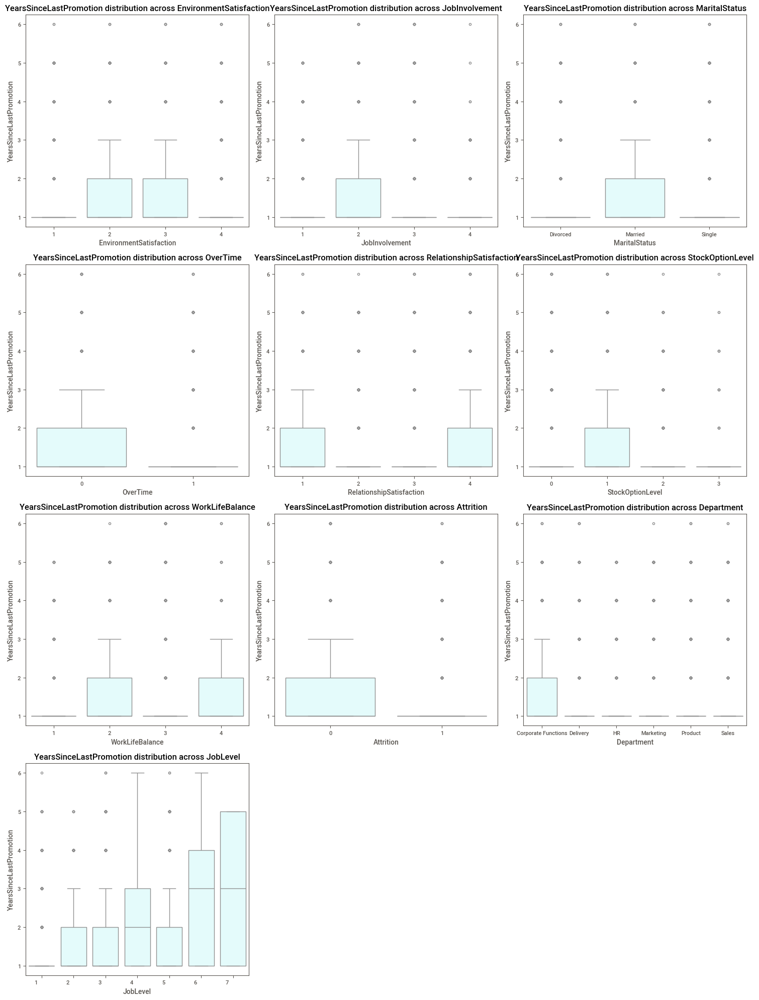

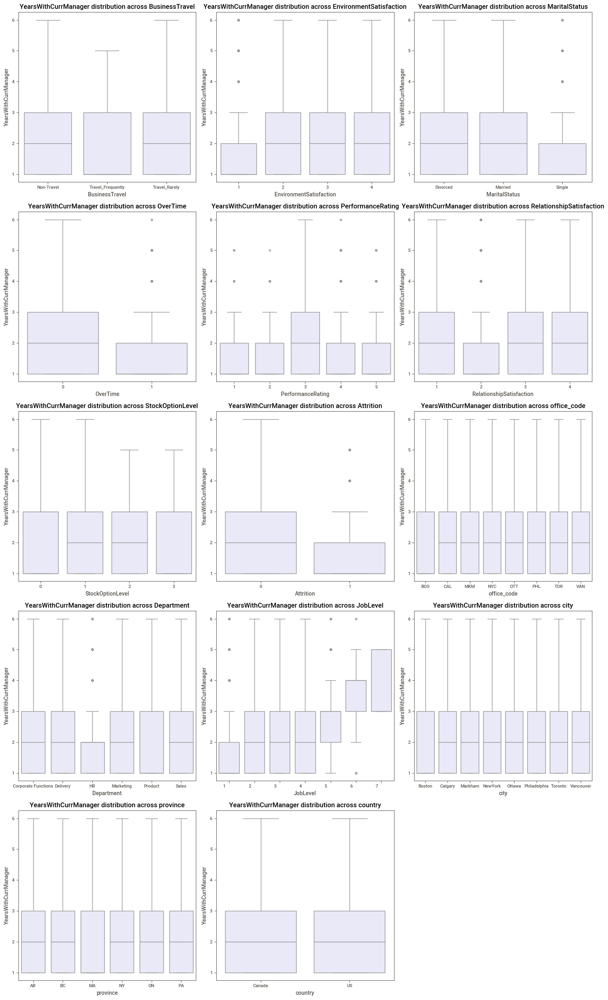

In [ ]:
# Exclude 'JobRole' from categorical variables
categorical_variables = [col for col in df.select_dtypes(include='category').columns if col not in ['JobRole', 'Over18', 'Reason']]
numeric_variables = ['EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome',
                   'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany',
                   'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

# Dictionary to store Kruskal-Wallis test results
kruskal_results = {}

# Loop through numeric variables
for numeric_var in numeric_variables:
    kruskal_results[numeric_var] = []

    # Loop through remaining categorical variables (excluding 'JobRole')
    for categorical_var in categorical_variables:
        try:
            # Perform Kruskal-Wallis test
            stat, p = kruskal(*[group[numeric_var] for name, group in df.groupby(categorical_var)])
            kruskal_results[numeric_var].append((categorical_var, p))
        except Exception as e:
            pass


# Define the number of variables to display in each row
variables_per_row = 3

# Define custom colors for numeric variables
custom_colors = ["honeydew", "lightcyan", "lavender", "lavenderblush", "pink", "paleturquoise", "powderblue"]

# Loop through numeric variables
for i, (numeric_var, results) in enumerate(kruskal_results.items()):
    # Select color for the current numeric variable
    numeric_color = custom_colors[i % len(custom_colors)]

    # Filter out significant results
    significant_results = [(cat_var, p_value) for cat_var, p_value in results if p_value < 0.05]

    # If there are significant results
    if significant_results:
        # Calculate the number of subplots needed
        num_subplots = min(len(significant_results), 18)

        # Calculate the number of rows needed
        num_rows = (num_subplots + variables_per_row - 1) // variables_per_row

        # Create a new figure for each variable
        fig, axes = plt.subplots(num_rows, variables_per_row, figsize=(15, 5*num_rows))

        # Flatten axes for easier indexing
        axes = axes.flatten()

        # Loop through significant results for the current numeric variable
        for j, (cat_var, p_value) in enumerate(significant_results[:num_subplots]):
            sns.boxplot(x=cat_var, y=numeric_var, data=df, color=numeric_color, ax=axes[j])
            axes[j].set_title(f'{numeric_var} distribution across {cat_var}')

        # Hide empty subplots
        for k in range(num_subplots, len(axes)):
            fig.delaxes(axes[k])

        # Adjust layout
        plt.tight_layout()
        plt.show()


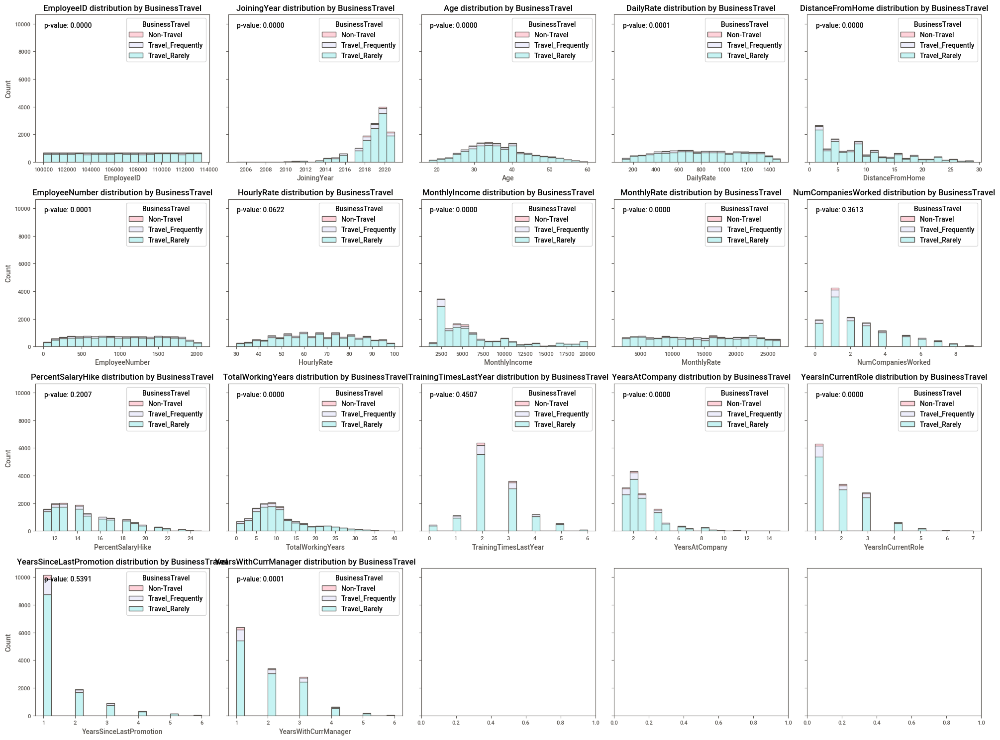

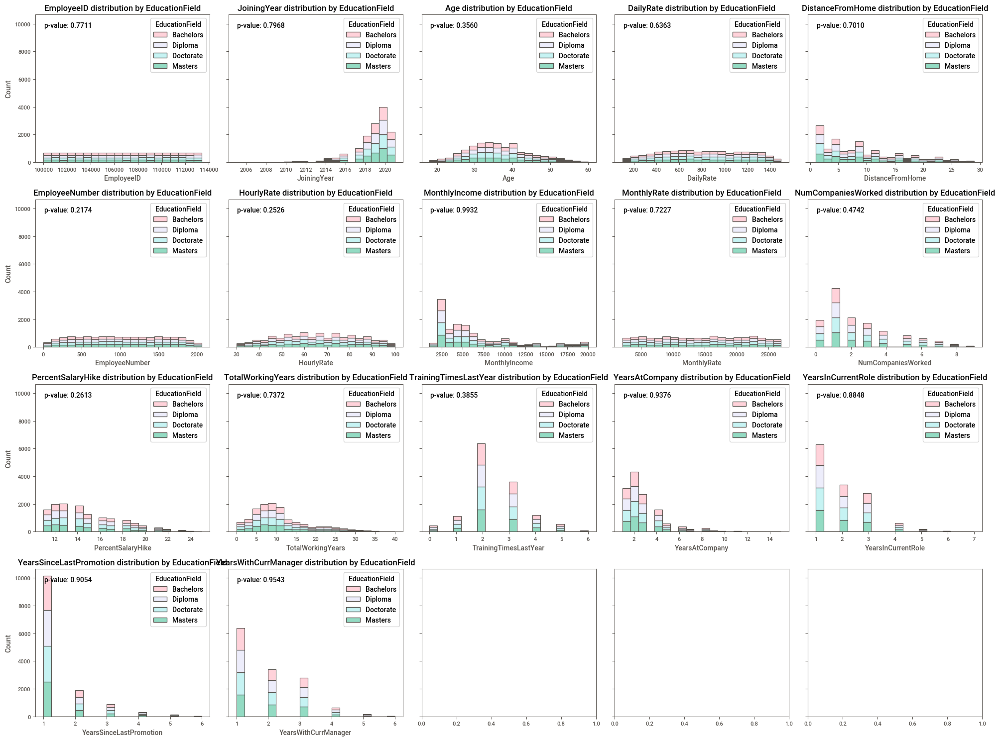

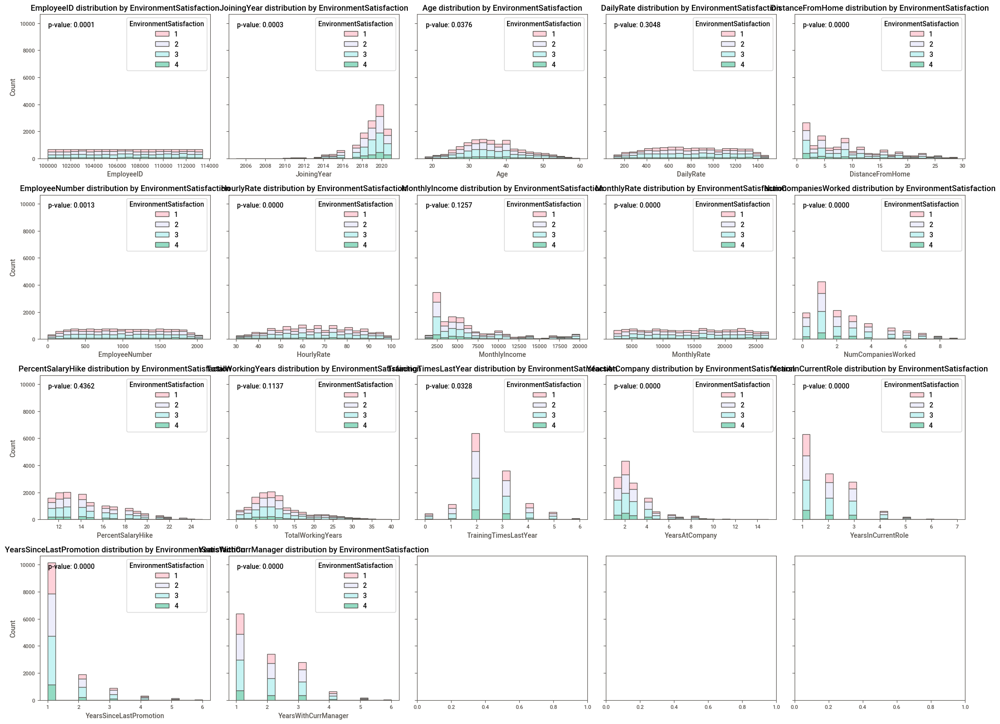

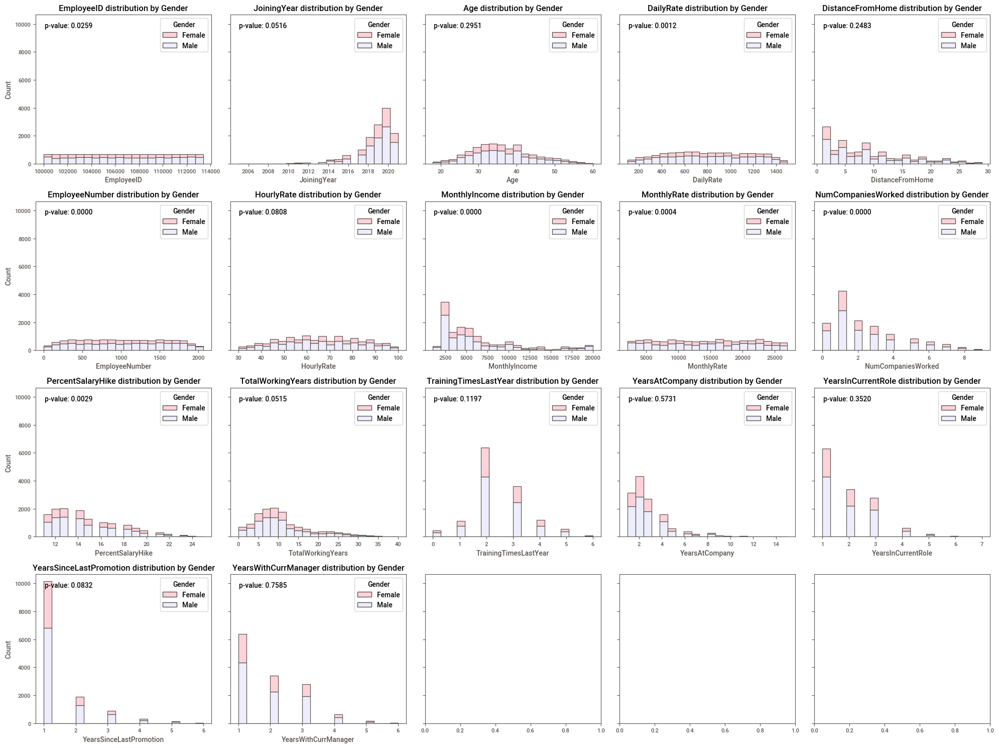

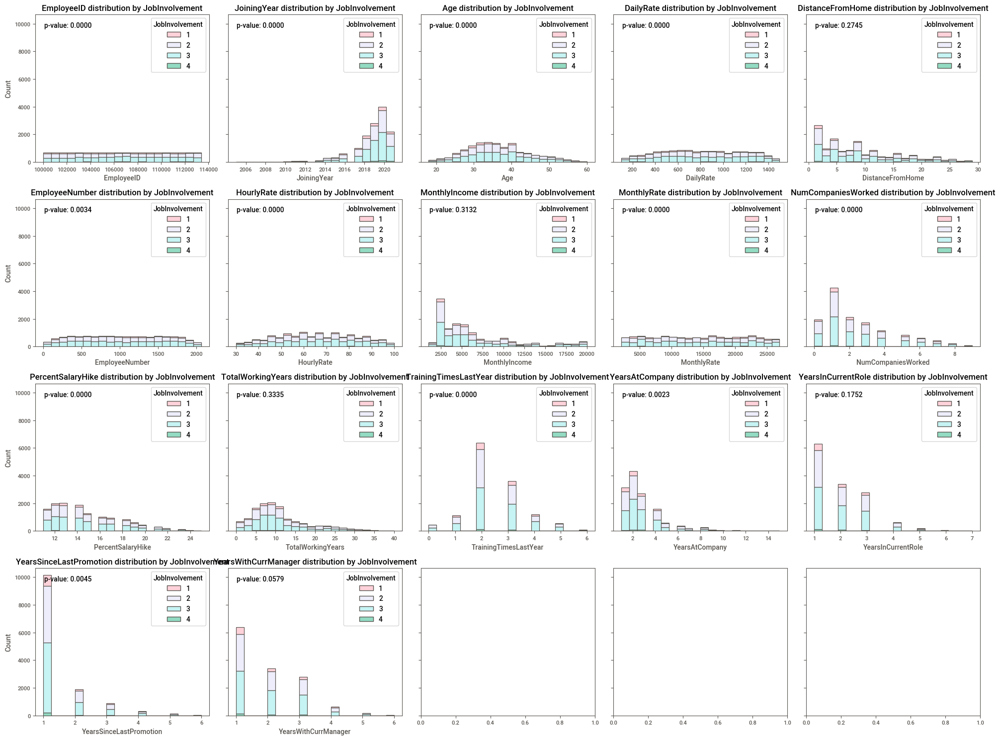

...

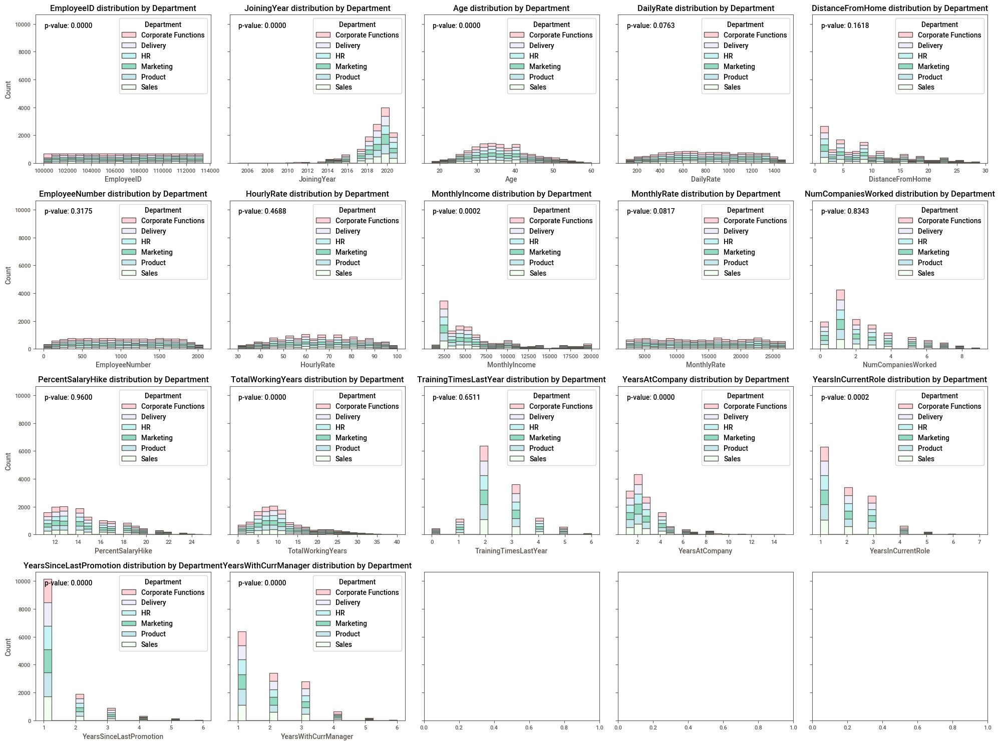

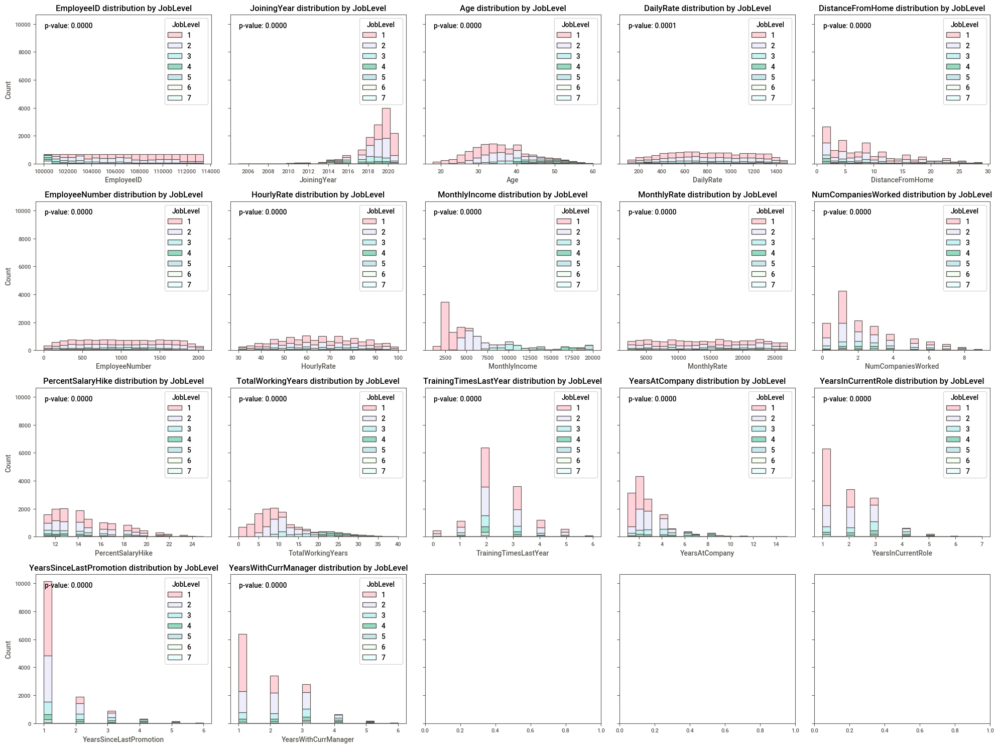

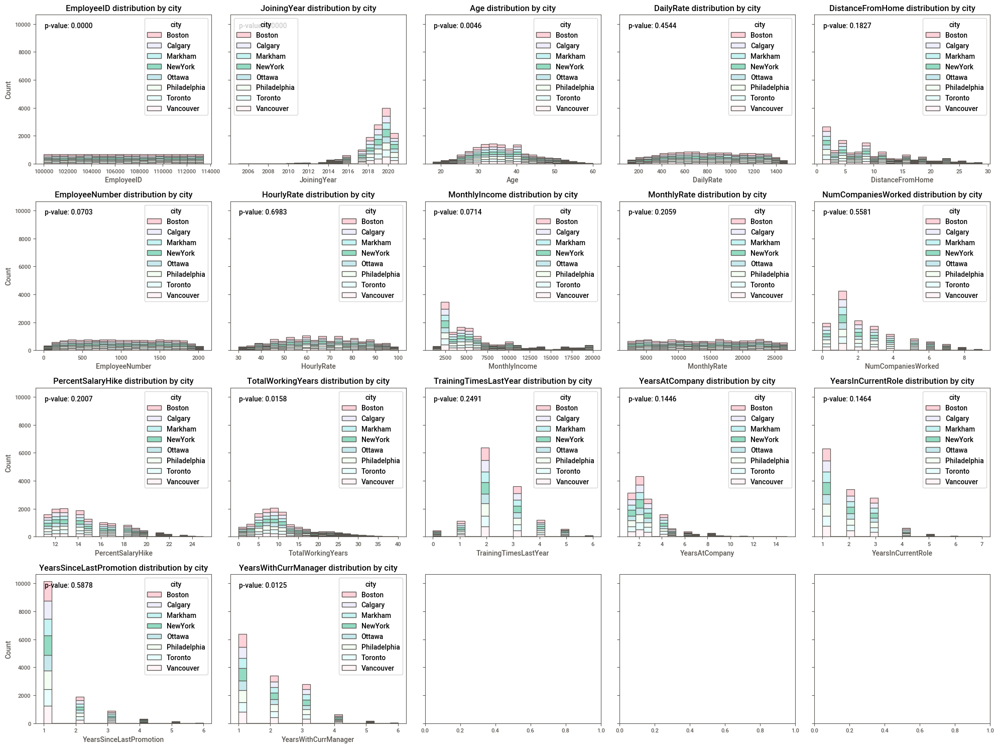

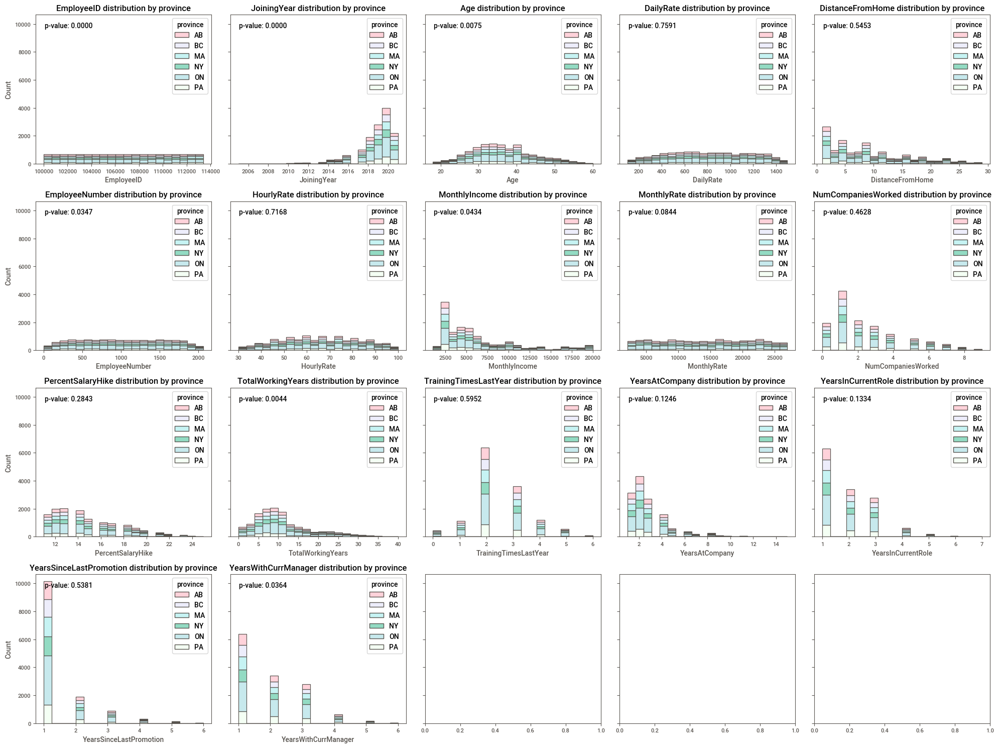

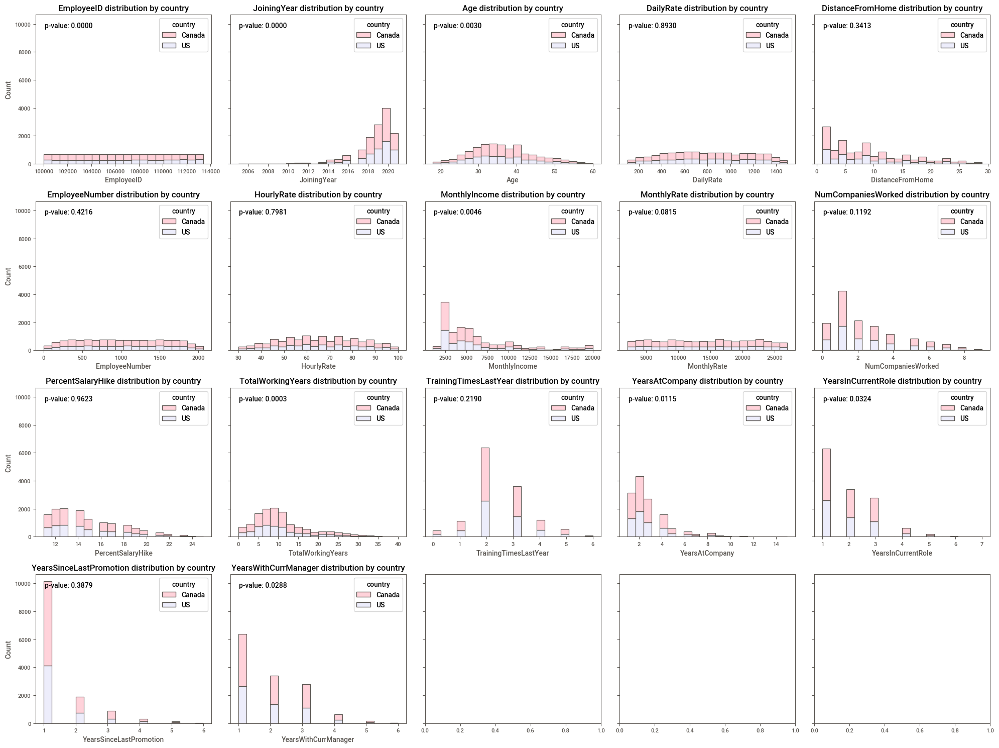

In [ ]:
import warnings
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy import stats

# Filter out warnings
warnings.filterwarnings("ignore", message="The palette list has more values.*")

# Find all columns whose type is numeric (excluding 'category' type)
numeric_variables = ['EmployeeID', 'JoiningYear', 'Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber', 'HourlyRate', 'MonthlyIncome',
                   'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'TotalWorkingYears', 'TrainingTimesLastYear', 'YearsAtCompany',
                   'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']

# Find all columns whose type is 'category'
categorical_variables = df.select_dtypes(include='category').columns.drop(['Over18', 'Reason', 'JobRole'])

# Function to add legend to each subplot
def add_legend(ax, title, colors):
    handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10) for color in colors]
    ax.legend(handles, title.unique(), title=title, loc="upper right")

custom_colors = ["pink", "lavender", "paleturquoise", "mediumaquamarine", "powderblue", "honeydew", "lightcyan", "lavenderblush"]

for chosen_categorical_var in categorical_variables:
    fig, axes = plt.subplots(nrows=len(numeric_variables) // 5 + 1, ncols=5, figsize=(20, 15), sharey=True)
    axes = axes.flatten()
    for i, numeric_var in enumerate(numeric_variables):
        if i < len(axes):
            try:
                if not df[numeric_var].isnull().all() and pd.api.types.is_numeric_dtype(df[numeric_var]):
                    sns.histplot(data=df, x=numeric_var, hue=chosen_categorical_var, multiple="stack", bins=20, alpha=0.7, ax=axes[i], palette=custom_colors)
                    axes[i].set_title(f'{numeric_var} distribution by {chosen_categorical_var}', fontsize=12)
                    kruskal_result = stats.kruskal(*[group[1][numeric_var] for group in df.groupby(chosen_categorical_var)])
                    p_value = kruskal_result.pvalue
                    axes[i].text(0.05, 0.95, f'p-value: {p_value:.4f}', horizontalalignment='left', verticalalignment='top', transform=axes[i].transAxes, fontsize=10)
                    add_legend(axes[i], chosen_categorical_var, df[chosen_categorical_var].unique())
            except Exception as e:
                pass
    plt.tight_layout()
    plt.show()


### Cleaning the data from outliers

This is the treatment method of the outliers:

* If we know the observation is true- we will leave the observation as it was.

* If we know the observation is not true- we will convert it to NA.

* If we don't know if the observation is true, we have to check the change in the correlation and the distribution without the outliers. If the correlation doesn't really change after dropping the outliers but the distribution is changed- we can convert the outliers to NAs, and we need to report this change in the distribution. If the distribution doesn't really change without the outliers, but the correlation is changed- we can convert the outliers to NAs. If the correlation and the distribution changed- we will leave the observations in the model as they were, and report about it.

In this case, we assume that the organization internal information is true and correct. All the data that the employee reports, such as the number of companies he has worked for and distance from his home (based on his address), we do not know if it is real or not. Our assumption about the authenticity of the information within the organization is based, among other things, on the fact that there are no illogical values in the reports from the organization.

The variables we aren't sure that they are real and we want to examine: 'DistanceFromHome', 'MonthlyIncome', 'NumCompaniesWorked', 'TotalWorkingYears'.

We used an Interquartile Range (IQR) to detect which variables have extreme values.

In [ ]:
var_to_detect = df[['DistanceFromHome','NumCompaniesWorked', 'TotalWorkingYears']]
var_to_detect

,DistanceFromHome,NumCompaniesWorked,TotalWorkingYears
0,22,0,39
1,19,0,33
2,2,0,34
3,19,1,35
4,2,6,39
...,...,...,...
13418,9,1,2
13419,6,2,4
13420,5,3,7
13421,14,2,23


In [ ]:
def get_df_without_outliers(df, threshold=1.5):
    df1 = df[['DistanceFromHome','NumCompaniesWorked', 'TotalWorkingYears']]
    Q1 = df1.quantile(0.25)
    Q3 = df1.quantile(0.75)
    IQR = Q3 - Q1
    no_outliers_df = df1[(df1 >= (Q1 - 1.5 * IQR)) & (df1 <= (Q3 + 1.5 * IQR))]
    return no_outliers_df

In [ ]:
var_to_detect_wo = get_df_without_outliers(var_to_detect)
var_to_detect_wo

,DistanceFromHome,NumCompaniesWorked,TotalWorkingYears
0,22.0,0.0,NaN
1,19.0,0.0,NaN
2,2.0,0.0,NaN
3,19.0,1.0,NaN
4,2.0,6.0,NaN
...,...,...,...
13418,9.0,1.0,2.0
13419,6.0,2.0,4.0
13420,5.0,3.0,7.0
13421,14.0,2.0,23.0


In [ ]:
var_to_detect_wo.isna().sum()

DistanceFromHome       29
NumCompaniesWorked     79
TotalWorkingYears     573
dtype: int64

Now we want to see the difference in graphs for each variable that has outliers, among the variables for which we are not sure are authentic.

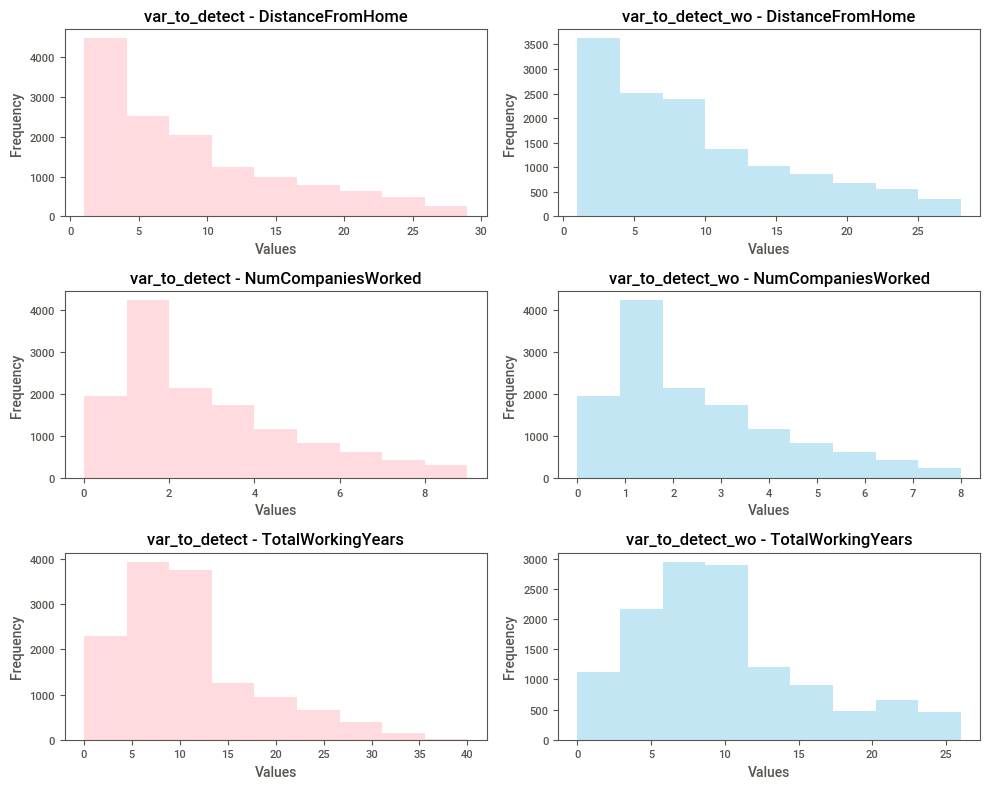

In [ ]:
def compare_variable_histograms_side_by_side(df1, df2, num_bins=9):
    fig, axs = plt.subplots(len(df1.columns), 2, figsize=(10, 8))

    for i, column in enumerate(df1.columns):
        axs[i, 0].hist(df1[column], bins=num_bins, alpha=0.5, color='lightpink')
        axs[i, 0].set_title(f'var_to_detect - {column}')
        axs[i, 0].set_xlabel('Values')
        axs[i, 0].set_ylabel('Frequency')

        axs[i, 1].hist(df2[column], bins=num_bins, alpha=0.5, color='skyblue')
        axs[i, 1].set_title(f'var_to_detect_wo - {column}')
        axs[i, 1].set_xlabel('Values')
        axs[i, 1].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Plot histograms for each variable in both data frames side by side
compare_variable_histograms_side_by_side(var_to_detect, var_to_detect_wo)

### Checking the distribution and the correlation change after dropping the outliers

The following code implements an algorhitm that check if the correlation changes (becomes statistically insignificant) and if the distributions changes significantly. The first is checked using Spearman correlation, while the second is checked using the Kolmogorov Smirnov statistic . This method is non-parametric and check the differences betweem two distributions.

In [ ]:
import numpy as np
from scipy import stats
from scipy.stats import norm

def independent_corr(xy, ab, n, n2=None, twotailed=True, conf_level=0.95, method='fisher'):
    if method == 'fisher':
        xy_z = 0.5 * np.log((1 + xy)/(1 - xy))
        ab_z = 0.5 * np.log((1 + ab)/(1 - ab))
        if n2 is None:
            n2 = n

        se_diff_r = np.sqrt(1/(n - 3) + 1/(n2 - 3))
        diff = xy_z - ab_z
        z = abs(diff / se_diff_r)
        p = (1 - norm.cdf(z))
        if twotailed:
            p *= 2

        return z, p
    elif method == 'zou':
        L1 = xy - 1.96 / np.sqrt(n - 3)
        U1 = xy + 1.96 / np.sqrt(n - 3)
        L2 = ab - 1.96 / np.sqrt(n2 - 3)
        U2 = ab + 1.96 / np.sqrt(n2 - 3)
        lower = xy - ab - pow((pow((xy - L1), 2) + pow((U2 - ab), 2)), 0.5)
        upper = xy - ab + pow((pow((U1 - xy), 2) + pow((ab - L2), 2)), 0.5)
        return lower, upper
    else:
        raise Exception('Wrong method!')

def OutliersRemoveDecisions(df, y_label, threshold=1.5, significant_level=0.05):
    included_numeric = ['DistanceFromHome','NumCompaniesWorked', 'TotalWorkingYears']
    numeric_df = df[included_numeric]
    with_outliers_df = numeric_df
    without_outliers_df = get_df_without_outliers(numeric_df, threshold=1.5)

    distribution_change_df = []

    for name in included_numeric:
        with_outliers_series = with_outliers_df[name]
        without_outliers_series = without_outliers_df[name]


        ks_result = stats.ks_2samp(with_outliers_series, without_outliers_series)

        x_outliers = with_outliers_series
        x_no_outliers = without_outliers_series

        xy = x_outliers.corr(y_label, method='spearman')
        ab = x_no_outliers.corr(y_label, method='spearman')

        n = x_outliers.shape[0]
        n2 = x_no_outliers.shape[0]

        ftz_result = independent_corr(xy, ab, n, n2, method='fisher')
        totout = np.sum(with_outliers_series.count()) - np.sum(without_outliers_series.count())

        distribution_change_df.append(
            {
                'variable': name,
                'outliers_number': '{} ({})'.format(totout, np.round(totout*100/n, 2)),
                'distribution_change': '+' if ks_result[1] < significant_level else '-',
                'correlation_changed': '+' if ftz_result[1] < significant_level else '-',
                'drop': 'no' if (ks_result[1] < significant_level) and (ftz_result[1] < significant_level) else 'yes'
            }
        )

    return pd.DataFrame(distribution_change_df)

In [ ]:
OutliersRemoveDecisions(df[['DistanceFromHome','NumCompaniesWorked', 'TotalWorkingYears']], df.Attrition)

,variable,outliers_number,distribution_change,correlation_changed,drop
0,DistanceFromHome,29 (0.22),-,-,yes
1,NumCompaniesWorked,79 (0.59),-,-,yes
2,TotalWorkingYears,573 (4.27),+,-,yes


We can see here that we can convert the outliers to NAs for all the three variables. It is important to note that a change is made in the distribution after removing the outliers.

Now we will convert the outliers of this 3 variables to NAs, and we will save it in a new df called 'df1'.

In [ ]:
df1 = df.copy()

In [ ]:
def get_df_without_outliers(df, threshold=1.5):
    df2 = df[['DistanceFromHome','NumCompaniesWorked', 'TotalWorkingYears']]
    Q1 = df2.quantile(0.25)
    Q3 = df2.quantile(0.75)
    IQR = Q3 - Q1
    no_outliers_df = df2[(df2 >= (Q1 - 1.5 * IQR)) & (df2 <= (Q3 + 1.5 * IQR))]
    return no_outliers_df

def convert_outliers_to_NA(df, threshold=1.5):
    no_outliers_df = get_df_without_outliers(df, threshold)
    outliers_mask = ~df.isin(no_outliers_df)
    df_with_na = df.mask(outliers_mask)
    return df_with_na

# Applying the function to convert outliers to NaNs for the specified variables
var_to_detect = ['DistanceFromHome', 'NumCompaniesWorked', 'TotalWorkingYears']
df1[var_to_detect] = convert_outliers_to_NA(df1[var_to_detect])

# Displaying the modified DataFrame
df1[['DistanceFromHome', 'NumCompaniesWorked', 'TotalWorkingYears']]

,DistanceFromHome,NumCompaniesWorked,TotalWorkingYears
0,22.0,0.0,NaN
1,19.0,0.0,NaN
2,2.0,0.0,NaN
3,19.0,1.0,NaN
4,2.0,6.0,NaN
...,...,...,...
13418,9.0,1.0,2.0
13419,6.0,2.0,4.0
13420,5.0,3.0,7.0
13421,14.0,2.0,23.0


Checking the conversion was done.

In [ ]:
df.isna().sum()

EmployeeID                      0
JoiningYear                     0
Age                             0
BusinessTravel                  0
DailyRate                       0
DistanceFromHome                0
EducationField                  0
EmployeeCount                   0
EmployeeNumber                  0
EnvironmentSatisfaction         0
Gender                          0
HourlyRate                      0
JobInvolvement                  0
JobSatisfaction                 0
MaritalStatus                   0
MonthlyIncome                   0
MonthlyRate                     0
NumCompaniesWorked              0
Over18                          0
OverTime                        0
PercentSalaryHike               0
PerformanceRating               0
RelationshipSatisfaction        0
StandardHours                   0
StockOptionLevel                0
TotalWorkingYears               0
TrainingTimesLastYear           0
WorkLifeBalance                 0
YearsAtCompany                  0
YearsInCurrent

In [ ]:
df1.isna().sum()

EmployeeID                      0
JoiningYear                     0
Age                             0
BusinessTravel                  0
DailyRate                       0
DistanceFromHome               29
EducationField                  0
EmployeeCount                   0
EmployeeNumber                  0
EnvironmentSatisfaction         0
Gender                          0
HourlyRate                      0
JobInvolvement                  0
JobSatisfaction                 0
MaritalStatus                   0
MonthlyIncome                   0
MonthlyRate                     0
NumCompaniesWorked             79
Over18                          0
OverTime                        0
PercentSalaryHike               0
PerformanceRating               0
RelationshipSatisfaction        0
StandardHours                   0
StockOptionLevel                0
TotalWorkingYears             573
TrainingTimesLastYear           0
WorkLifeBalance                 0
YearsAtCompany                  0
YearsInCurrent

We will countinue the analysis with df1 (the data after converting the outliers from the relevant variables to NAs).

### Missing Values Analysis and Imputation

A table that shows for each variable that has missing values the percentage of missing values out of all the values in the variable.

In [ ]:
# Count the number of missing values for each variable
na_counts = df1.isna().sum()

# Filter out variables with 0 missing values
na_counts_nonzero = na_counts[na_counts != 0]

# Calculate the percentage of missing values for each variable
na_percentages = na_counts_nonzero / df1.shape[0] * 100

# Create a DataFrame with variables and their corresponding NA counts and percentages
result_df = pd.DataFrame({'NA_Count': na_counts_nonzero, 'NA_Percentage': na_percentages})

# Optionally, you can add your condition here to filter further if needed
# For example, you can add a condition to select only variables with a certain threshold of missing values

# Print the result
print(result_df)

                    NA_Count  NA_Percentage
DistanceFromHome          29       0.216047
NumCompaniesWorked        79       0.588542
TotalWorkingYears        573       4.268792
LeavingYear            10225      76.175222
Reason                 10225      76.175222
RelievingStatus        10225      76.175222
rating2017             10892      81.144305
rating2018              9003      67.071445
rating2019              6666      49.661030
rating2020              3161      23.549132
rating2021              1456      10.847054


First, we will drop all the columns that have more than 70% of NAs or have only one value. Additionally, we will drop all the rows that have more than 50% of NAs. All these columns and these rows are uninformative for our ML model.

Dropping the columns that have more than 70% of NAs:

In [ ]:
# Calculate the percentage of missing values for each column
missing_percentages = df1.isna().mean() * 100

# Get the names of columns where missing values exceed 70%
columns_to_drop = missing_percentages[missing_percentages > 70].index

# Drop the columns
df1 = df1.drop(columns=columns_to_drop)

print("Rows dropped indices:", columns_to_drop)

Rows dropped indices: Index(['LeavingYear', 'Reason', 'RelievingStatus', 'rating2017'], dtype='object')


Dropping the rows that have more than 50% of NAs:

In [ ]:
import pandas as pd

# Assuming df1 is your DataFrame

# Calculate the percentage of missing values for each row
missing_percentages = df1.isna().mean(axis=1) * 100

# Get the indices of rows where missing values exceed 50%
rows_to_drop = missing_percentages[missing_percentages > 50].index.tolist()

# Drop the rows
df1_dropped = df1.drop(index=rows_to_drop)

# Now df1_dropped contains the DataFrame with rows dropped where missing values exceed 50%

# List of dropped row indices
print("Rows dropped indices:", rows_to_drop)


Rows dropped indices: []


As we can see here there are no rows with 50% of missingness.

Dropping columns that has only one value:

In [ ]:
# Identify constant columns
constant_columns_list = df1.columns[df1.nunique() == 1].tolist()

# List of dropped constant columns
print("Constant columns dropped:", constant_columns_list)

# Drop constant columns in place
df1.drop(columns=constant_columns_list, inplace=True)


Constant columns dropped: ['EmployeeCount', 'Over18', 'StandardHours']


In [ ]:
df1.shape

(13423, 41)

All the variables that have 40%-69% of NAs, it doesn't matter what the reason for the NAs is, the treatment will be through categorization and adding an "Unknown" variable instead of the missing values.

In [ ]:
# Calculate the percentage of missing values for each variable
missing_percentages = df1.isna().mean() * 100

# Filter variables with missing values falling within the range of 40% to 69%
variables_40_to_69_missing = missing_percentages[(missing_percentages >= 40) & (missing_percentages <= 69)].index.tolist()

# List of variables with missing values falling within the specified range
print("Variables with 40%-69% missing values:", variables_40_to_69_missing)

Variables with 40%-69% missing values: ['rating2018', 'rating2019']


In [ ]:
df1[['rating2018', 'rating2019']].describe()

,rating2018,rating2019
count,4420.000000,6757.000000
mean,8.220475,8.224508
std,1.181187,1.180493
min,3.000000,3.000000
25%,7.500000,7.500000
50%,8.500000,8.500000
75%,9.000000,9.000000
max,10.000000,10.000000


In [ ]:
df1['rating2018_cat'] = np.where(df1['rating2018'].isna(), 'Unknown', np.where(df1['rating2018'] < 7.5,'Low',np.where(df1['rating2018'] >= 9.0,'High','Normal')))
df1['rating2019_cat'] = np.where(df1['rating2019'].isna(), 'Unknown', np.where(df1['rating2019'] < 7.5,'Low',np.where(df1['rating2019'] >= 9.0,'High','Normal')))

Dropping the columns before the change.

In [ ]:
df1 = df1.drop('rating2018',axis=1)
df1 = df1.drop('rating2019',axis=1)

For the rest of the variables that have missing values, we will check the missing mechanism and according to the results we will decide on treatment for each of the variables.

Checking the missing mechanisms: MCAR/MAR/MNAR.

* If the probability of being missing is the same for all cases, then the data is considered to be missing completely at random (MCAR).

* If the probability of being missing is the same only within groups defined by the observed data, then the missing mechanism is missing at random (MAR).

* If neither MCAR nor MAR holds, then we speak of missing not at random (MNAR). In the test we will conduct below we will check if there are any variables that their missing mechanisms is MNAR.

Now, we are going to check the missing mechanisims of the numeric variables. If the imputation == 'no' then the missing mechanism is MNAR, and therefore we can't use imputation for the NAs.

Explaintion of the test: We divided each variable that had NAs into two parts: one part has only non-missing values and a second part that has only missing values. We compared the variable to each of the other numeric variables and checked if there was a significant difference between the distribution of the second variable with and without missing values of the first variable.

For example: the difference in the age variable with and without missing values of the height variable. If there is a significant difference, i.e. the p-value < 0.05, that means that there is no randomness of the missing values and therefore the type of mechanism of the missing values is MNAR.

As a result, we will not be able to use imputation for this variable, and we will have to convert it to a categorical variable with an additional category called "Unknown".

In [ ]:
from scipy import stats

def MissingMechanism(df, significant_level=0.05):
    missing_matt = df.isna()
    numeric_columns_names = df.select_dtypes("number").columns
    distribution_change_df = {}  # pd.DataFrame()
    i = 0
    for numeric_missing_column_name in numeric_columns_names:
        # Check if the current numeric variable has missing values
        if missing_matt[numeric_missing_column_name].any():
            df_without_na = df[missing_matt[numeric_missing_column_name] == 0]
            for numeric_column_name in numeric_columns_names:
                if numeric_missing_column_name != numeric_column_name:
                    series_with_na = df[numeric_column_name]
                    series_without_na = df_without_na[numeric_column_name]
                    ks_result = stats.ks_2samp(series_with_na, series_without_na)
                    distribution_change_df[i] = {
                        'var_1_missing': numeric_missing_column_name,
                        'var_2': numeric_column_name,
                        'missings_number': sum(missing_matt[numeric_missing_column_name]),
                        'distribution_changed': '+' if ks_result[1] < significant_level else '-',
                        'imputation': 'no' if ks_result[1] < significant_level else 'yes'
                    }
                    i += 1

    return pd.DataFrame(distribution_change_df).transpose()

In [ ]:
res = MissingMechanism(df1)
res

,var_1_missing,var_2,missings_number,distribution_changed,imputation
0,DistanceFromHome,EmployeeID,29,-,yes
1,DistanceFromHome,JoiningYear,29,-,yes
2,DistanceFromHome,Age,29,-,yes
3,DistanceFromHome,DailyRate,29,-,yes
4,DistanceFromHome,EmployeeNumber,29,-,yes
...,...,...,...,...,...
85,rating2021,YearsAtCompany,1456,+,no
86,rating2021,YearsInCurrentRole,1456,+,no
87,rating2021,YearsSinceLastPromotion,1456,-,yes
88,rating2021,YearsWithCurrManager,1456,+,no


In [ ]:
res[res.imputation == 'no']

,var_1_missing,var_2,missings_number,distribution_changed,imputation
36,TotalWorkingYears,EmployeeID,573,+,no
37,TotalWorkingYears,JoiningYear,573,+,no
38,TotalWorkingYears,Age,573,+,no
43,TotalWorkingYears,MonthlyIncome,573,+,no
48,TotalWorkingYears,YearsAtCompany,573,+,no
54,rating2020,EmployeeID,3161,+,no
55,rating2020,JoiningYear,3161,+,no
56,rating2020,Age,3161,+,no
61,rating2020,MonthlyIncome,3161,+,no
65,rating2020,TotalWorkingYears,3161,+,no


We can see that the missing mechanism of the variables 'TotalWorkingYears', 'rating2020', 'rating2021' is MNAR (missing not at random). Therefore, the method of handling the missing values in these variables will be categorization and filling in missing values with the "Unknown" value.
It make sense that the missing mechanism of the rating variables is MNAR because if an employee started to work for the company after the rating year or left before the rating year its value will be NA.

For the rest of the variables, we can use KNN algorithm to do imputation for the missing values.

In [ ]:
df1[['TotalWorkingYears','rating2020', 'rating2021']].describe()

,TotalWorkingYears,rating2020,rating2021
count,12850.000000,10262.000000,11967.000000
mean,9.692763,8.199523,8.395922
std,6.032722,1.150108,1.140242
min,0.000000,3.000000,3.000000
25%,5.000000,7.500000,8.000000
50%,9.000000,8.500000,8.500000
75%,13.000000,9.000000,9.500000
max,26.000000,10.000000,10.000000


In [ ]:
df1['TotalWorkingYears_cat'] = np.where(df1['TotalWorkingYears'].isna(), 'Unknown', np.where(df1['TotalWorkingYears'] < 5,'Low',np.where(df1['TotalWorkingYears'] >= 13,'High','Normal')))
df1['rating2020_cat'] = np.where(df1['rating2020'].isna(), 'Unknown', np.where(df1['rating2020'] < 7.5,'Low',np.where(df1['rating2020'] >= 9.0,'High','Normal')))
df1['rating2021_cat'] = np.where(df1['rating2021'].isna(), 'Unknown', np.where(df1['rating2021'] < 8,'Low',np.where(df1['rating2021'] >= 9.5,'High','Normal')))

In [ ]:
cat = ['TotalWorkingYears_cat', 'rating2020_cat', 'rating2021_cat', 'rating2018_cat', 'rating2019_cat']

for c in cat:
  df1[c] = pd.Categorical(df1[c])

In [ ]:
df1[['TotalWorkingYears_cat', 'rating2020_cat', 'rating2021_cat', 'rating2018_cat', 'rating2019_cat']].dtypes

TotalWorkingYears_cat    category
rating2020_cat           category
rating2021_cat           category
rating2018_cat           category
rating2019_cat           category
dtype: object

Dropping the columns before the change.

In [ ]:
df1 = df1.drop('TotalWorkingYears',axis=1)
df1 = df1.drop('rating2020',axis=1)
df1 = df1.drop('rating2021',axis=1)

We will use KNN algorithm to do the imputation for the variables, in order to fill the missing values of the variables 'DistanceFromHome', 'NumCompaniesWorked'. We need the KNN values to be integers for the 'NumCompaniesWorked' variable because they need to fit the original values that are integers.


In [ ]:
from sklearn.impute import KNNImputer

# Assuming df is your original DataFrame
columns_to_impute = ['NumCompaniesWorked', 'DistanceFromHome']

# Create a copy of the columns to be imputed
df3 = df1[columns_to_impute].copy()

# Initialize KNNImputer
imputer = KNNImputer(n_neighbors=3)

# Fit and transform the imputer on the selected columns
imputed_values = imputer.fit_transform(df3)

# Round the imputed values to integers for NumCompaniesWorked
rounded_values = pd.DataFrame(imputed_values, columns=df3.columns).astype({'NumCompaniesWorked': int})

# Update the DataFrame with rounded imputed values
df3[columns_to_impute] = rounded_values

In [ ]:
df1[['NumCompaniesWorked', 'DistanceFromHome']].dtypes

NumCompaniesWorked    float64
DistanceFromHome      float64
dtype: object

In [ ]:
df3.isna().sum()

NumCompaniesWorked    0
DistanceFromHome      0
dtype: int64

We will change df1 to be the data frame after the NA treatment (including imputations) and make sure we don't have any more missing values in the data.

In [ ]:
df1[columns_to_impute] = df3[columns_to_impute]

df1.isna().sum()

EmployeeID                  0
JoiningYear                 0
Age                         0
BusinessTravel              0
DailyRate                   0
DistanceFromHome            0
EducationField              0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StockOptionLevel            0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSinceLastPromotion     0
YearsWithCurrManager        0
Attrition                   0
office_code                 0
Department                  0
JobLevel                    0
JobRole                     0
city      

In [ ]:
df1.shape

(13423, 41)

We will run again the automatic EDA after all the changes in the data frame.

                                             |          | [  0%]   00:00 -> (? left)


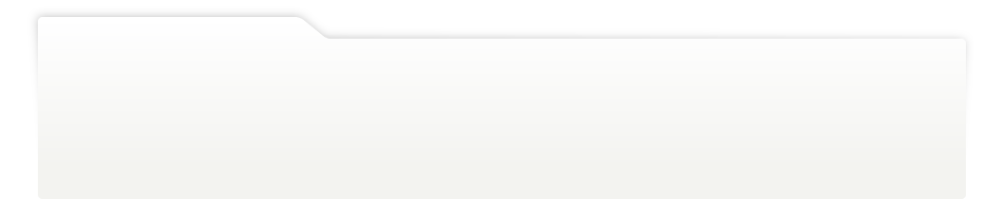
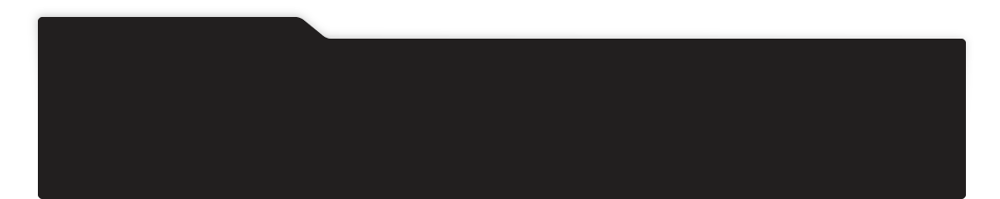
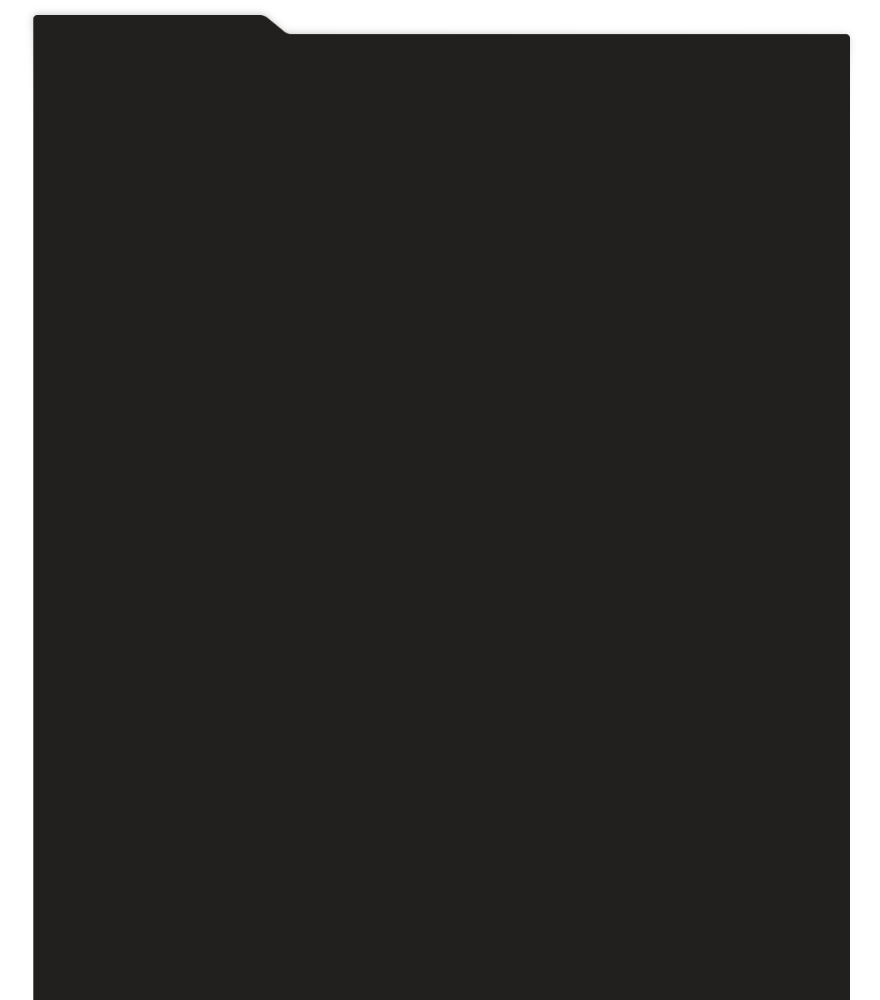
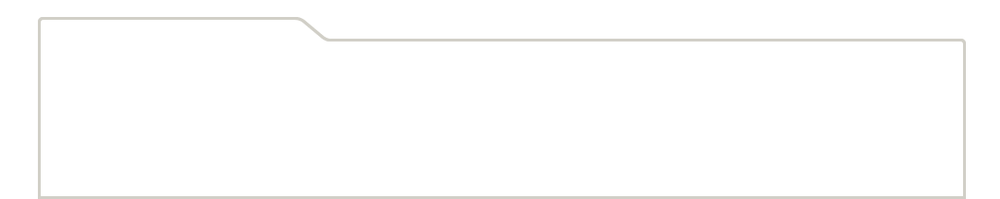
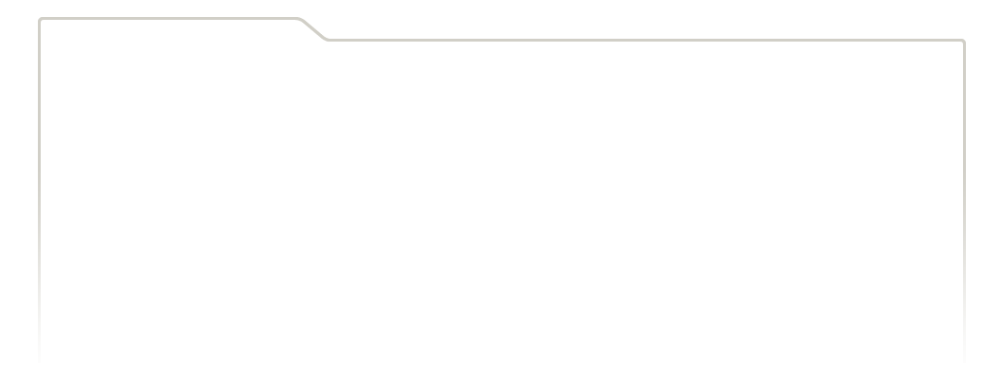
...
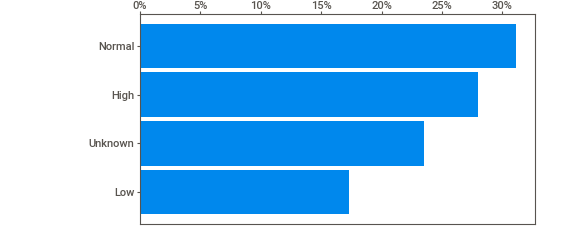
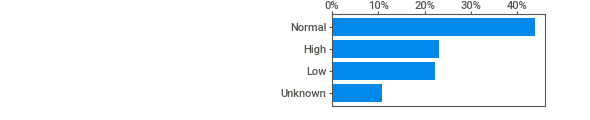
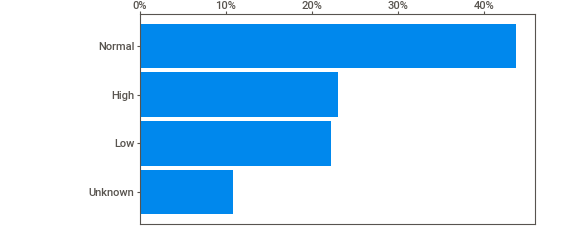
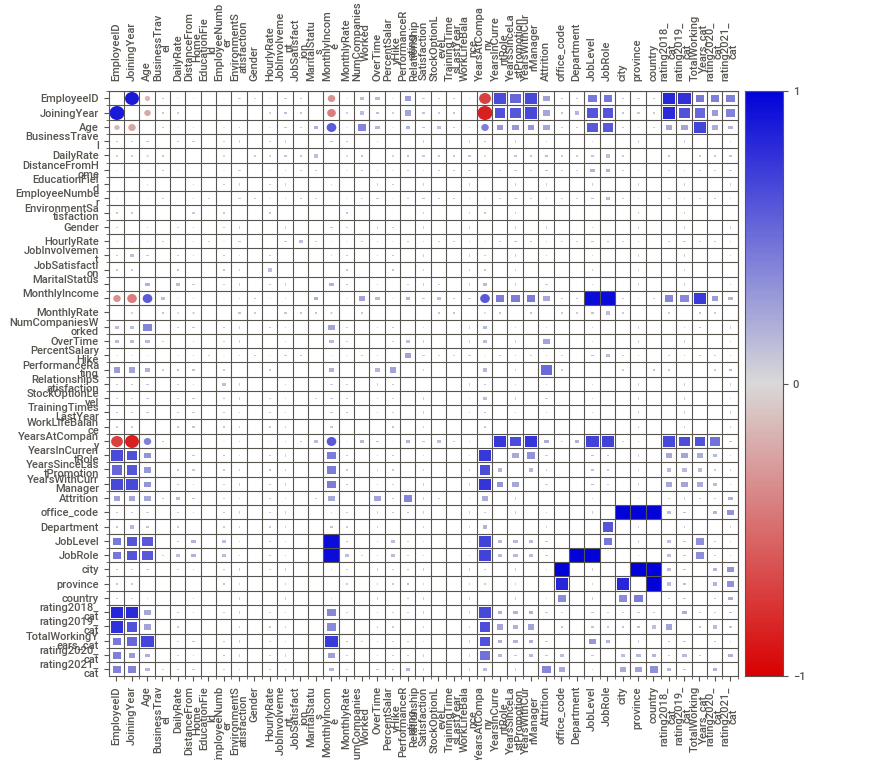
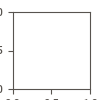

In [ ]:
sweet_report = sv.analyze(df1)
sweet_report.show_notebook()

# Feature manipulation and selection:

### Interactions between numeric-numeric variables:

We will make interaction variables between the numeric variables and themselves using the Spearman correlation matrix. We will drop some of the initial variables by the protocol below.

We will check the Spearman correlation matrix again after all the changes in the data. For all pairs of variables whose absolute value of correlation is above 0.7 we need to drop one of the variables and try to create a new variable that will express the relationship between the variables (such as a subtraction variable between the variables). Couples with a correlation that is higher than 0.9 or above in absolute value, we will remove one of the variables and not create a new variable that will maintain the existing relationship.

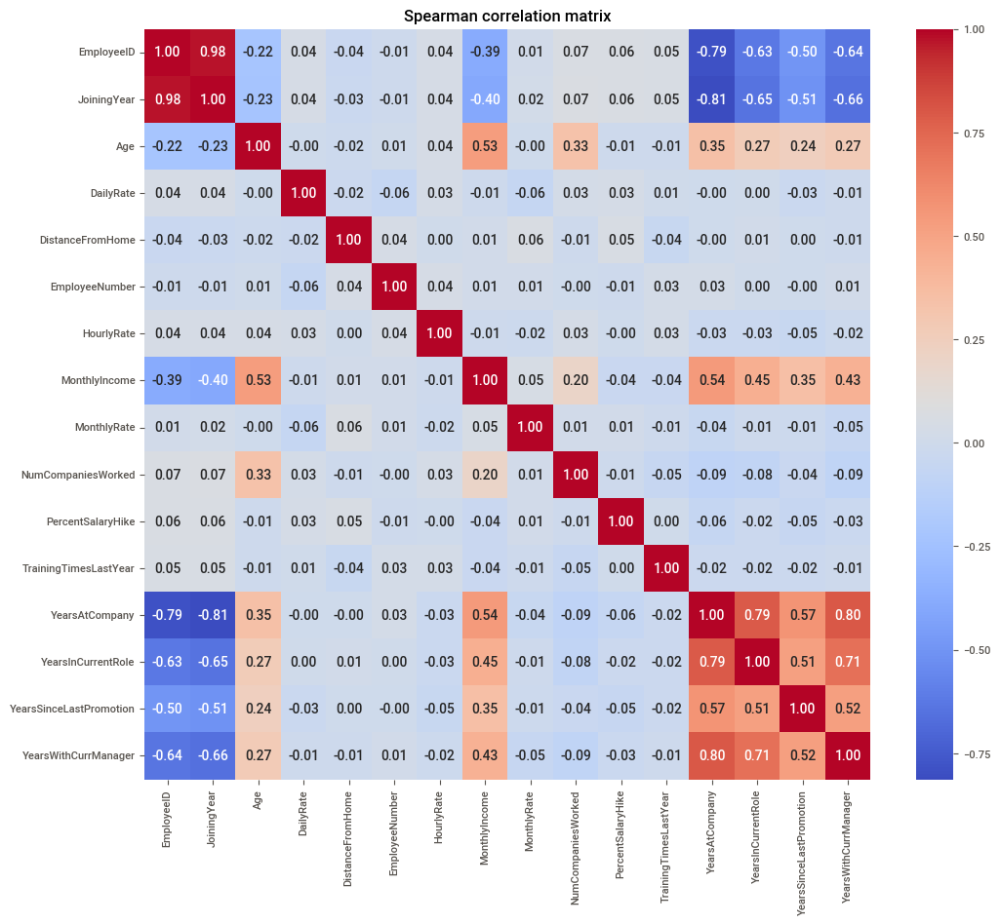

In [ ]:
numeric_columns = df1.select_dtypes(include='number')

# יצירת מטריצת קורלציה
correlation_matrix = numeric_columns.corr(method='spearman')

# השתמשי ב Seaborn ליצירת חום-מפת קורלציה
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Spearman correlation matrix")
plt.show()

In [ ]:
!pip install tabulate
from tabulate import tabulate

We will make a table with the variables that there absolute value of correlation is greater than 0.9, in order to drop one of the columns for each row in the table below.

In [ ]:
high_correlation_pairs = []

# חיפוש במטריצת הקורלציה עבור זוגות עם קורלציה גבוהה מ-0.9
for i in range(len(correlation_matrix.columns)):
    for j in range(i+1, len(correlation_matrix.columns)):
        if abs(correlation_matrix.iloc[i, j]) > 0.9:
            high_correlation_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j]))

# בניית רשימת טאפלטים מהזוגות עם קורלציה גבוהה מ-0.9
table = []
for pair in high_correlation_pairs:
    table.append({'Variable 1': pair[0], 'Variable 2': pair[1], 'Correlation': correlation_matrix.loc[pair[0], pair[1]]})

# הצגת הטאפלטים
print(tabulate(table, headers="keys"))


Variable 1    Variable 2      Correlation
------------  ------------  -------------
EmployeeID    JoiningYear         0.97808


Dropping the 'EmployeeID' column

In [ ]:
df1 = df1.drop('EmployeeID', axis=1)

We will make a table with the variables that there absolute value of correlation is greater than 0.7 (and less than 0.9).

In [ ]:
numeric_columns = df1.select_dtypes(include='number')

# יצירת מטריצת קורלציה
correlation_matrix = numeric_columns.corr(method='spearman')

In [ ]:
high_correlation_pairs = []

# חיפוש במטריצת הקורלציה עבור זוגות עם קורלציה גבוהה מ-0.9
for i in range(len(correlation_matrix.columns)):
    for j in range(i+1, len(correlation_matrix.columns)):
        if abs(correlation_matrix.iloc[i, j]) > 0.7:
            high_correlation_pairs.append((correlation_matrix.columns[i], correlation_matrix.columns[j]))

# בניית רשימת טאפלטים מהזוגות עם קורלציה גבוהה מ-0.9
table = []

for pair in high_correlation_pairs:
    table.append({'Variable 1': pair[0], 'Variable 2': pair[1], 'Correlation': correlation_matrix.loc[pair[0], pair[1]]})

# הצגת הטאפלטים
print(tabulate(table, headers="keys"))

Variable 1          Variable 2              Correlation
------------------  --------------------  -------------
JoiningYear         YearsAtCompany            -0.81272
YearsAtCompany      YearsInCurrentRole         0.791568
YearsAtCompany      YearsWithCurrManager       0.799373
YearsInCurrentRole  YearsWithCurrManager       0.714828


Although the absolute value of the correlation of the variables 'JoiningYear' and 'YearsAtCompany' is 0.81272 and not 0.9 or higher, these variables have a very similar meaning, which may lead to multicollinearity in the model.

The current year - YearsAtCompany = JoiningYear

Because of this, we will remove the variable of the year of 'JoiningYear' and leave the variable 'YearsAtCompany' in the dataframe.

In [ ]:
df1 = df1.drop('JoiningYear', axis=1)

For the pair 'YearsAtCompany' and 'YearsInCurrentRole' we will create a new binary varible 'FirstRoleAtTheCompany' that gets 1 if this is the first role of the employee at the company and 0 otherwise. Then we will drop the variable 'YearsInCurrentRole'.

In [ ]:
df1['FirstRoleAtTheCompany'] = df1.apply(lambda row: 1 if row['YearsAtCompany'] == row['YearsInCurrentRole'] else 0, axis=1)

df1 = df1.drop('YearsInCurrentRole', axis=1)

For the pair 'YearsAtCompany' and 'YearsWithCurrManager' we will create a new binary varible 'SameManagerFromTheBeginning' that gets 1 if the emplyee works under the same manager from his beginning at the company and 0 otherwise. Then we will drop the variable 'YearsWithCurrManager'.

In [ ]:
df1['SameManagerFromTheBeginning'] = df1.apply(lambda row: 1 if row['YearsAtCompany'] == row['YearsWithCurrManager'] else 0, axis=1)

df1 = df1.drop('YearsWithCurrManager', axis=1)

Changning the new variables type to category.

In [ ]:
object_to_cat1 = ['FirstRoleAtTheCompany', 'SameManagerFromTheBeginning']

for col in object_to_cat1:
    df1[col] = pd.Categorical(df1[col])

We will run the correlation matrix again and the table that shows the pairs of variables that have a correlation above 0.7 to make sure that we have handled all the pairs with too high correlation.

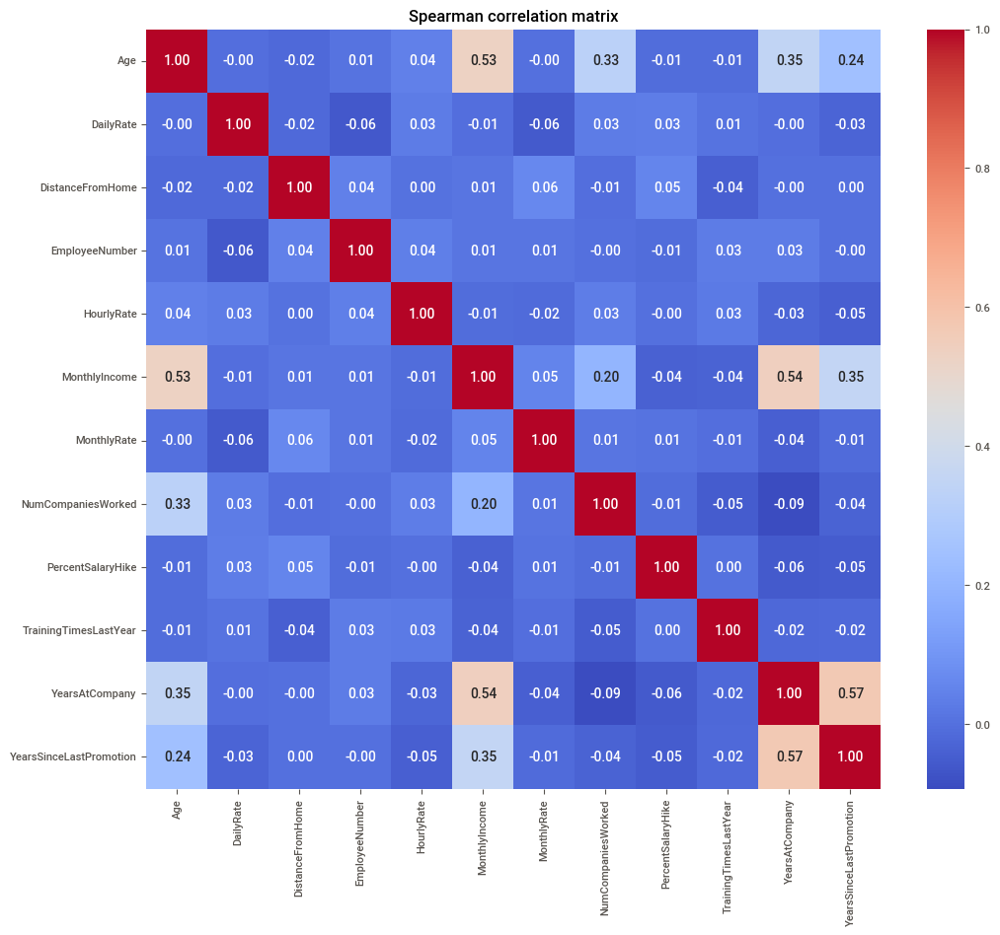

In [ ]:
numeric_columns = df1.select_dtypes(include='number')

# יצירת מטריצת קורלציה
correlation_matrix = numeric_columns.corr(method='spearman')

# השתמשי ב Seaborn ליצירת חום-מפת קורלציה
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Spearman correlation matrix")
plt.show()

We can see that we handled all the pairs with too high correlation (0.7 and above).

Now we will create interaction variables between variables that do not necessarily have a high correlation between them, but a relationship that we want to examine. First, we will convert the categorical variables to dummies/ordinal in order to adjust them to the ML model.

Save the category variables in a new dataframe called 'df1_category'.

In [ ]:
df1_category = df1.select_dtypes(include=['category'])
non_ordered_categories = [col for col in df1_category.columns if not (hasattr(df1_category[col].cat, 'ordered') and df1_category[col].cat.ordered)]
df1_category = df1_category[non_ordered_categories]

df1_category.columns

Index(['BusinessTravel', 'EducationField', 'Gender', 'MaritalStatus',
       'OverTime', 'Attrition', 'office_code', 'Department', 'JobRole', 'city',
       'province', 'country', 'rating2018_cat', 'rating2019_cat',
       'TotalWorkingYears_cat', 'rating2020_cat', 'rating2021_cat',
       'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning'],
      dtype='object')

A function that shows for each categorical varibale the number of the observasions for each category. We use this function in order to decide which method is the best to treat each categorical variable: convert it to dummy/bin encoding.

In [ ]:
def count_categories_and_observations(data):
    results = []
    if isinstance(data, pd.Series):
        variable_name = data.name
        category_counts = data.value_counts()
        for category, count in category_counts.items():
            results.append({'Variable': variable_name,
                            'Category': category,
                            'Observations': count})

    # If data is a DataFrame
    elif isinstance(data, pd.DataFrame):
        for column in data.select_dtypes(include='category'):
            variable_name = column
            category_counts = data[column].value_counts()
            for category, count in category_counts.items():
                results.append({'Variable': variable_name,
                                'Category': category,
                                'Observations': count})

    else:
        raise ValueError("Input data must be either a DataFrame or a Series.")

    return pd.DataFrame(results)

count_categories_and_observations(df1_category)

,Variable,Category,Observations
0,BusinessTravel,Travel_Rarely,11607
1,BusinessTravel,Travel_Frequently,1454
2,BusinessTravel,Non-Travel,362
3,EducationField,Doctorate,3431
4,EducationField,Diploma,3400
...,...,...,...
97,rating2021_cat,Unknown,1456
98,FirstRoleAtTheCompany,0,7216
99,FirstRoleAtTheCompany,1,6207
100,SameManagerFromTheBeginning,0,7425


After examining each categorical variable separately, we decided for each variable its appropriate treatment. Almost all variables will be handled using Dummy encoding, that is, converting the variable to a dummy and removing one of the categories that will be a reference in order to avoid multicollinearity.

The variables that are already dummies:'Attrition', 'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning'. The variables 'JobRole' will be treated using bin encoding so we drop it for now.

In [ ]:
drop_columns = df1_category[['Attrition', 'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning', 'JobRole']]

category_to_dummy = df1_category.drop(columns=drop_columns, errors='ignore')

category_to_dummy.columns

Index(['BusinessTravel', 'EducationField', 'Gender', 'MaritalStatus',
       'OverTime', 'office_code', 'Department', 'city', 'province', 'country',
       'rating2018_cat', 'rating2019_cat', 'TotalWorkingYears_cat',
       'rating2020_cat', 'rating2021_cat'],
      dtype='object')

In [ ]:
category_to_dummy.dtypes

BusinessTravel           category
EducationField           category
Gender                   category
MaritalStatus            category
OverTime                 category
office_code              category
Department               category
city                     category
province                 category
country                  category
rating2018_cat           category
rating2019_cat           category
TotalWorkingYears_cat    category
rating2020_cat           category
rating2021_cat           category
dtype: object

In [ ]:
import pandas as pd

def dummy_encoding(df):
    encoded_df = pd.DataFrame()  # יצירת DataFrame ריק
    for var in df.columns:
        if pd.api.types.is_categorical_dtype(df[var]):
            # המרת משתני קטגוריה למשתני דמי
            dummies = pd.get_dummies(df[var], prefix=var, drop_first=True, dtype="int")  # ציון ה-tipo כ"int" לקידוד 0/1
            encoded_df = pd.concat([encoded_df, dummies], axis=1)  # שרשור העמודות הדמי ל-DataFrame
        else:
            # המרת ערכים בוליאניים (True/False) ל-0/1 ושמירת ה-tipo כקטגוריה
            encoded_df[var] = df[var].astype(int).astype(str).map({'True': '1', 'False': '0'}).astype("category")
    return encoded_df


df1_encoded = dummy_encoding(category_to_dummy)
df1 = pd.concat([df1.drop(columns=category_to_dummy.columns), df1_encoded], axis=1)
df1_encoded


,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,EducationField_Diploma,EducationField_Doctorate,EducationField_Masters,Gender_Male,MaritalStatus_Married,MaritalStatus_Single,OverTime_1,office_code_CAL,...,rating2019_cat_Unknown,TotalWorkingYears_cat_Low,TotalWorkingYears_cat_Normal,TotalWorkingYears_cat_Unknown,rating2020_cat_Low,rating2020_cat_Normal,rating2020_cat_Unknown,rating2021_cat_Low,rating2021_cat_Normal,rating2021_cat_Unknown
0,0,1,0,1,0,1,1,0,1,0,...,0,0,0,1,0,0,1,0,0,1
1,0,1,0,1,0,1,1,0,1,0,...,1,0,0,1,0,0,1,0,0,1
2,0,1,0,1,0,0,1,0,0,0,...,1,0,0,1,0,0,1,0,0,1
3,0,1,1,0,0,1,1,0,1,0,...,0,0,0,1,0,0,1,0,0,1
4,0,1,1,0,0,1,1,0,1,1,...,1,0,0,1,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13418,1,0,1,0,0,0,0,1,0,0,...,1,1,0,0,0,0,1,0,0,0
13419,0,1,0,0,0,0,0,1,1,0,...,1,1,0,0,0,0,1,0,1,0
13420,0,1,1,0,0,0,0,1,0,0,...,1,0,1,0,0,0,1,0,1,0
13421,0,1,0,0,0,1,1,0,0,0,...,1,0,0,0,0,0,1,0,0,0


In [ ]:
df1_encoded.columns

Index(['BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely',
       'EducationField_Diploma', 'EducationField_Doctorate',
       'EducationField_Masters', 'Gender_Male', 'MaritalStatus_Married',
       'MaritalStatus_Single', 'OverTime_1', 'office_code_CAL',
       'office_code_MKM', 'office_code_NYC', 'office_code_OTT',
       'office_code_PHL', 'office_code_TOR', 'office_code_VAN',
       'Department_Delivery', 'Department_HR', 'Department_Marketing',
       'Department_Product', 'Department_Sales', 'city_Calgary',
       'city_Markham', 'city_NewYork', 'city_Ottawa', 'city_Philadelphia',
       'city_Toronto', 'city_Vancouver', 'province_BC', 'province_MA',
       'province_NY', 'province_ON', 'province_PA', 'country_US',
       'rating2018_cat_Low', 'rating2018_cat_Normal', 'rating2018_cat_Unknown',
       'rating2019_cat_Low', 'rating2019_cat_Normal', 'rating2019_cat_Unknown',
       'TotalWorkingYears_cat_Low', 'TotalWorkingYears_cat_Normal',
       'TotalWorkingYea

In [ ]:
object_to_cat = ['BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely', 'EducationField_Diploma', 'EducationField_Doctorate', 'EducationField_Masters', 'Gender_Male', 'MaritalStatus_Married',
       'MaritalStatus_Single', 'OverTime_1', 'office_code_CAL', 'office_code_MKM', 'office_code_NYC', 'office_code_OTT', 'office_code_PHL', 'office_code_TOR', 'office_code_VAN', 'Department_Delivery', 'Department_HR', 'Department_Marketing',
       'Department_Product', 'Department_Sales', 'city_Calgary', 'city_Markham', 'city_NewYork', 'city_Ottawa', 'city_Philadelphia', 'city_Toronto', 'city_Vancouver', 'province_BC', 'province_MA', 'province_NY', 'province_ON', 'province_PA', 'country_US',
       'rating2018_cat_Low', 'rating2018_cat_Normal', 'rating2018_cat_Unknown', 'rating2019_cat_Low', 'rating2019_cat_Normal', 'rating2019_cat_Unknown', 'TotalWorkingYears_cat_Low', 'TotalWorkingYears_cat_Normal',
       'TotalWorkingYears_cat_Unknown', 'rating2020_cat_Low', 'rating2020_cat_Normal', 'rating2020_cat_Unknown', 'rating2021_cat_Low', 'rating2021_cat_Normal', 'rating2021_cat_Unknown']

for col in object_to_cat:
    df1[col] = pd.Categorical(df1[col])

In [ ]:
df1

,Age,DailyRate,DistanceFromHome,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobSatisfaction,MonthlyIncome,MonthlyRate,...,rating2019_cat_Unknown,TotalWorkingYears_cat_Low,TotalWorkingYears_cat_Normal,TotalWorkingYears_cat_Unknown,rating2020_cat_Low,rating2020_cat_Normal,rating2020_cat_Unknown,rating2021_cat_Low,rating2021_cat_Normal,rating2021_cat_Unknown
0,57,164,22.0,217,3,91,3,3,10492,3411,...,0,0,0,1,0,0,1,0,0,1
1,52,265,19.0,519,3,76,3,2,11529,3105,...,1,0,0,1,0,0,1,0,0,1
2,53,607,2.0,1572,3,78,2,4,10169,14618,...,1,0,0,1,0,0,1,0,0,1
3,54,215,19.0,309,3,86,2,4,10314,3834,...,0,0,0,1,0,0,1,0,0,1
4,57,285,2.0,828,3,31,2,2,19255,25762,...,1,0,0,1,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13418,36,1266,9.0,240,3,72,3,3,2244,6261,...,1,1,0,0,0,0,1,0,0,0
13419,31,424,6.0,1919,2,55,3,1,2408,25235,...,1,1,0,0,0,0,1,0,1,0
13420,36,927,5.0,108,3,84,3,2,2384,6796,...,1,0,1,0,0,0,1,0,1,0
13421,58,1200,14.0,1836,1,86,3,2,15796,21641,...,1,0,0,0,0,0,1,0,0,0


Now we will make a bin encoding out of the variable 'jobRole', grouping roles according to common characteristics.


In [ ]:
def create_binary_variable(data, jobRoleWords, newJobRoleCol):
    data[newJobRoleCol] = 0
    for keyword in jobRoleWords:
        mask = data['JobRole'].str.contains(keyword, case=False)
        data.loc[mask, newJobRoleCol] = 1
    # Convert the new column to category type
    data[newJobRoleCol] = data[newJobRoleCol].astype('category')

# Example usage:
create_binary_variable(df1, ['Manager', 'Director', 'Vice President'], 'ManagementRelatedJob')
create_binary_variable(df1, ['HR'], 'HRRelatedJob')
create_binary_variable(df1, ['Product'], 'ProductManagementRelatedJob')
create_binary_variable(df1, ['Sales'], 'SalesRelatedJob')
create_binary_variable(df1, ['Service Delivery'], 'ServiceDeliveryRelatedJob')
create_binary_variable(df1, ['Administrative'], 'AdministrativeRelatedJob')

In [ ]:
df1.drop(columns=['JobRole'], inplace=True)
df1.columns

Index(['Age', 'DailyRate', 'DistanceFromHome', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement',
       'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsSinceLastPromotion', 'Attrition', 'JobLevel',
       'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning',
       'BusinessTravel_Travel_Frequently', 'BusinessTravel_Travel_Rarely',
       'EducationField_Diploma', 'EducationField_Doctorate',
       'EducationField_Masters', 'Gender_Male', 'MaritalStatus_Married',
       'MaritalStatus_Single', 'OverTime_1', 'office_code_CAL',
       'office_code_MKM', 'office_code_NYC', 'office_code_OTT',
       'office_code_PHL', 'office_code_TOR', 'office_code_VAN',
       'Department_Delivery', 'Department_HR', 'Department_Marketing',
       'Department_Product', 

In [ ]:
df1.shape

(13423, 78)

### Interactions between Categorical-Numeric variables

For the new dataset, df1, which has undergone treatment for outliers and missing values, as well as modification where categorical variables were separated into dummy variables, we will perform a Kruskal-Wallis test once again to identify significant categories within the numeric variable.







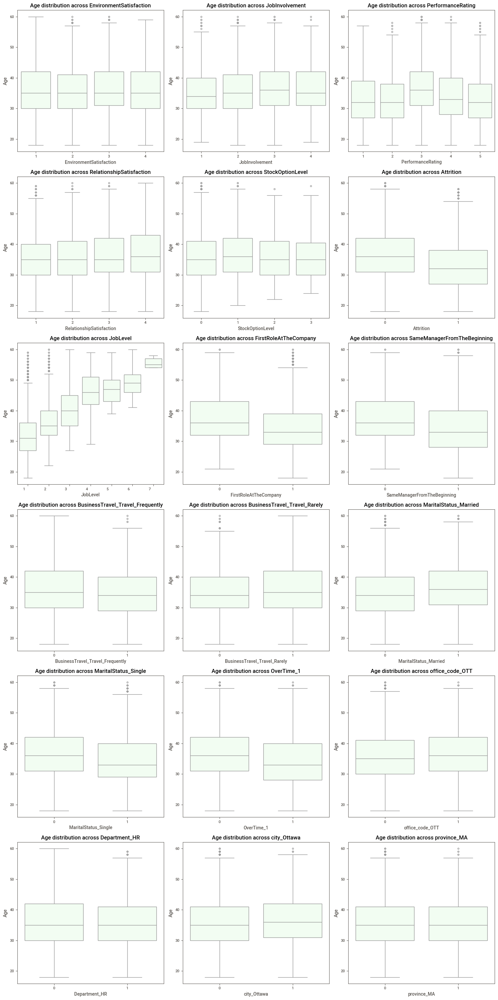

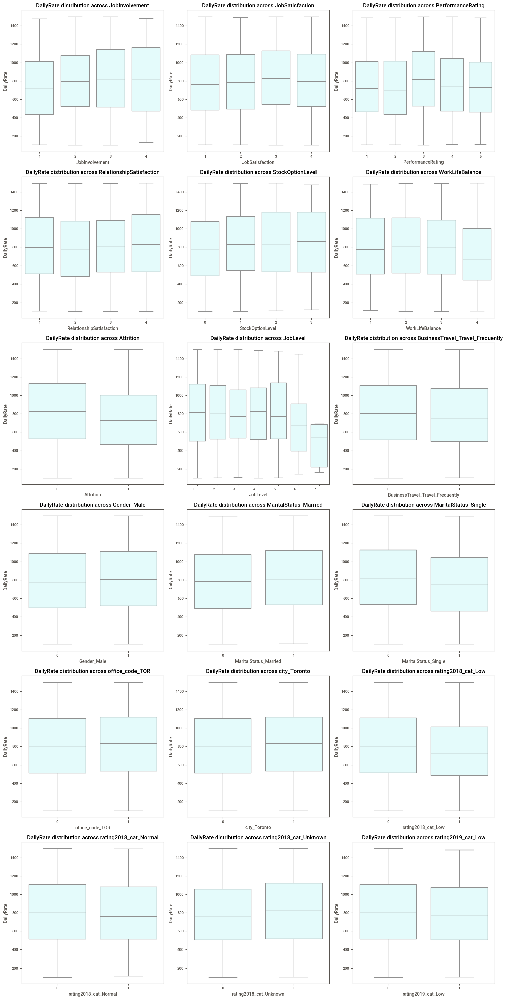

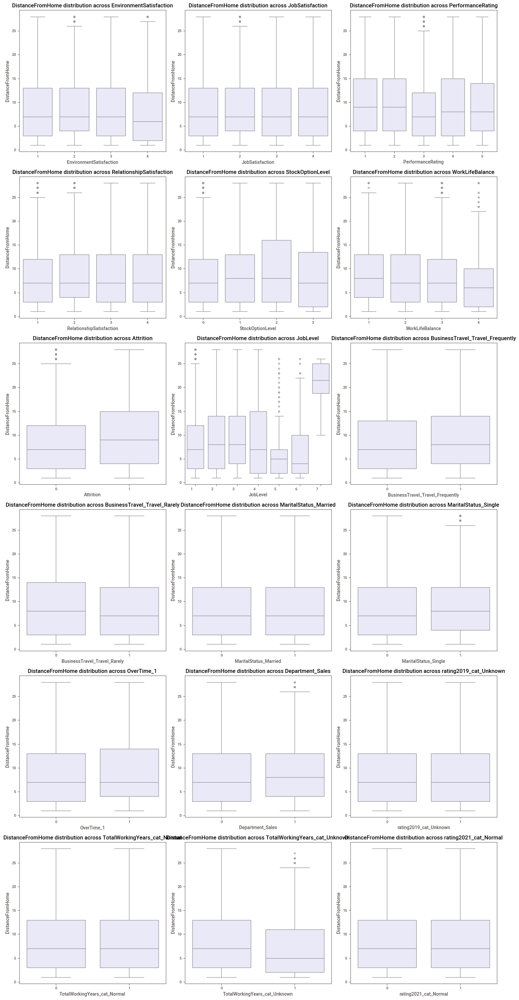

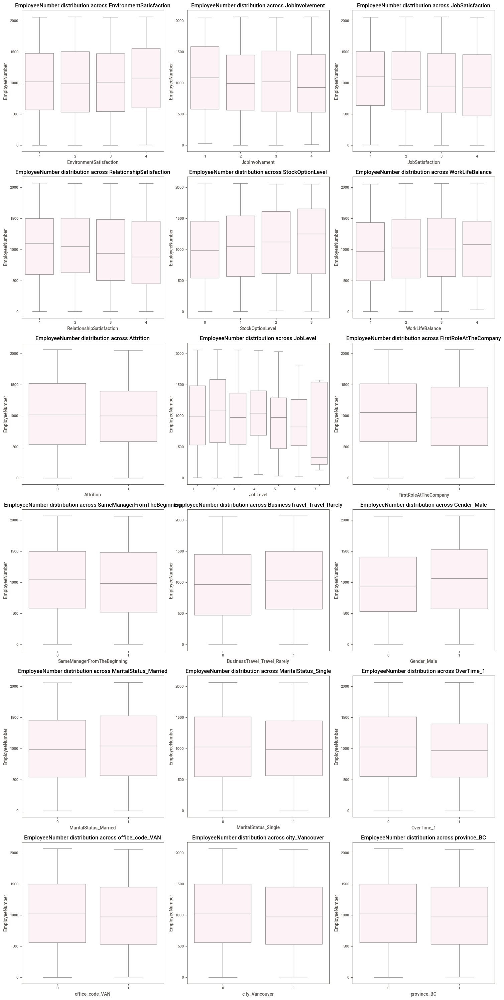

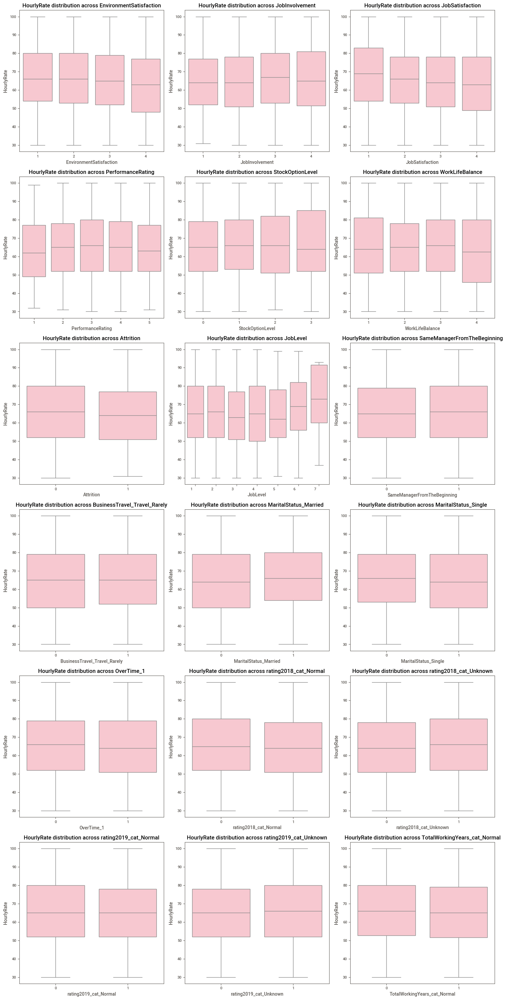

...

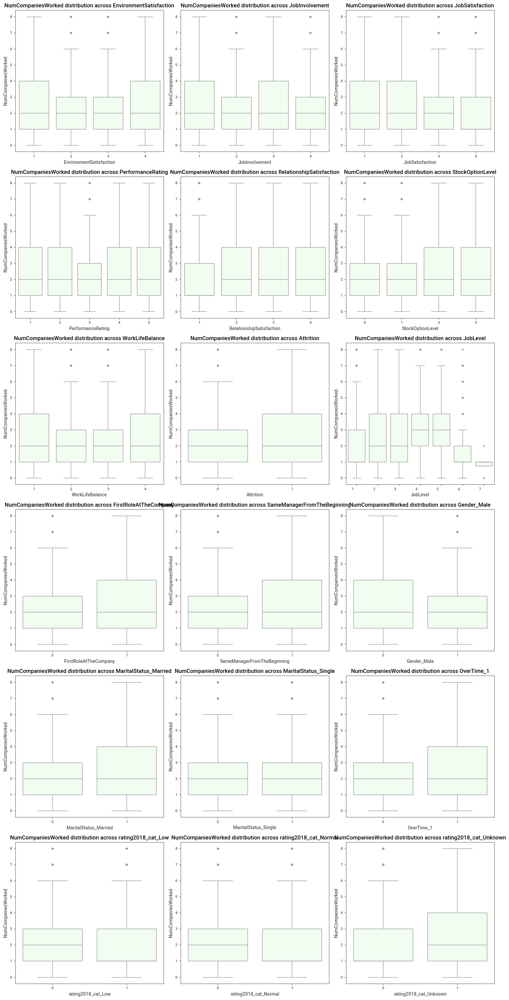

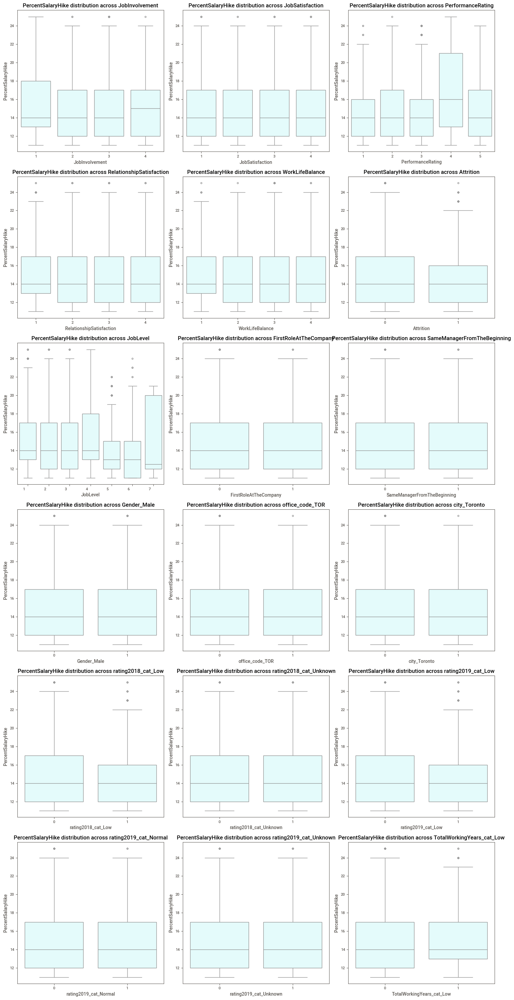

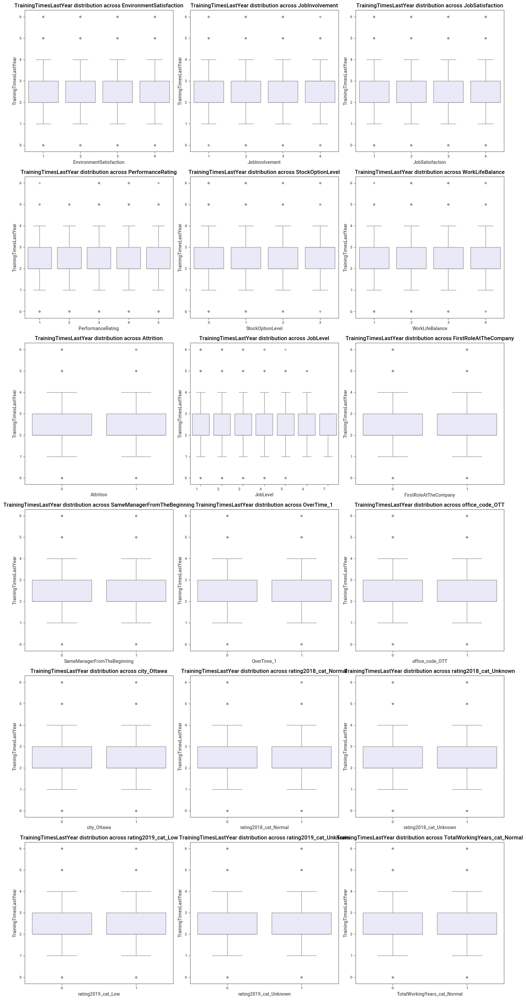

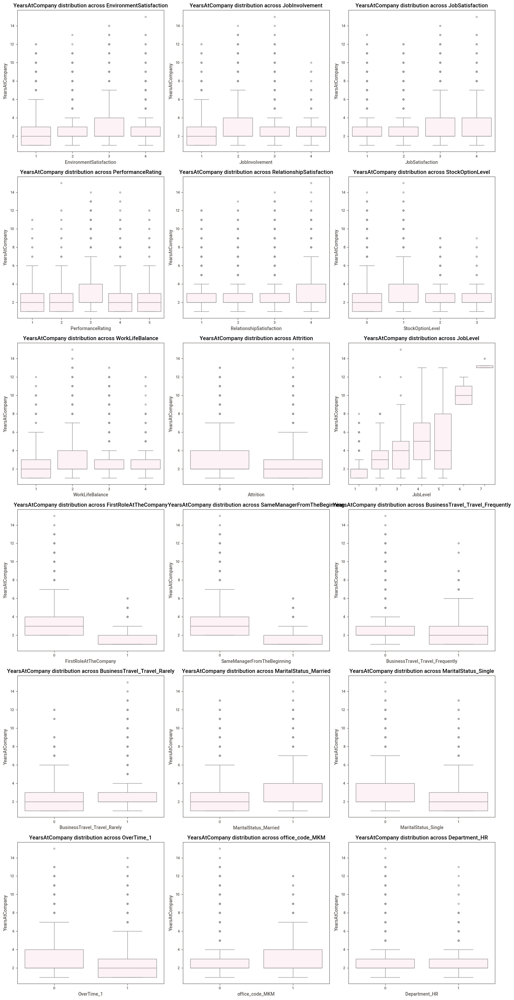

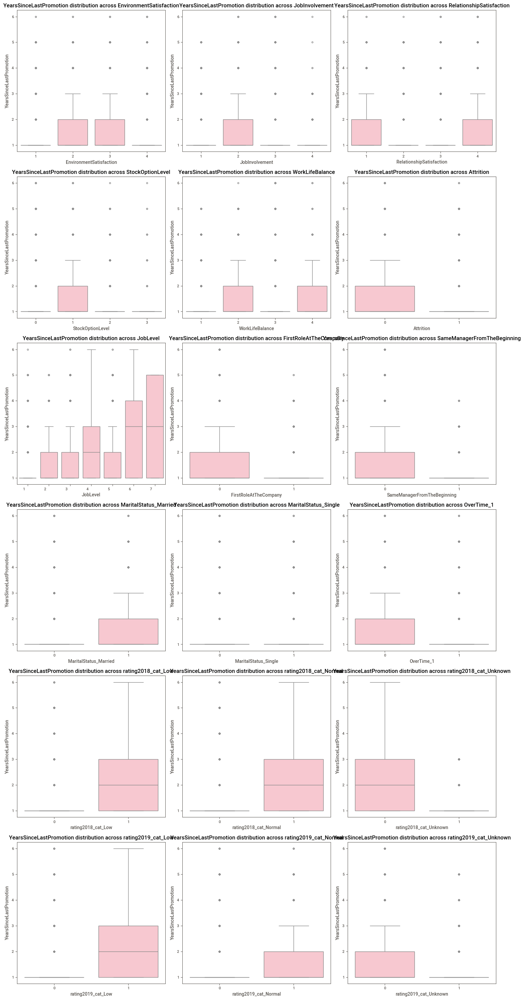

In [ ]:
# Exclude 'JobRole' from categorical variables
categorical_variables = [col for col in df1.select_dtypes(include='category').columns]
numeric_variables = [col for col in df1.select_dtypes(include=['int64', 'float64']).columns]


# Dictionary to store Kruskal-Wallis test results
kruskal_results = {}

# Loop through numeric variables
for numeric_var in numeric_variables:
    kruskal_results[numeric_var] = []

    # Loop through remaining categorical variables (excluding 'JobRole')
    for categorical_var in categorical_variables:
        try:
            # Perform Kruskal-Wallis test
            stat, p = kruskal(*[group[numeric_var] for name, group in df1.groupby(categorical_var)])
            kruskal_results[numeric_var].append((categorical_var, p))
        except Exception as e:
            pass


# Define the number of variables to display in each row
variables_per_row = 3

# Define custom colors for numeric variables
custom_colors = ["honeydew", "lightcyan", "lavender", "lavenderblush", "pink", "paleturquoise", "powderblue"]

# Loop through numeric variables
for i, (numeric_var, results) in enumerate(kruskal_results.items()):
    # Select color for the current numeric variable
    numeric_color = custom_colors[i % len(custom_colors)]

    # Filter out significant results
    significant_results = [(cat_var, p_value) for cat_var, p_value in results if p_value < 0.05]

    # If there are significant results
    if significant_results:
        # Calculate the number of subplots needed
        num_subplots = min(len(significant_results), 18)

        # Calculate the number of rows needed
        num_rows = (num_subplots + variables_per_row - 1) // variables_per_row

        # Create a new figure for each variable
        fig, axes = plt.subplots(num_rows, variables_per_row, figsize=(15, 5*num_rows))

        # Flatten axes for easier indexing
        axes = axes.flatten()

        # Loop through significant results for the current numeric variable
        for j, (cat_var, p_value) in enumerate(significant_results[:num_subplots]):
            sns.boxplot(x=cat_var, y=numeric_var, data=df1, color=numeric_color, ax=axes[j])
            axes[j].set_title(f'{numeric_var} distribution across {cat_var}')

        # Hide empty subplots
        for k in range(num_subplots, len(axes)):
            fig.delaxes(axes[k])

        # Adjust layout
        plt.tight_layout()
        plt.show()


After seeing which of the Categorical variables(new and old) were found to be significant with the Numeric variables through the Kruskal-Wallis Test, we will make new interaction variables out of them.

We will convert the dummy varaibles from (0,1) to (1,2) respectivly (0 to 1 and 1 to 2), in order to make the intercation between categorical and numric variables without lossing any information. If we were multiply the original dummy variable, everything that got 0 in the dummy variable would remain 0 after the multiplication and we would lose information while doing the interaction.

This function will create the interaction, input will be the df, the list of categorical variables that coresponds with the numeric variable, and the numeric variable

In [ ]:
def categorical_numeric_interaction(df, cat_vars, num_var):

    # Create a DataFrame containing the specified columns from df
    cat_var_for_numeric = df[cat_vars].copy()

    # Identify binary columns
    binary_columns = [col for col in cat_var_for_numeric.columns if set(cat_var_for_numeric[col]) == {0, 1}]

    # Replace 0,1 with 1,2 in the binary columns
    for col in binary_columns:
        cat_var_for_numeric.loc[:, col] = cat_var_for_numeric[col].replace(0, 3)

    for col in binary_columns:
        cat_var_for_numeric.loc[:, col] = cat_var_for_numeric[col].replace(1, 2)

    for col in binary_columns:
        cat_var_for_numeric.loc[:, col] = cat_var_for_numeric[col].replace(3, 1)

    # Convert categorical variables to 'int64'
    cat_var_for_numeric = cat_var_for_numeric.astype('int64')

    # Create interactions between the numeric variable and each categorical variable
    for cat_var in cat_var_for_numeric.columns:
        interaction_name = f'{num_var}_{cat_var}'  # Define the name for the interaction variable

        # Create the interaction variable
        df[interaction_name] = df[num_var] * cat_var_for_numeric[cat_var]

    return df


In [ ]:
#AGE
cat_var_for_age=['JobInvolvement', 'PerformanceRating', 'RelationshipSatisfaction',
                       'JobLevel', 'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning',
                       'BusinessTravel_Travel_Frequently', 'MaritalStatus_Married', 'OverTime_1']
#Daily Rate
cat_vars_for_DailyRate = ['JobInvolvement', 'PerformanceRating', 'WorkLifeBalance', 'JobLevel',
    'BusinessTravel_Travel_Rarely', 'MaritalStatus_Married', 'office_code_TOR', 'rating2018_cat_Low', 'Gender_Male']

#Distance From Home
cat_vars_for_DistanceFromHome= ['PerformanceRating', 'StockOptionLevel', 'WorkLifeBalance',  'JobLevel',
    'BusinessTravel_Travel_Frequently', 'MaritalStatus_Single', 'OverTime_1', 'Department_Sales', 'TotalWorkingYears_cat_Unknown']

#Hourly Rate
cat_vars_for_HourlyRate = ['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'PerformanceRating', 'StockOptionLevel',
    'WorkLifeBalance', 'JobLevel', 'MaritalStatus_Married', 'rating2018_cat_Unknown', 'rating2019_cat_Unknown']

#Monthly Income
cat_vars_for_MonthlyIncome = ['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'PerformanceRating', 'StockOptionLevel',
    'WorkLifeBalance', 'JobLevel', 'MaritalStatus_Married', 'rating2018_cat_Unknown', 'rating2019_cat_Unknown']

#Monthly Rate
cat_vars_for_MonthlyRate = ['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'StockOptionLevel', 'JobLevel',
    'FirstRoleAtTheCompany', 'BusinessTravel_Travel_Frequently', 'MaritalStatus_Married', 'Department_HR']

#Num ompanies Worked
cat_vars_for_NumCompaniesWorked = ['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'PerformanceRating', 'RelationshipSatisfaction',
    'StockOptionLevel', 'WorkLifeBalance', 'JobLevel', 'FirstRoleAtTheCompany',
    'SameManagerFromTheBeginning', 'MaritalStatus_Married', 'OverTime_1', 'rating2018_cat_Unknown']

#Percent Salary Hike
cat_vars_for_PercentSalaryHike=['JobInvolvement', 'PerformanceRating', 'RelationshipSatisfaction',
                                'JobLevel', 'TotalWorkingYears_cat_Low']

#Years At Company
cat_vars_for_YearsAtCompany=['EnvironmentSatisfaction', 'JobInvolvement', 'JobSatisfaction', 'PerformanceRating', 'RelationshipSatisfaction',
    'StockOptionLevel', 'WorkLifeBalance',  'JobLevel', 'FirstRoleAtTheCompany',
    'SameManagerFromTheBeginning', 'BusinessTravel_Travel_Frequently', 'MaritalStatus_Married', 'OverTime_1']

 #Years Since Last Promotion
cat_vars_for_YearsSinceLastPromotion=['JobLevel', 'FirstRoleAtTheCompany', 'SameManagerFromTheBeginning',
                                       'MaritalStatus_Married', 'OverTime_1','rating2018_cat_Low',
                                       'rating2018_cat_Normal', 'rating2018_cat_Unknown', 'rating2019_cat_Low',
                                       'rating2019_cat_Normal','rating2019_cat_Unknown']



In [ ]:
interactions = categorical_numeric_interaction(df1, cat_var_for_age, 'Age')
interactions = categorical_numeric_interaction(df1, cat_vars_for_DailyRate, 'DailyRate')
interactions = categorical_numeric_interaction(df1, cat_vars_for_DistanceFromHome, 'DistanceFromHome')
interactions = categorical_numeric_interaction(df1, cat_vars_for_MonthlyRate, 'MonthlyRate')
interactions = categorical_numeric_interaction(df1, cat_vars_for_NumCompaniesWorked, 'NumCompaniesWorked')
interactions = categorical_numeric_interaction(df1, cat_vars_for_PercentSalaryHike, 'PercentSalaryHike')
interactions = categorical_numeric_interaction(df1, cat_vars_for_YearsAtCompany, 'YearsAtCompany')
interactions = categorical_numeric_interaction(df1, cat_vars_for_YearsSinceLastPromotion, 'YearsSinceLastPromotion')

In [ ]:
interaction_toAdd = [col for col in interactions.columns if col not in df1.columns]

# Append the interaction columns to df1
for col in interaction_toAdd:
  df1[col] = interactions[col]

In [ ]:
df1.shape

(13423, 156)

Now we have 156 feaures, and in the next stage we will choose the best features for our model.

# Feature Selection:

First, we will create another copy of the df called 'df2'. 'df2' is the dataframe after the feature engineering that will be our base to the feature selection.

### An explanation of the method we will use to perform the feature selection:
We will use the voting method for 5 different examinations, each one of them performs feature selection for us separately on the variables we have.
4 algorithms are multivariable and one test is univariable. The univariable test checks whether each of the variables is significant against the target variable only, and the multivariable algorithms check the importance of the variable to the model considering the other explanatory variables.
Each test will assign 1 to the variables that are important to the model, and 0 to the variables that are not important to the model. In the end we will get for each variable the sum of the tests that show whether the explanatory variable is important to the model.

In [ ]:
df2 = df1.copy()

In [ ]:
df2.dtypes

Age                                                  int64
DailyRate                                            int64
DistanceFromHome                                   float64
EmployeeNumber                                       int64
EnvironmentSatisfaction                           category
                                                    ...   
YearsSinceLastPromotion_rating2018_cat_Normal        int64
YearsSinceLastPromotion_rating2018_cat_Unknown       int64
YearsSinceLastPromotion_rating2019_cat_Low           int64
YearsSinceLastPromotion_rating2019_cat_Normal        int64
YearsSinceLastPromotion_rating2019_cat_Unknown       int64
Length: 156, dtype: object

### Univariable Analysis

In [ ]:
from scipy.stats import chi2_contingency, mannwhitneyu, spearmanr
import pandas as pd

def check_variable_significance(target, explanatory):
    if explanatory.dtypes == 'category' and explanatory.nunique() > 2:
        # For ordinal variables
        _, p = spearmanr(target, explanatory)
        significance = int(p < 0.05)
    elif explanatory.dtypes == 'category' and explanatory.nunique() == 2:
        # For binary variables
        _, p = mannwhitneyu(target, explanatory)
        significance = int(p < 0.05)
    elif explanatory.dtypes == 'float64':
        _, p = mannwhitneyu(target, explanatory)
        significance = int(p < 0.05)
    else:
        significance = 0

    return significance

explanatory_variables = df2.loc[:, df2.columns != 'Attrition']
target_variable = df2['Attrition']

# Create DataFrame for results
results_df = pd.DataFrame(index=explanatory_variables.columns, columns=['Univariable'])

# Check significance for each explanatory variable and add the result to DataFrame
for column in explanatory_variables.columns:
    univariable = check_variable_significance(target_variable, explanatory_variables[column])
    results_df.at[column, 'Univariable'] = univariable

results_df

,Univariable
Age,0
DailyRate,0
DistanceFromHome,1
EmployeeNumber,0
EnvironmentSatisfaction,1
...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0
YearsSinceLastPromotion_rating2018_cat_Unknown,0
YearsSinceLastPromotion_rating2019_cat_Low,0
YearsSinceLastPromotion_rating2019_cat_Normal,0


In [ ]:
results_df['Univariable'].value_counts()

Univariable
0    82
1    73
Name: count, dtype: int64

### Multivariable Analysis

In [ ]:
X = df2.drop(labels='Attrition', axis=1)

# שמירת העמודה 'Attrition' במשתנה y
y = pd.DataFrame(df2['Attrition'])

# הדפסת המימדים של X ו-y
print(f"Shape of X: {X.shape}, Shape of y: {y.shape}")

Shape of X: (13423, 155), Shape of y: (13423, 1)


### LASSO (L1 penalization)

In [ ]:
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel

lassomod = Lasso(alpha=0.01,random_state=2).fit(X, y)

In [ ]:
model = SelectFromModel(lassomod, prefit=True)
model.get_support()

array([ True,  True, False, False, False,  True, False,  True, False,
       False, False, False, False, False, False,  True, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False,  True, False, False,  True, False,
       False, False, False, False, False,  True,  True,  True, False,
       False, False, False, False, False,  True,  True,  True,  True,
        True,  True,  True,  True,  True, False, False, False, False,
       False,  True,  True,  True, False,  True, False,  True,  True,
        True,  True,  True, False,  True, False, False, False, False,
       False, False, False, False, False,  True, False, False,  True,
        True, False, False, False,  True,  True,  True,  True,  True,
       False, False,

In [ ]:
results_df['Lasso'] = model.get_support().astype('int64')
results_df

,Univariable,Lasso
Age,0,1
DailyRate,0,1
DistanceFromHome,1,0
EmployeeNumber,0,0
EnvironmentSatisfaction,1,0
...,...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0,1
YearsSinceLastPromotion_rating2018_cat_Unknown,0,0
YearsSinceLastPromotion_rating2019_cat_Low,0,0
YearsSinceLastPromotion_rating2019_cat_Normal,0,0


In [ ]:
results_df['Lasso'].value_counts()

Lasso
0    106
1     49
Name: count, dtype: int64

### Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfmod = RandomForestClassifier(random_state=2).fit(X, y)


<ipython-input-100-e322f0b6b915>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rfmod = RandomForestClassifier(random_state=2).fit(X, y)


In [ ]:
model = SelectFromModel(rfmod, prefit=True)
model.get_support()

array([False, False, False, False, False, False, False, False,  True,
       False, False,  True,  True, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False, False, False,
       False, False, False, False,  True, False,  True,  True, False,
       False, False, False, False, False,  True,  True, False,  True,
       False, False, False,  True,  True, False,  True, False, False,
       False, False, False, False, False,  True, False, False, False,
       False, False,  True, False, False, False, False, False, False,
        True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True,  True,

In [ ]:
results_df['RandomForest'] = model.get_support().astype('int64')
results_df

,Univariable,Lasso,RandomForest
Age,0,1,0
DailyRate,0,1,0
DistanceFromHome,1,0,0
EmployeeNumber,0,0,0
EnvironmentSatisfaction,1,0,0
...,...,...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0,1,0
YearsSinceLastPromotion_rating2018_cat_Unknown,0,0,1
YearsSinceLastPromotion_rating2019_cat_Low,0,0,0
YearsSinceLastPromotion_rating2019_cat_Normal,0,0,0


In [ ]:
results_df['RandomForest'].value_counts()

RandomForest
0    122
1     33
Name: count, dtype: int64

### Gradient Boosting

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
#from sklearn.feature_selection import SelectFromModel

gbmod = GradientBoostingClassifier(random_state=2).fit(X, y)

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [ ]:
model = SelectFromModel(gbmod, prefit=True)
model.get_support()

array([False, False, False, False, False, False, False, False, False,
       False, False,  True,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False,  True, False, False,  True, False,
       False, False, False, False, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [ ]:
results_df['GradientBoost'] = model.get_support().astype('int64')
results_df

,Univariable,Lasso,RandomForest,GradientBoost
Age,0,1,0,0
DailyRate,0,1,0,0
DistanceFromHome,1,0,0,0
EmployeeNumber,0,0,0,0
EnvironmentSatisfaction,1,0,0,0
...,...,...,...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0,1,0,0
YearsSinceLastPromotion_rating2018_cat_Unknown,0,0,1,0
YearsSinceLastPromotion_rating2019_cat_Low,0,0,0,0
YearsSinceLastPromotion_rating2019_cat_Normal,0,0,0,0


In [ ]:
results_df['GradientBoost'].value_counts()

GradientBoost
0    148
1      7
Name: count, dtype: int64

### Recursive Feature Elimination (RFE)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
import numpy as np

# Convert y to a 1-dimensional array
y_array = np.ravel(y)

# Create the Random Forest classifier
rf_clf = RandomForestClassifier(random_state=2)

# Fit the Random Forest classifier
rf_clf.fit(X, y_array)

# Create a feature selector based on the fitted Random Forest classifier
model = SelectFromModel(rf_clf, prefit=True)

# Get the selected features
selected_features = model.get_support()

In [ ]:
results_df['RFE'] = model.get_support().astype('int64')
results_df

,Univariable,Lasso,RandomForest,GradientBoost,RFE
Age,0,1,0,0,0
DailyRate,0,1,0,0,0
DistanceFromHome,1,0,0,0,0
EmployeeNumber,0,0,0,0,0
EnvironmentSatisfaction,1,0,0,0,0
...,...,...,...,...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0,1,0,0,0
YearsSinceLastPromotion_rating2018_cat_Unknown,0,0,1,0,1
YearsSinceLastPromotion_rating2019_cat_Low,0,0,0,0,0
YearsSinceLastPromotion_rating2019_cat_Normal,0,0,0,0,0


### Summarization and Selection of Variables

In [ ]:
results_df['Sum'] =  np.sum(results_df,axis=1)
results_df

,Univariable,Lasso,RandomForest,GradientBoost,RFE,Sum
Age,0,1,0,0,0,1
DailyRate,0,1,0,0,0,1
DistanceFromHome,1,0,0,0,0,1
EmployeeNumber,0,0,0,0,0,0
EnvironmentSatisfaction,1,0,0,0,0,1
...,...,...,...,...,...,...
YearsSinceLastPromotion_rating2018_cat_Normal,0,1,0,0,0,1
YearsSinceLastPromotion_rating2018_cat_Unknown,0,0,1,0,1,2
YearsSinceLastPromotion_rating2019_cat_Low,0,0,0,0,0,0
YearsSinceLastPromotion_rating2019_cat_Normal,0,0,0,0,0,0


Counting the number of variables for each 'Sum'. For example, we can see below that only 1 variable has 'Sum' = 5. That means, all the algorithms voted that these variable is significant to the model.

In [ ]:
results_df['Sum'].value_counts()

Sum
1    79
0    34
2    19
3    15
4     7
5     1
Name: count, dtype: int64

Saving all the variables that their sum is equal or higher than 2 in a list.

In [ ]:
selected_features = results_df[results_df['Sum'] >= 2]
selected_features_list = selected_features.index.tolist()
print(selected_features_list)

['JobSatisfaction', 'MonthlyIncome', 'PercentSalaryHike', 'PerformanceRating', 'YearsAtCompany', 'OverTime_1', 'country_US', 'rating2018_cat_Unknown', 'rating2019_cat_Unknown', 'rating2020_cat_Unknown', 'rating2021_cat_Low', 'rating2021_cat_Normal', 'rating2021_cat_Unknown', 'Age_JobInvolvement', 'Age_PerformanceRating', 'Age_JobLevel', 'Age_MaritalStatus_Married', 'Age_OverTime_1', 'DailyRate_PerformanceRating', 'DistanceFromHome_PerformanceRating', 'DistanceFromHome_WorkLifeBalance', 'DistanceFromHome_JobLevel', 'DistanceFromHome_BusinessTravel_Travel_Frequently', 'DistanceFromHome_MaritalStatus_Single', 'DistanceFromHome_OverTime_1', 'DistanceFromHome_TotalWorkingYears_cat_Unknown', 'MonthlyRate_JobLevel', 'PercentSalaryHike_JobInvolvement', 'PercentSalaryHike_PerformanceRating', 'PercentSalaryHike_JobLevel', 'PercentSalaryHike_TotalWorkingYears_cat_Low', 'YearsAtCompany_EnvironmentSatisfaction', 'YearsAtCompany_JobInvolvement', 'YearsAtCompany_JobSatisfaction', 'YearsAtCompany_Perf

A new dataframe called 'df3' that takes the chosen variables after the feature selection, with the target variable 'Attrition'. 'df3' is our final dataframe, and we will use it from now on.

In [ ]:
df3 = df2[selected_features_list]
df3['Attrition'] = df2['Attrition']
df3

<ipython-input-113-8ee4038056a7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3['Attrition'] = df2['Attrition']


,JobSatisfaction,MonthlyIncome,PercentSalaryHike,PerformanceRating,YearsAtCompany,OverTime_1,country_US,rating2018_cat_Unknown,rating2019_cat_Unknown,rating2020_cat_Unknown,...,YearsAtCompany_JobSatisfaction,YearsAtCompany_PerformanceRating,YearsAtCompany_RelationshipSatisfaction,YearsAtCompany_WorkLifeBalance,YearsAtCompany_JobLevel,YearsAtCompany_MaritalStatus_Married,YearsAtCompany_OverTime_1,YearsSinceLastPromotion_OverTime_1,YearsSinceLastPromotion_rating2018_cat_Unknown,Attrition
0,3,10492,12,4,14,1,1,0,0,1,...,42,56,42,28,98,28,28,10,5,1
1,2,11529,12,3,12,1,1,0,1,1,...,24,36,36,24,72,24,24,10,5,1
2,4,10169,16,4,12,0,0,0,1,1,...,48,48,24,36,72,24,12,1,1,1
3,4,10314,11,3,13,1,1,0,0,1,...,52,39,39,26,91,26,26,10,5,1
4,2,19255,12,4,11,1,0,0,1,1,...,22,44,44,33,55,22,22,10,5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13418,3,2244,12,3,1,0,0,1,1,1,...,3,3,3,2,1,1,1,1,2,0
13419,1,2408,11,3,1,1,0,1,1,1,...,1,3,3,2,1,1,2,2,2,0
13420,2,2384,15,3,1,0,0,1,1,1,...,2,3,4,3,1,1,1,1,2,0
13421,2,15796,14,3,1,0,0,1,1,1,...,2,3,2,2,4,2,1,1,2,0


Calculating the percentage of each value of the variable 'Attrition'. We will consider data as imbalanced when the value 1 of the target variable is less than 15%. Since the value 1 of the target variable is 23.82%, we can consider this data as a balanced data and we will treat it accordingly.

In [ ]:
df3['Attrition'].value_counts()/df3['Attrition'].shape[0]

Attrition
0    0.761752
1    0.238248
Name: count, dtype: float64

# Running classification models

In [ ]:
import sklearn.metrics as metrics
from sklearn.model_selection import train_test_split

Defining X as all the variables without Attrition and y as Attrition.

In [ ]:
X = df3.loc[:,df3.columns != 'Attrition']
y = df3['Attrition']

# הדפסת המימדים של X ו-y
print(f"Shape of X: {X.shape}, Shape of y: {y.shape}")

Shape of X: (13423, 42), Shape of y: (13423,)


First, we will split the dataframe into 2 groups- 'train', 'test'. After the division we will split the train data into 2 groups called 'train' and 'dev'. We will use *random_state* to set fix the random distribution of the data and we use *stratify=y* so that the distribution between 0,1 of the target variable is balanced for the training group and the test group.

In [ ]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X,y, test_size=0.2, random_state=10, stratify=y)

In [ ]:
print('X-train',Xtrain.shape)
print('y-train',ytrain.shape)
print('X-test',Xtest.shape)
print('y-test',ytest.shape)

X-train (10738, 42)
y-train (10738,)
X-test (2685, 42)
y-test (2685,)


Now we will split the train data into groups 'train' and 'dev' in the exact same way we did for 'train' and 'test'.

In [ ]:
X_train_train, X_train_dev, y_train_train, y_train_dev = train_test_split(Xtrain, ytrain, test_size=0.2, random_state=10, stratify=ytrain)

In [ ]:
print('X-train',X_train_train.shape)
print('y-train',y_train_train.shape)
print('X-dev',X_train_dev.shape)
print('y-dev',y_train_dev.shape)

X-train (8590, 42)
y-train (8590,)
X-dev (2148, 42)
y-dev (2148,)


## Supervised Models

Importing all the supervised models libraries

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

We will use 2 of the classification metrics- precision and log-loss. If the values of the target variable were more balanced, the accuracy was a good choise, but since the value 1 of the target variable consists 23% of the values in the variable, we want to use the precision and the log-loss metrics.

Precision measures the accuracy of positive predictions made by a model, calculated as the ratio of true positive predictions to the sum of true positive and false positive predictions.

Log-Loss quantifies the accuracy of a classification model by measuring the logarithm of the likelihood of the predicted probabilities assigned to the true labels.

For our binary classification model, the precision is more important mereic than the log-loss.

In [ ]:
def classificationMetrics(y, yhat):
    res = {'Precision': metrics.precision_score(y, yhat),
           'Log-loss': metrics.log_loss(y, yhat)}
    return res

models_list = pd.DataFrame()

In [ ]:
X_train_dev = X_train_dev.astype(float)

### Logistic Regression

In [ ]:
mod1 = LogisticRegression(random_state=1, max_iter=10000)
mod1.fit(X_train_train,y_train_train)

y_pred1 = mod1.predict(X_train_dev)

classificationMetrics(y_train_dev, y_pred1)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


{'Precision': 0.8613636363636363, 'Log-loss': 3.255339272573896}

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Logistic Regression"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred1)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred1, rownames=['Actual'], colnames=['Predicted'])


Predicted,0,1
Actual,,
0,1575,61
1,133,379


### Desicion Tree classifier

In [ ]:
mod2 = DecisionTreeClassifier(random_state=1)
mod2.fit(X_train_train, y_train_train)

y_pred2 = mod2.predict(X_train_dev)

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Decision Tree"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred2)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred2, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,1608,28
1,32,480


### Random Forest

In [ ]:
mod3 = RandomForestClassifier(random_state=1)
mod3.fit(X_train_train, y_train_train)

y_pred3 = mod3.predict(X_train_dev)

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Random Forest"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred3)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred3, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,1633,3
1,31,481


### Gradient Boosting Machine (GBM)

In [ ]:
mod4 = GradientBoostingClassifier(random_state=1)
mod4.fit(X_train_train, y_train_train)

y_pred4 = mod4.predict(X_train_dev)

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "GBM"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred4)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred4, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,1636,0
1,30,482


### Support Vector Machine (SVM)

In [ ]:
mod5 = SVC(probability=True, random_state=1)
mod5.fit(X_train_train, y_train_train)

y_pred5 = mod5.predict(X_train_dev)

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "SVM"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred5)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred5, rownames=['Actual'], colnames=['Predicted'])

Predicted,0
Actual,
0,1636
1,512


The SVM results doesn't fit to our problem.

### K-Nearest Neighbors Classifier (KNN)

In [ ]:
mod6 = KNeighborsClassifier()
mod6.fit(X_train_train, y_train_train)

y_pred6 = mod6.predict(X_train_dev)

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "KNN"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred6)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245


In [ ]:
pd.crosstab(index=y_train_dev, columns=y_pred6, rownames=['Actual'], colnames=['Predicted'])

Predicted,0,1
Actual,,
0,1579,57
1,192,320


In [ ]:
models_list.sort_values('Precision', ascending=False)

,model,Precision,Log-loss
3,GBM,1.000000,0.503403
2,Random Forest,0.993802,0.570523
1,Decision Tree,0.944882,1.006806
0,Logistic Regression,0.861364,3.255339
5,KNN,0.848806,4.178245
4,SVM,0.000000,8.591411


The best model for our problem is GBM. We would like to know the feature importance for this model. In other words, a list of the features from the most important one to the model, to the least important one by percentage, in descending order.

In [ ]:
mod4.feature_importances_

array([8.01622675e-04, 4.24372781e-03, 3.44536389e-02, 4.30992072e-01,
       2.75054009e-03, 7.63950298e-02, 6.31386157e-03, 8.70808045e-04,
       2.71203383e-03, 6.67466772e-03, 8.80682476e-04, 6.04898907e-04,
       3.85191623e-01, 3.81093393e-03, 2.61647039e-03, 1.31366708e-02,
       2.21030639e-04, 7.80872069e-04, 4.12276919e-04, 8.37821385e-06,
       1.15801965e-04, 1.79321017e-04, 5.05664537e-04, 2.36759636e-03,
       1.05522140e-03, 0.00000000e+00, 1.96033821e-03, 4.83523599e-04,
       5.12549221e-04, 3.78762533e-04, 0.00000000e+00, 1.96026402e-03,
       1.45439922e-05, 4.08960978e-03, 9.21017535e-03, 8.14836901e-04,
       1.71037855e-04, 1.17000226e-04, 7.85487328e-04, 9.11377320e-04,
       2.98795427e-04, 1.96253352e-04])

In [ ]:
pd.Series(mod4.feature_importances_, index=mod4.feature_names_in_).sort_values(ascending=False)

PerformanceRating                                    0.430992
rating2021_cat_Unknown                               0.385192
OverTime_1                                           0.076395
PercentSalaryHike                                    0.034454
Age_JobLevel                                         0.013137
YearsAtCompany_PerformanceRating                     0.009210
rating2020_cat_Unknown                               0.006675
country_US                                           0.006314
MonthlyIncome                                        0.004244
YearsAtCompany_JobSatisfaction                       0.004090
Age_JobInvolvement                                   0.003811
YearsAtCompany                                       0.002751
rating2019_cat_Unknown                               0.002712
Age_PerformanceRating                                0.002616
DistanceFromHome_MaritalStatus_Single                0.002368
MonthlyRate_JobLevel                                 0.001960
YearsAtC

We can see that the variables 'PerformanceRating', 'rating2021_cat_Unknown', 'OverTime_1' takes about 88% of the feature importance. So, even with a simple model we can get a very good results. In addition, since our target variable is relatively balanced, it make our prediction much more easier. So we accpect to get very good results at the end of the proccess.

# Hyperparameter Fine-tuning

Since the models Random Forest and GradientBoostingClassifier (GBM) have a very similar results of Precision and Log-loss, we will use fine-tuning on both of them. After the proccess we will choose the best model and check it on the test data.

For the fine-tuning we will use 2 methods: Random search and Grid search for each of the models Random Forest and GradientBoostingClassifier (GBM).

In [ ]:
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import OneHotEncoder, LabelEncoder

### Random Forest Fine-Tuning

#### Random Search: we decide which parameters and how (randomly)

In [ ]:
# np.linspace(10, 110, num = 11)

# # Number of trees in random forest
# n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 3)]
# # Number of features to consider at every split
# max_features = ['auto', 'sqrt']
# # Maximum number of levels in tree
# max_depth = [int(x) for x in np.linspace(10, 110, num = 3)]
# max_depth.append(None)
# # Minimum number of samples required to split a node
# min_samples_split = [2, 5]
# # Minimum number of samples required at each leaf node
# min_samples_leaf = [2, 4]
# # Method of selecting samples for training each tree
# bootstrap = [True, False]

In [ ]:
# # Create the random grid
# random_grid = {'n_estimators': n_estimators,
#                'max_features': max_features,
#                'max_depth': max_depth,
#                'min_samples_split': min_samples_split,
#                'min_samples_leaf': min_samples_leaf,
#                'bootstrap': bootstrap}


# print(random_grid)

In [ ]:
# rf = RandomForestClassifier()

# # Initialize RandomizedSearchCV with reduced parameter space
# rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 10, cv = 3,
#                                verbose=2, random_state=2, n_jobs = -1)

# # Fit the random search model
# rf_random.fit(X_train_train, y_train_train)

In [ ]:
# rf_random.best_params_

In [ ]:
# from google.colab import drive
# import pickle

# drive.mount('/content/drive')

# # # שמירת המודל הטוב ביותר
# # with open('/content/drive/My Drive/rf_random.pkl', 'wb') as file:
# #     pickle.dump(rf_random.best_estimator_, file)

# with open('/content/drive/My Drive/rf_random.pkl', 'rb') as file:
#     loaded_model1 = pickle.load(file)

In [ ]:
!pip install pydrive
!pip install gdown

In [ ]:
import gdown
import pickle

# קישור לקובץ ב-Google Drive עם ה-ID של הקובץ
file_url = "https://drive.google.com/uc?id=1-3-S1xI9pv3xpFDkWx9NK0E568p-R3ac"

# הורדת הקובץ
gdown.download(file_url, output='/content/rf_random.pkl', quiet=False)

# טעינת המודל מהקובץ שהורד
with open('/content/rf_random.pkl', 'rb') as file:
    loaded_model1 = pickle.load(file)

# כעת ניתן להשתמש במודל הנטען
print(loaded_model1)


Downloading...
From: https://drive.google.com/uc?id=1-3-S1xI9pv3xpFDkWx9NK0E568p-R3ac
To: /content/rf_random.pkl
100%|██████████| 14.3M/14.3M [00:00<00:00, 59.2MB/s]

RandomForestClassifier(max_depth=50, min_samples_leaf=2, min_samples_split=8,
                       n_estimators=500)


Evaluate the models before and after the fine-tuning by their Accuracy and Log-loss.

In [ ]:
from sklearn.metrics import accuracy_score, log_loss

def evaluate(model, test_features, test_labels):
    predictions = model.predict(test_features)
    accuracy = accuracy_score(test_labels, predictions)
    logloss = log_loss(test_labels, model.predict(test_features))
    print('Model Performance')
    print('Accuracy: {:.4f}'.format(accuracy))
    print('Log Loss: {:.4f}'.format(logloss))
    return accuracy, logloss

Running the base model

In [ ]:
base_model1 = RandomForestClassifier(random_state=1)
base_model1.fit(X_train_train, y_train_train)
base_accuracy1 = evaluate(base_model1, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9842
Log Loss: 0.5705


Comparing the fine-tunned model

In [ ]:
y_pred7 = loaded_model1.predict(X_train_dev)
random_accuracy1 = evaluate(loaded_model1, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9814
Log Loss: 0.6712


In [ ]:
base_log_loss = log_loss(y_train_dev, base_model1.predict(X_train_dev))
random_log_loss = log_loss(y_train_dev, loaded_model1.predict(X_train_dev))

improvement_log_loss = 100 * (base_log_loss - random_log_loss) / base_log_loss

print('Improvement of {:0.2f}% in Accuracy'.format( -100 * (base_accuracy1[0] - random_accuracy1[0]) / base_accuracy1[0]))
print('Improvement of {:0.2f}% in Log Loss.'.format(improvement_log_loss))

Improvement of -0.28% in Accuracy
Improvement of -17.65% in Log Loss.


Comparing the fine-tuned model to all the other models.

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Random Forest Random Search"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred7)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245
6,Random Forest Random Search,0.991667,0.671204


#### Grid search: we decide which parameters and how (not randomly)

In [ ]:
# # Create the parameter grid
# param_grid = {
#     'bootstrap': [True],
#     'max_depth': [40,50],
#     'max_features': ['sqrt'],
#     'min_samples_leaf': [2, 3],
#     'min_samples_split': [8, 10],
#     'n_estimators': [500, 600]
# }

# # Create a based model
# rf = RandomForestClassifier()
# # Instantiate the grid search model

# grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3, n_jobs = -1, verbose = 2)

# # Fit the grid search to the data
# grid_search.fit(X_train_train, y_train_train)

In [ ]:
# grid_search.best_params_

In [ ]:
# from google.colab import drive
# import pickle

# # # שמירת המודל הטוב ביותר
# # with open('/content/drive/My Drive/rf_grid_search.pkl', 'wb') as file:
# #      pickle.dump(grid_search.best_estimator_, file)

# with open('/content/drive/My Drive/rf_grid_search.pkl', 'rb') as file:
#     loaded_model2 = pickle.load(file)

In [ ]:
import gdown
import pickle

# ה-ID של הקובץ ב-Google Drive
file_id = "1-3-S1xI9pv3xpFDkWx9NK0E568p-R3ac"

# קישור להורדת הקובץ
file_url = "https://drive.google.com/uc?id=" + file_id

# הורדת הקובץ
gdown.download(file_url, output='/content/rf_grid_search.pkl', quiet=False)

# טעינת המודל מהקובץ שהורד
with open('/content/rf_grid_search.pkl', 'rb') as file:
    loaded_model2 = pickle.load(file)

# הדפסת המודל הנטען
print(loaded_model2)


Downloading...
From: https://drive.google.com/uc?id=1-3-S1xI9pv3xpFDkWx9NK0E568p-R3ac
To: /content/rf_grid_search.pkl
100%|██████████| 14.3M/14.3M [00:00<00:00, 112MB/s] 

RandomForestClassifier(max_depth=50, min_samples_leaf=2, min_samples_split=8,
                       n_estimators=500)


Running the base model

In [ ]:
base_model2 = RandomForestClassifier(random_state=1)
base_model2.fit(X_train_train, y_train_train)
base_accuracy2 = evaluate(base_model2, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9842
Log Loss: 0.5705


Comparing the fine-tunned model

In [ ]:
y_pred8 = loaded_model2.predict(X_train_dev)
grid_accuracy2 = evaluate(loaded_model2, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9814
Log Loss: 0.6712


In [ ]:
base_log_loss = log_loss(y_train_dev, base_model2.predict(X_train_dev))
grid_log_loss = log_loss(y_train_dev, loaded_model2.predict(X_train_dev))

improvement_log_loss = 100 * (base_log_loss - grid_log_loss) / base_log_loss

print('Improvement of {:0.2f}%. in Accuracy'.format(-100 * (base_accuracy2[0] - grid_accuracy2[0]) / base_accuracy2[0]))
print('Improvement of {:0.2f}% in Log Loss.'.format(improvement_log_loss))

Improvement of -0.28%. in Accuracy
Improvement of -17.65% in Log Loss.


Compare the fine-tuned model to all the other models.

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Random Forest Grid Search"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred8)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204


In [ ]:
models_list.sort_values('Precision', ascending=False)

,model,Precision,Log-loss
3,GBM,1.000000,0.503403
2,Random Forest,0.993802,0.570523
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
1,Decision Tree,0.944882,1.006806
0,Logistic Regression,0.861364,3.255339
5,KNN,0.848806,4.178245
4,SVM,0.000000,8.591411


We can see that the random search and the grid search didn't improve the accruracy or the log-loss of the Random Forest. That means, the fine-tuning didn't improve the Random Forest model.

### Gradient Boosting Classifier (GBM)

#### Random Search: we decide which parameters and how (randomly)

In [ ]:
# # רשימות של ערכי הפרמטרים שנרצה לחפש בטווחים מסוימים
# learning_rate = [0.001, 0.01, 0.1]
# n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 3)]
# max_depth = [int(x) for x in np.linspace(3, 10, num = 3)]
# min_samples_split = [2, 5]
# min_samples_leaf = [1, 2, 4]
# max_features = ['sqrt', 'log2', None]

In [ ]:
# # יצירת הרשת הרנדומלית
# random_grid = {'learning_rate': learning_rate,
#                'n_estimators': n_estimators,
#                'max_depth': max_depth,
#                'min_samples_split': min_samples_split,
#                'min_samples_leaf': min_samples_leaf,
#                'max_features': max_features}

# print(random_grid)

In [ ]:
# # יצירת מודל GBM
# gbm = GradientBoostingClassifier()

# # הגדרת RandomizedSearchCV עם הפרמטרים המוגדרים מראש
# gbm_random = RandomizedSearchCV(estimator = gbm, param_distributions = random_grid, n_iter = 10, cv = 3,
#                                 verbose=2, random_state=2, n_jobs = -1)

# # התאמת המודל לנתוני האימון
# gbm_random.fit(X_train_train, y_train_train)

In [ ]:
# gbm_random.best_params_

In [ ]:
# from google.colab import drive
# import pickle

# # שמירת המודל הטוב ביותר
# # with open('/content/drive/My Drive/gbm_random.pkl', 'wb') as file:
# #      pickle.dump(gbm_random.best_estimator_, file)

# with open('/content/drive/My Drive/gbm_random.pkl', 'rb') as file:
#     loaded_model3 = pickle.load(file)

In [ ]:
# ה-ID של הקובץ ב-Google Drive
file_id = "1-3EMc9aPLIYx5aWP5hHfuTpJk0d_afSN"

# קישור להורדת הקובץ
file_url = "https://drive.google.com/uc?id=" + file_id

# הורדת הקובץ
gdown.download(file_url, output='/content/gbm_random.pkl', quiet=False)

# טעינת המודל מהקובץ שהורד
with open('/content/gbm_random.pkl', 'rb') as file:
    loaded_model3 = pickle.load(file)

# הדפסת המודל הנטען
print(loaded_model3)

Downloading...
From: https://drive.google.com/uc?id=1-3EMc9aPLIYx5aWP5hHfuTpJk0d_afSN
To: /content/gbm_random.pkl
100%|██████████| 8.93M/8.93M [00:00<00:00, 32.9MB/s]

GradientBoostingClassifier(max_depth=10, min_samples_leaf=2,
                           min_samples_split=5, n_estimators=550)


Running the base model

In [ ]:
base_model3 = GradientBoostingClassifier(random_state=1)
base_model3.fit(X_train_train, y_train_train)
base_accuracy3 = evaluate(base_model3, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9860
Log Loss: 0.5034


Comparing the fine-tunned model

In [ ]:
y_pred9 = loaded_model3.predict(X_train_dev)
random_accuracy3 = evaluate(loaded_model3, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9888
Log Loss: 0.4027


In [ ]:
base_log_loss = log_loss(y_train_dev, base_model3.predict(X_train_dev))
random_log_loss = log_loss(y_train_dev, loaded_model3.predict(X_train_dev))

improvement_log_loss = 100 * (base_log_loss - random_log_loss) / base_log_loss

print('Improvement of {:0.2f}%. in Accuracy'.format(-100 * (base_accuracy3[0] - random_accuracy3[0]) / base_accuracy3[0]))
print('Improvement of {:0.2f}% in Log Loss.'.format(improvement_log_loss))

Improvement of 0.28%. in Accuracy
Improvement of 20.00% in Log Loss.


Comparing the fine-tuned model to all the other models

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "GBM Random Search"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred9)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
8,GBM Random Search,0.995935,0.402722


#### Grid search: we decide which parameters and how (not randomly)

In [ ]:
# # Create the parameter grid
# param_grid = {
#     'max_depth': [3, 4],
#     'n_estimators': [50, 100, 150],
#     'learning_rate': [0.05, 0.1, 0.2],
#     'min_samples_split': [2, 3],
#     'min_samples_leaf': [1, 2]
# }

# # Create a based model
# gbm = GradientBoostingClassifier()

# # Instantiate the grid search model
# grid_search_gbm = GridSearchCV(estimator=gbm, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)

# # Fit the grid search to the data
# grid_search_gbm.fit(X_train_train, y_train_train)

In [ ]:
# grid_search_gbm.best_params_

In [ ]:
# from google.colab import drive
# import pickle

# # שמירת המודל הטוב ביותר
# # with open('/content/drive/My Drive/grid_search_gbm.pkl', 'wb') as file:
# #      pickle.dump(grid_search_gbm.best_estimator_, file)

# with open('/content/drive/My Drive/grid_search_gbm.pkl', 'rb') as file:
#     loaded_model4 = pickle.load(file)

In [ ]:
# ה-ID של הקובץ ב-Google Drive
file_id = "1-7QhJUkwLWcidrpv5W7ASKRXdVc6--IS"

# קישור להורדת הקובץ
file_url = "https://drive.google.com/uc?id=" + file_id

# הורדת הקובץ
gdown.download(file_url, output='/content/grid_search_gbm.pkl', quiet=False)

# טעינת המודל מהקובץ שהורד
with open('/content/grid_search_gbm.pkl', 'rb') as file:
    loaded_model4 = pickle.load(file)

# הדפסת המודל הנטען
print(loaded_model4)

Downloading...
From: https://drive.google.com/uc?id=1-7QhJUkwLWcidrpv5W7ASKRXdVc6--IS
To: /content/grid_search_gbm.pkl
100%|██████████| 310k/310k [00:00<00:00, 23.8MB/s]

GradientBoostingClassifier(learning_rate=0.2, max_depth=4, min_samples_leaf=2,
                           n_estimators=150)


Running the base model

In [ ]:
base_model4 = RandomForestClassifier(random_state=1)
base_model4.fit(X_train_train, y_train_train)
base_accuracy4 = evaluate(base_model4, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9842
Log Loss: 0.5705


Comparing the fine-tunned model

In [ ]:
y_pred10 = loaded_model4.predict(X_train_dev)
random_accuracy4 = evaluate(loaded_model4, X_train_dev, y_train_dev)

Model Performance
Accuracy: 0.9888
Log Loss: 0.4027


In [ ]:
base_log_loss = log_loss(y_train_dev, base_model4.predict(X_train_dev))
random_log_loss = log_loss(y_train_dev, loaded_model4.predict(X_train_dev))

improvement_log_loss = 100 * (base_log_loss - random_log_loss) / base_log_loss

print('Improvement of {:0.2f}%. in Accuracy'.format(-100 * (base_accuracy4[0] - random_accuracy4[0]) / base_accuracy4[0]))
print('Improvement of {:0.2f}% in Log Loss.'.format(improvement_log_loss))

Improvement of 0.47%. in Accuracy
Improvement of 29.41% in Log Loss.


Comparing the fine-tuned model to all the other models

In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "GBM Grid Search"}
new_row = {**model_dict, **classificationMetrics(y_train_dev, y_pred10)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
8,GBM Random Search,0.995935,0.402722
9,GBM Grid Search,0.991935,0.402722


We will consider the Precision as the most important Metric to decide which of the model is the best one. In binary classification, the precision is a better metric than the log-loss.

In [ ]:
models_list.sort_values('Precision', ascending=False)

,model,Precision,Log-loss
3,GBM,1.000000,0.503403
8,GBM Random Search,0.995935,0.402722
2,Random Forest,0.993802,0.570523
9,GBM Grid Search,0.991935,0.402722
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
1,Decision Tree,0.944882,1.006806
0,Logistic Regression,0.861364,3.255339
5,KNN,0.848806,4.178245
4,SVM,0.000000,8.591411


We can see that the best model is the original GBM before the fine-tuning. It has the highest precision. Now we will run the best model on the test set.

In [ ]:
mod4 = GradientBoostingClassifier(random_state=1)
mod4.fit(X_train_train, y_train_train)

y_pred4 = mod4.predict(X_train_dev)

In [ ]:
y_pred_test = mod4.predict(Xtest)
random_accuracy5 = evaluate(mod4, Xtest, ytest)

Model Performance
Accuracy: 0.9914
Log Loss: 0.3088


In [ ]:
base_log_loss = log_loss(ytest, base_model3.predict(Xtest))
random_log_loss = log_loss(ytest, mod4.predict(Xtest))

improvement_log_loss = 100 * (base_log_loss - random_log_loss) / base_log_loss

print('Improvement of {:0.2f}%. in Accuracy'.format(-100 * (base_accuracy4[0] - random_accuracy5[0]) / base_accuracy4[0]))
print('Improvement of {:0.2f}% in Log Loss.'.format(improvement_log_loss))

Improvement of 0.74%. in Accuracy
Improvement of 0.00% in Log Loss.


In [ ]:
# הוספת מודל ותוצאות ל־DataFrame
model_dict = {'model': "Final Model Test Data GBM"}
new_row = {**model_dict, **classificationMetrics(ytest, y_pred_test)}
models_list = pd.concat([models_list, pd.DataFrame([new_row])], ignore_index=True)

# הדפסת DataFrame
models_list

,model,Precision,Log-loss
0,Logistic Regression,0.861364,3.255339
1,Decision Tree,0.944882,1.006806
2,Random Forest,0.993802,0.570523
3,GBM,1.000000,0.503403
4,SVM,0.000000,8.591411
5,KNN,0.848806,4.178245
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
8,GBM Random Search,0.995935,0.402722
9,GBM Grid Search,0.991935,0.402722


In [ ]:
models_list.sort_values(by=['Precision', 'Log-loss'], ascending=[False, True])

,model,Precision,Log-loss
3,GBM,1.000000,0.503403
10,Final Model Test Data GBM,0.998384,0.308754
8,GBM Random Search,0.995935,0.402722
2,Random Forest,0.993802,0.570523
9,GBM Grid Search,0.991935,0.402722
6,Random Forest Random Search,0.991667,0.671204
7,Random Forest Grid Search,0.991667,0.671204
1,Decision Tree,0.944882,1.006806
0,Logistic Regression,0.861364,3.255339
5,KNN,0.848806,4.178245


We can see that the test set yield great results. If the test set had far worsed results than the dev set, we could have suspected an overfitting, but we see a  similar results on both sets.

In [ ]:
df3

,JobSatisfaction,MonthlyIncome,PercentSalaryHike,PerformanceRating,YearsAtCompany,OverTime_1,country_US,rating2018_cat_Unknown,rating2019_cat_Unknown,rating2020_cat_Unknown,...,YearsAtCompany_JobSatisfaction,YearsAtCompany_PerformanceRating,YearsAtCompany_RelationshipSatisfaction,YearsAtCompany_WorkLifeBalance,YearsAtCompany_JobLevel,YearsAtCompany_MaritalStatus_Married,YearsAtCompany_OverTime_1,YearsSinceLastPromotion_OverTime_1,YearsSinceLastPromotion_rating2018_cat_Unknown,Attrition
0,3,10492,12,4,14,1,1,0,0,1,...,42,56,42,28,98,28,28,10,5,1
1,2,11529,12,3,12,1,1,0,1,1,...,24,36,36,24,72,24,24,10,5,1
2,4,10169,16,4,12,0,0,0,1,1,...,48,48,24,36,72,24,12,1,1,1
3,4,10314,11,3,13,1,1,0,0,1,...,52,39,39,26,91,26,26,10,5,1
4,2,19255,12,4,11,1,0,0,1,1,...,22,44,44,33,55,22,22,10,5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13418,3,2244,12,3,1,0,0,1,1,1,...,3,3,3,2,1,1,1,1,2,0
13419,1,2408,11,3,1,1,0,1,1,1,...,1,3,3,2,1,1,2,2,2,0
13420,2,2384,15,3,1,0,0,1,1,1,...,2,3,4,3,1,1,1,1,2,0
13421,2,15796,14,3,1,0,0,1,1,1,...,2,3,2,2,4,2,1,1,2,0
